In [234]:
import re

import os

import time

from pandas import read_csv
from pandas import DataFrame
from pandas import concat

from datetime import datetime
from math import sqrt
import numpy as np

from matplotlib import pyplot as plt

In [59]:
max_pattern = re.compile('([0-9]*\.?[0-9]*?,)')
min_pattern = re.compile('( [0-9]*\.?[0-9]*)')

file = open('/home/iph-icaro/Documentos/TCC/logs/predicoes_crateus_log.txt', 'r')

file_read = file.read()

temp_max = max_pattern.findall(file_read)
temp_min = min_pattern.findall(file_read)

temp_max = [i.replace(',','') for i in temp_max]
temp_min = [i.replace(' ','') for i in temp_min]

In [64]:
# transform date into appropriate format
def parse(x):
	return datetime.strptime(x, '%d/%m/%Y')

In [60]:
# load dataset
def load_dataset(input_path):
    return read_csv(input_path, header=0, index_col=0)

In [71]:
# load the input dataset and save like a output dataset
def format_dataset(data_input_path):
    try:
        dataset = read_csv(data_input_path, parse_dates=['Data'], index_col=1, date_parser=parse, encoding='latin-1')
    except:
        dataset = read_csv(data_input_path, parse_dates=['Data'], index_col=1, date_parser=parse, encoding='latin-1', skiprows=2)
    
    dataset.index.name = 'date'

    dataset.drop('Unnamed: 11', axis=1, inplace=True)
    dataset.drop('Estacao', axis=1, inplace=True)
    
    dataset['TempMinima'] = dataset['TempMinima'].shift(-1)
    dataset['Precipitacao'] = dataset['Precipitacao'].shift(-1)
    
    dataset.drop('Hora', axis=1, inplace=True)
    
    dataset = dataset.loc[~dataset.index.duplicated(keep='first')]
    
    # replaces first line NA values with next line value
    dataset.iloc[0,:].fillna(dataset.iloc[1,:], inplace=True)
    
    # replace all NA values with prev line value
    dataset.ffill(axis=0, inplace=True)
    
    dataset.fillna(0, inplace=True)
    
    output_path = '../data_out/' + data_input_path[11:]
    # save file
    dataset.to_csv(output_path)
    
    return output_path

In [62]:
# plot each column in a graph
def plot_columns(dataset, values):
    groups = list(range(0,len(values[0])))
    i = 1
    
    pyplot.figure(dpi=120)
    for group in groups:
        pyplot.subplot(len(groups), 1, i)
        pyplot.plot(values[:, group])
        pyplot.title(dataset.columns[group], y=0.1, loc='right')
        i += 1
    pyplot.show()

../data_in/AC_CruzeiroDoSul.csv


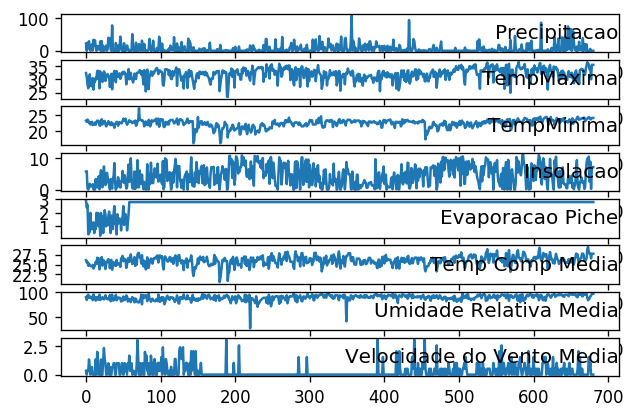

../data_in/AC_RioBranco.csv


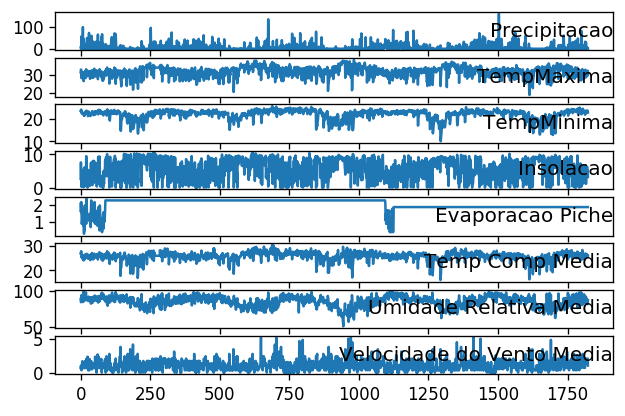

../data_in/AC_Tarauaca.csv


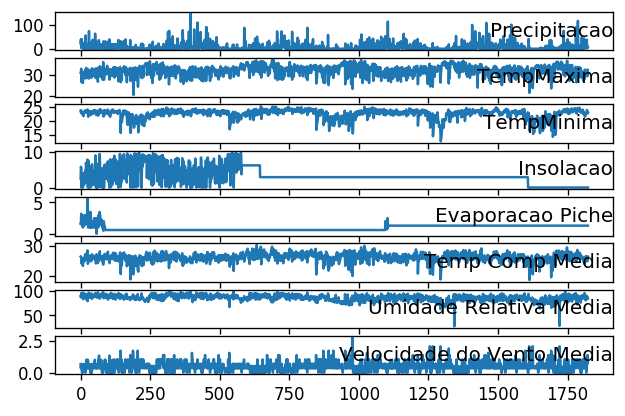

../data_in/AL_AguaBranca.csv


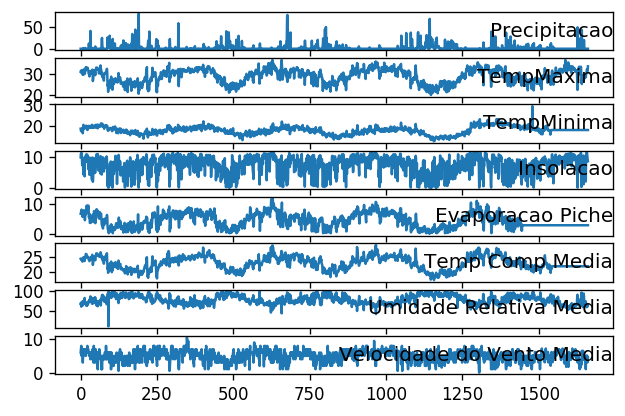

../data_in/AL_Maceio.csv


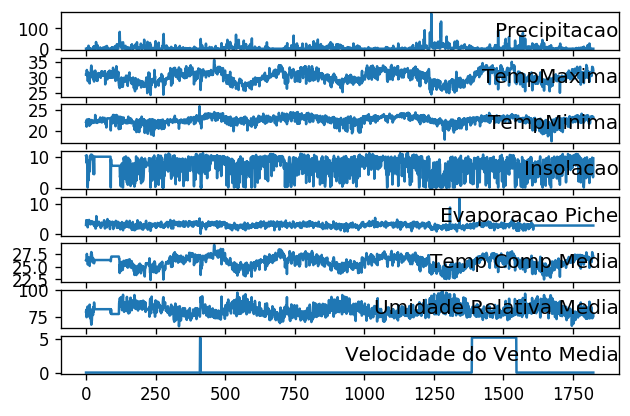

../data_in/AL_PalmeiraDosIndios.csv


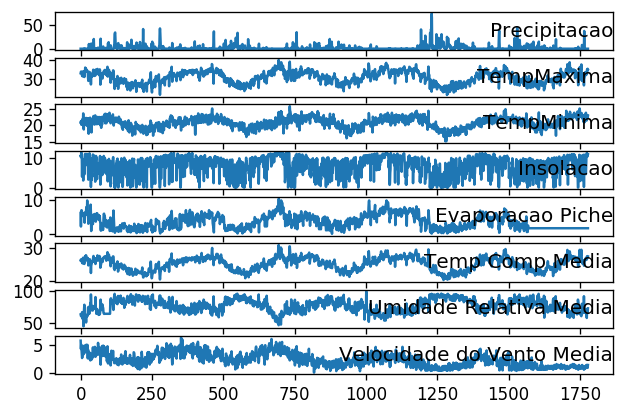

../data_in/AL_PaoDeAcucar.csv


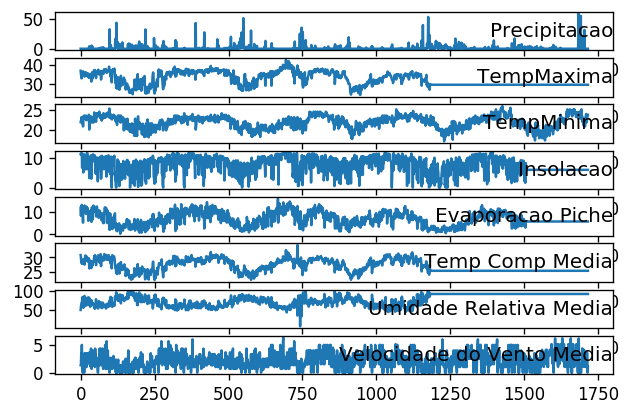

../data_in/AL_PortoDePedras.csv


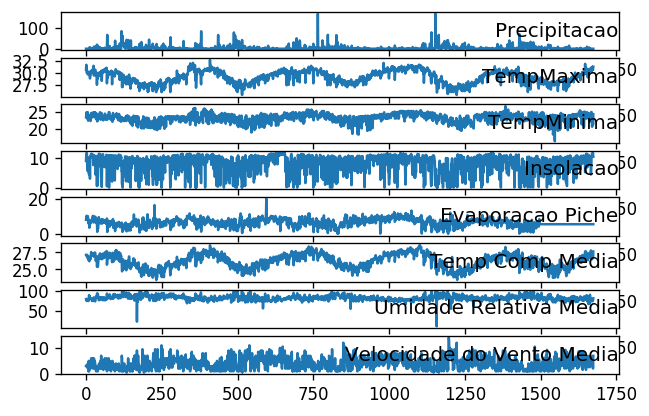

../data_in/AM_Barcelos.csv


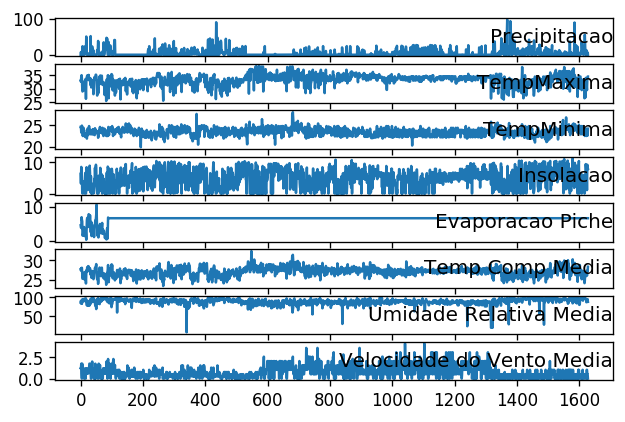

../data_in/AM_Benjamin_Costant.csv


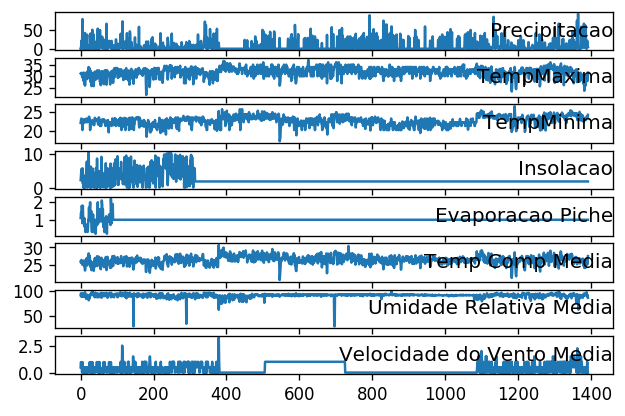

../data_in/AM_Coari.csv


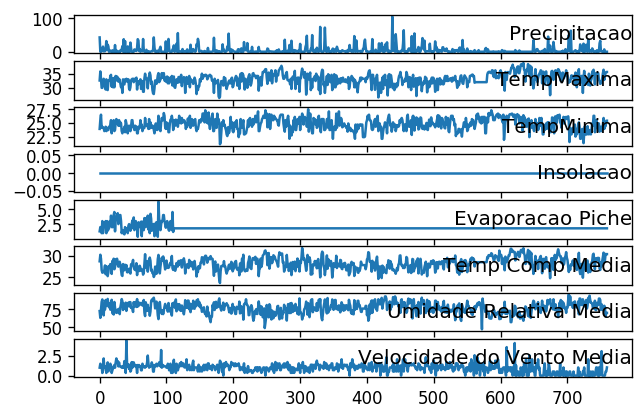

../data_in/AM_Codajas.csv


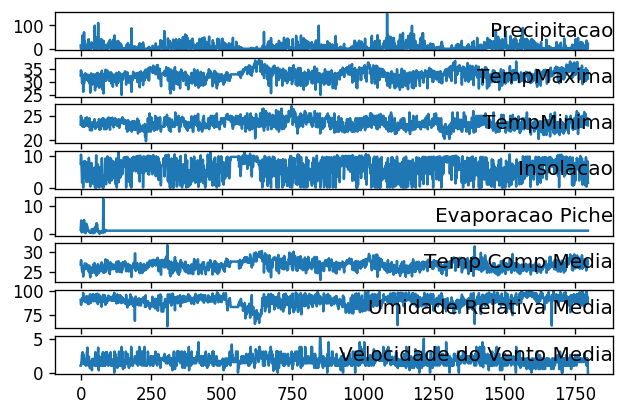

../data_in/AM_Eirunepe.csv


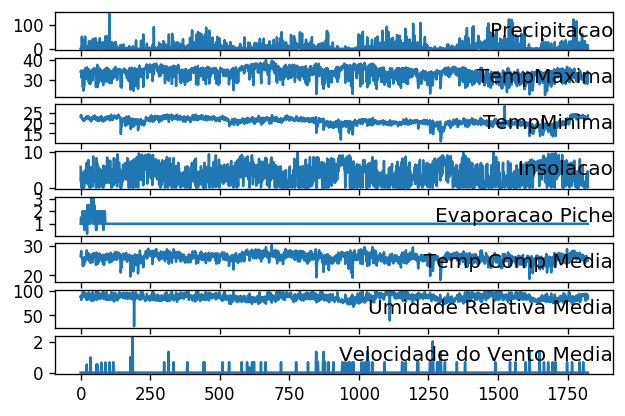

../data_in/AM_Fonte_Boa.csv


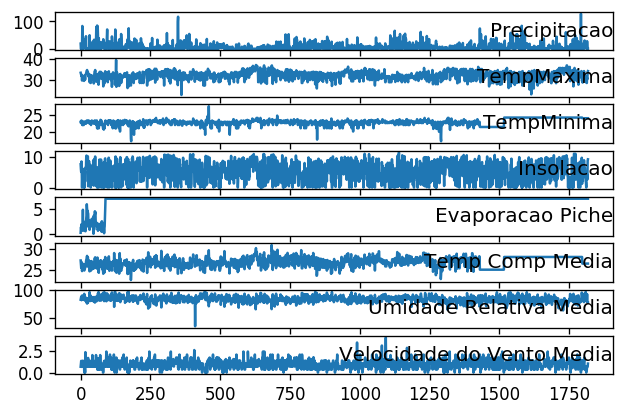

../data_in/AM_Iauarete.csv


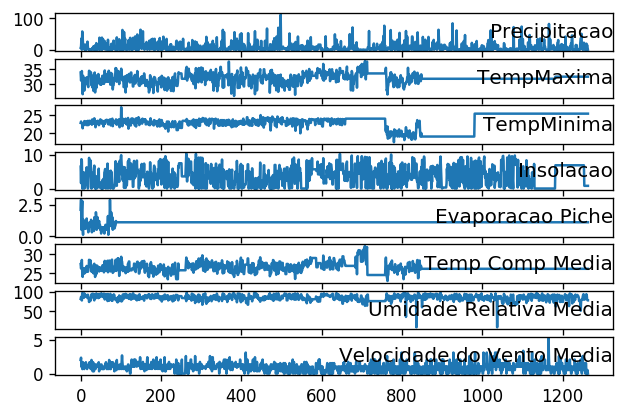

../data_in/AM_Itacoatiara.csv


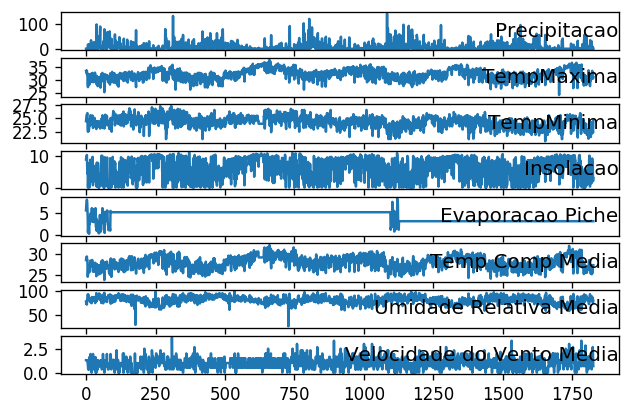

../data_in/AM_Labrea.csv


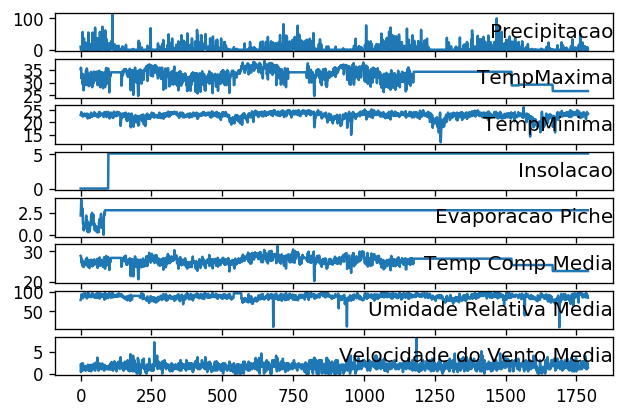

../data_in/AM_Manaus.csv


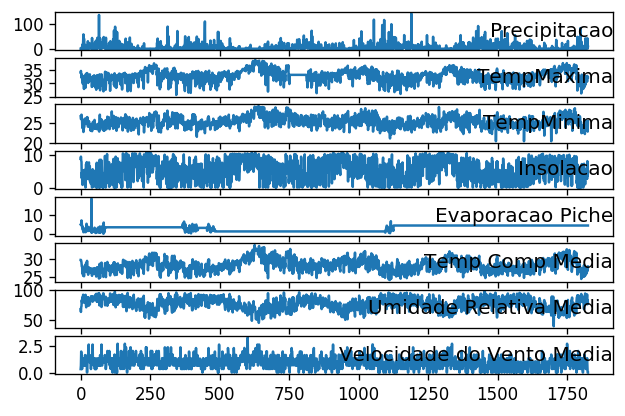

../data_in/AM_Manicore.csv


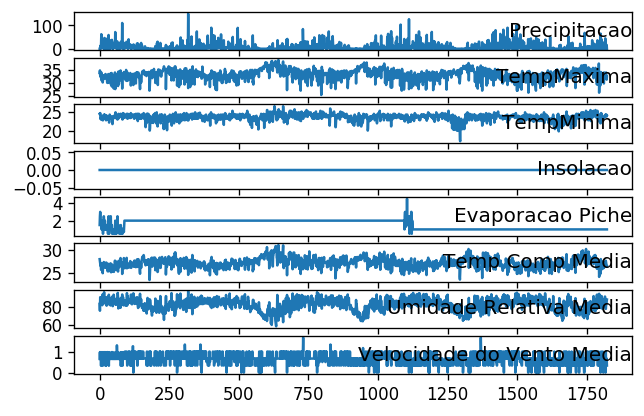

../data_in/AM_Parintins.csv


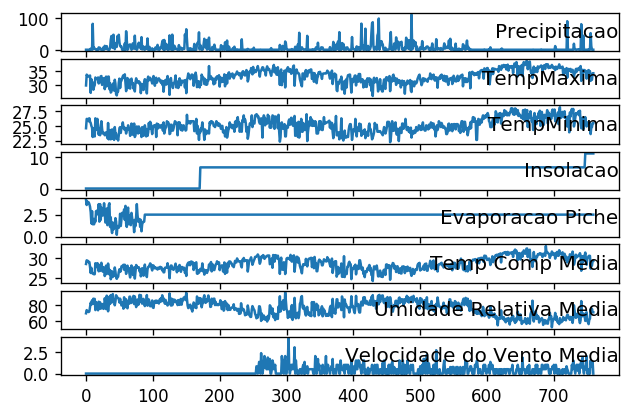

../data_in/AM_SGDaCachoeiraUaupes.csv


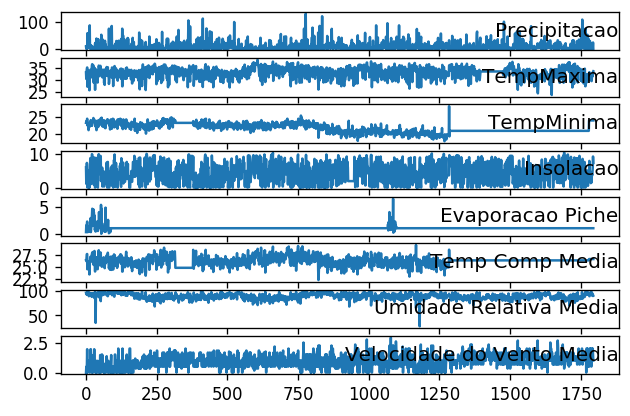

../data_in/AM_Tefe.csv


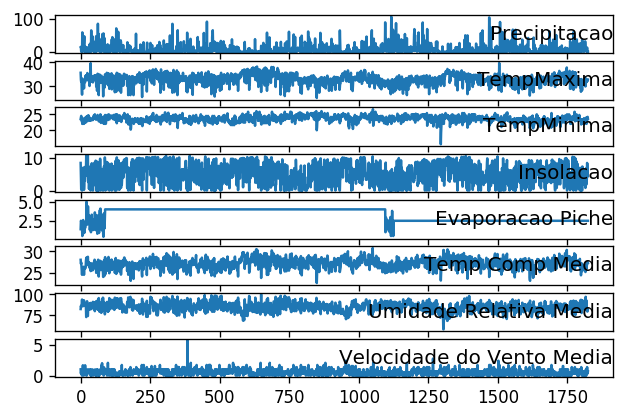

../data_in/AP_Macapa.csv


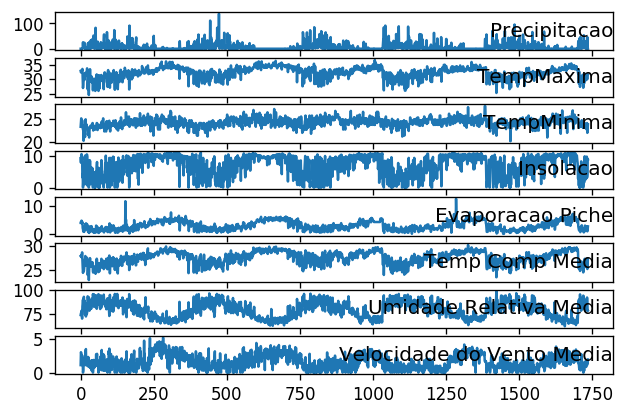

../data_in/BA_Alagoinhas.csv


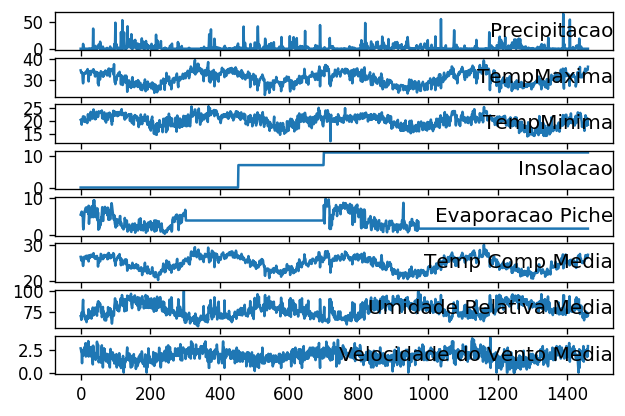

../data_in/BA_Barra.csv


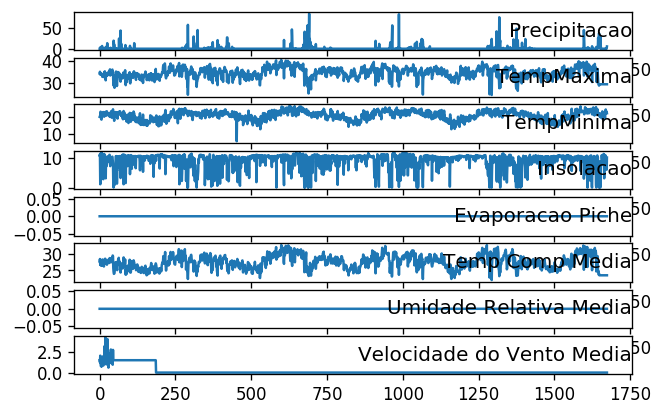

../data_in/BA_Barreiras.csv


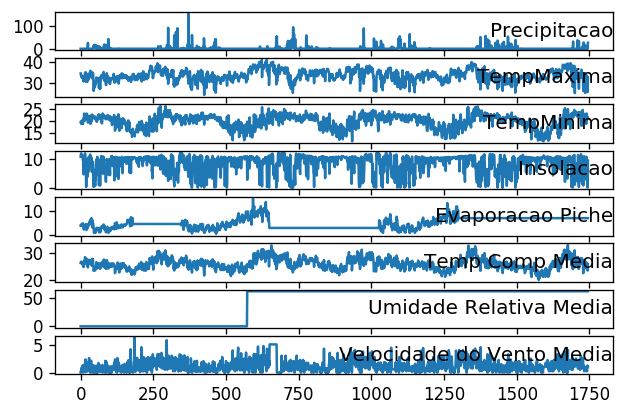

../data_in/BA_BomJesusDaLapa.csv


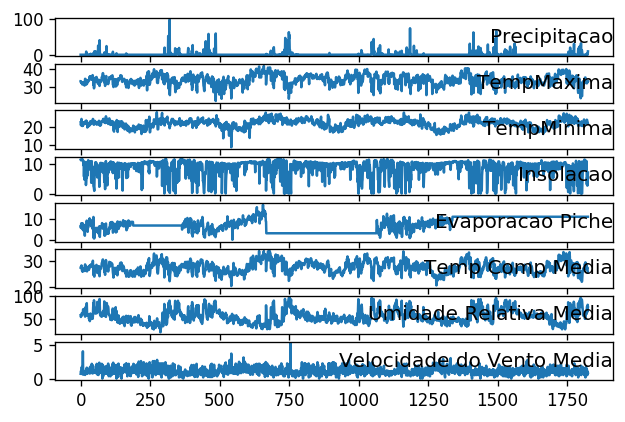

../data_in/BA_Caetite.csv


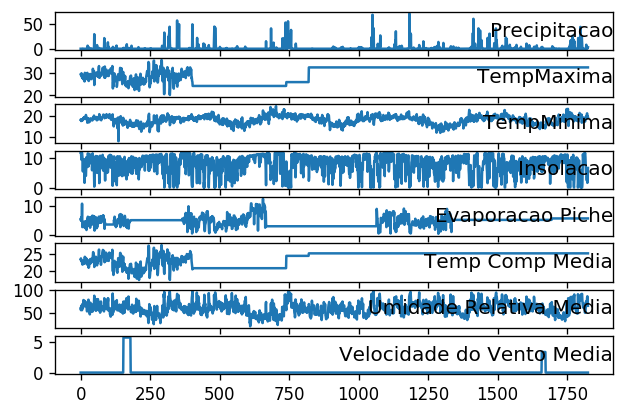

../data_in/BA_Canavieiras.csv


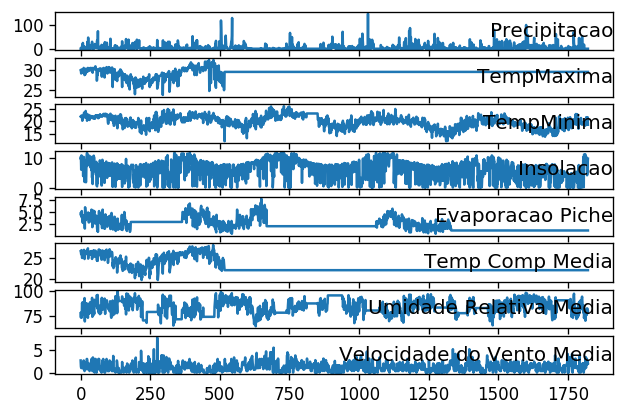

../data_in/BA_Caravelas.csv


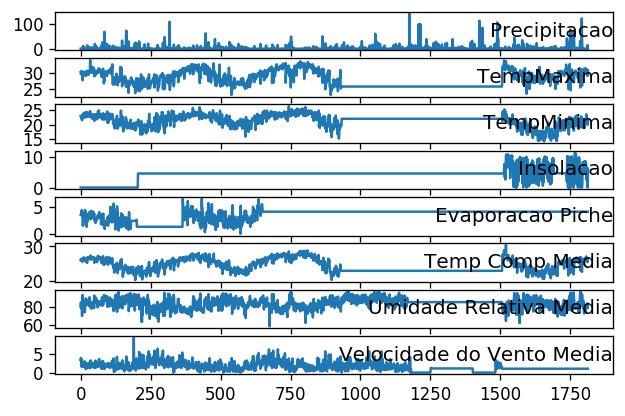

../data_in/BA_Carinhanha.csv


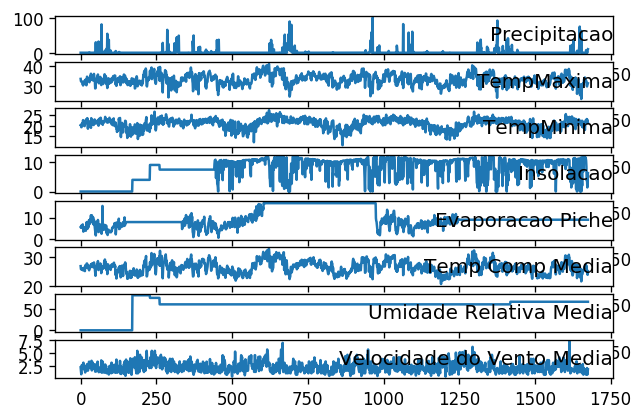

../data_in/BA_Cipo.csv


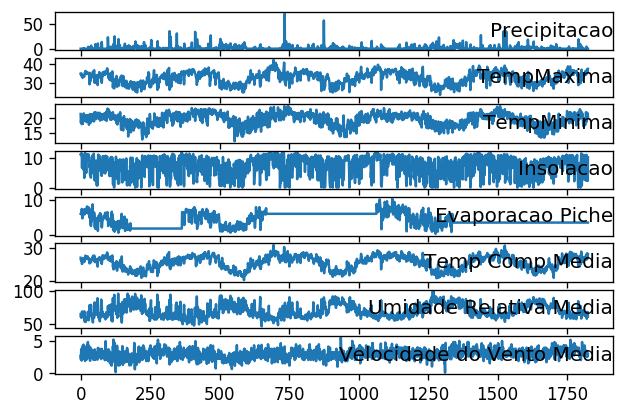

../data_in/BA_Correntina.csv


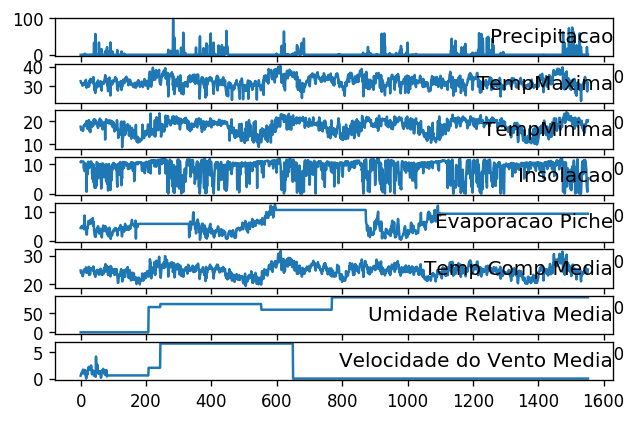

../data_in/BA_CruzDasAlmas.csv


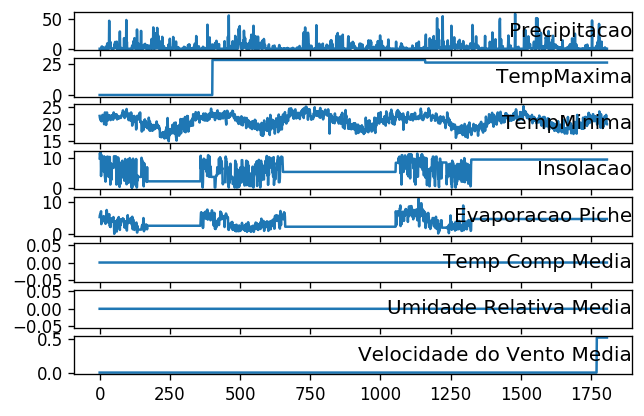

../data_in/BA_FeiraDeSantana.csv


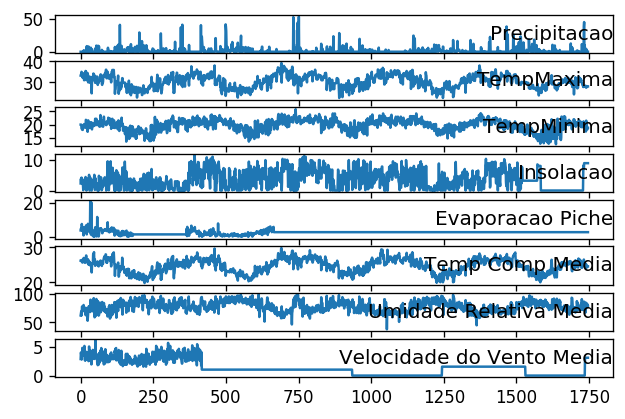

../data_in/BA_Guaratinga.csv


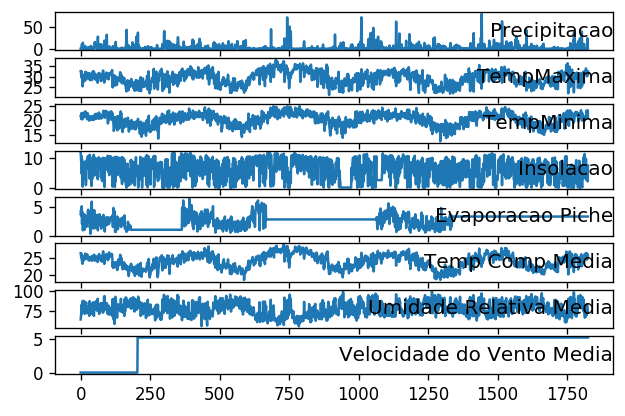

../data_in/BA_Irece.csv


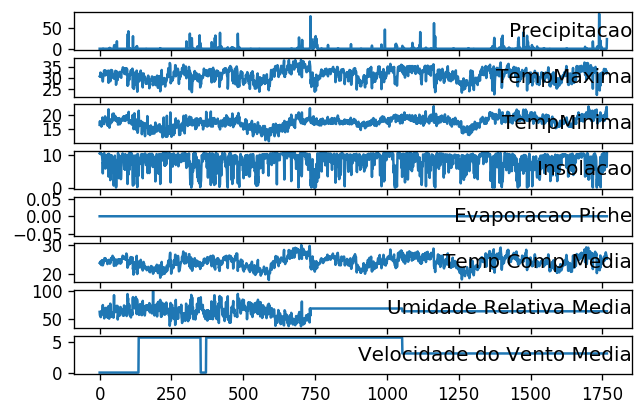

../data_in/BA_Itaberaba.csv


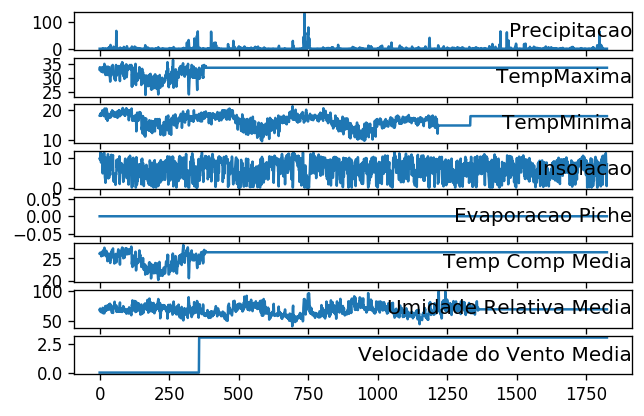

../data_in/BA_ItirucuJaguaquara.csv


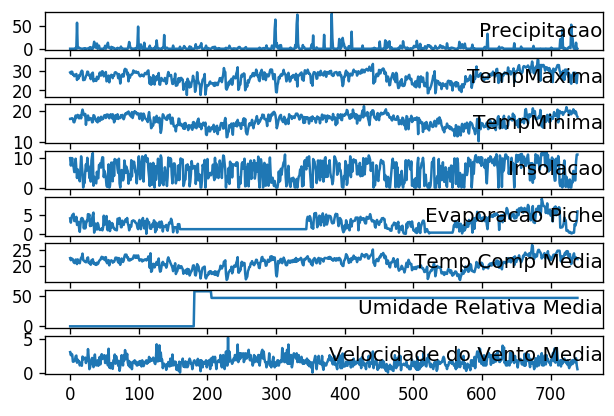

../data_in/BA_Ituacu.csv


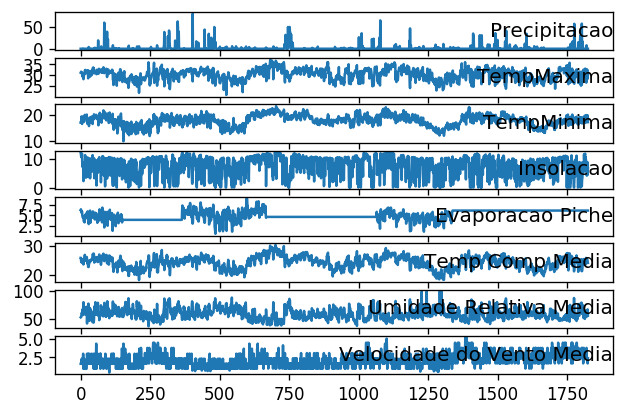

../data_in/BA_Jacobina.csv


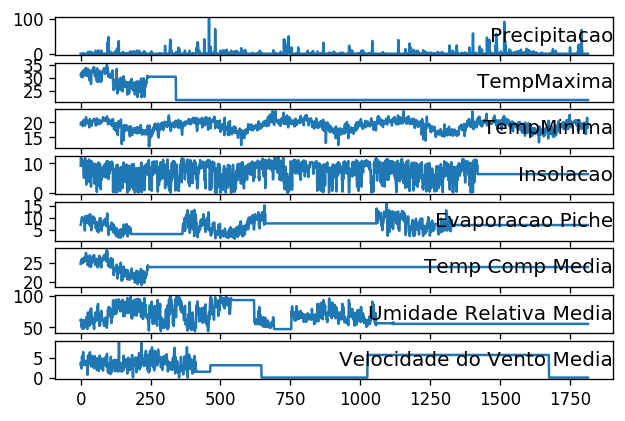

../data_in/BA_Lencois.csv


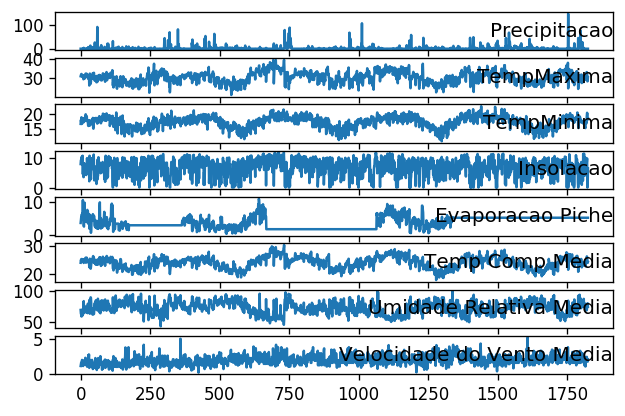

../data_in/BA_MonteSanto.csv


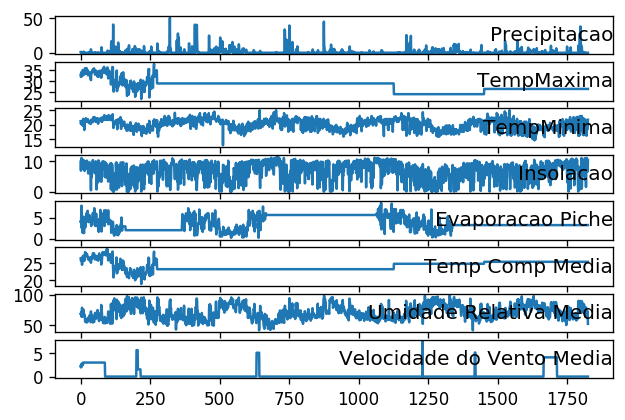

../data_in/BA_MorroDoChapeu.csv


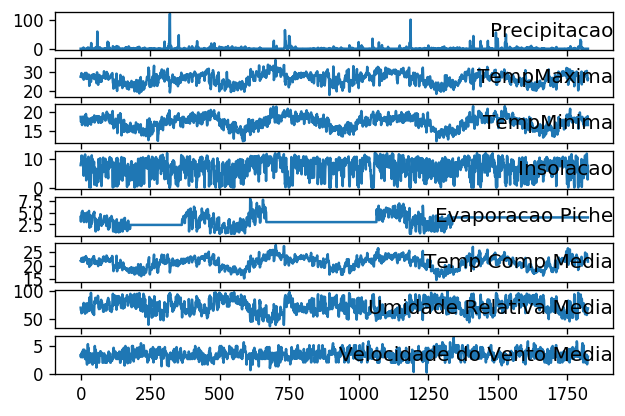

../data_in/BA_PauloAfonso.csv


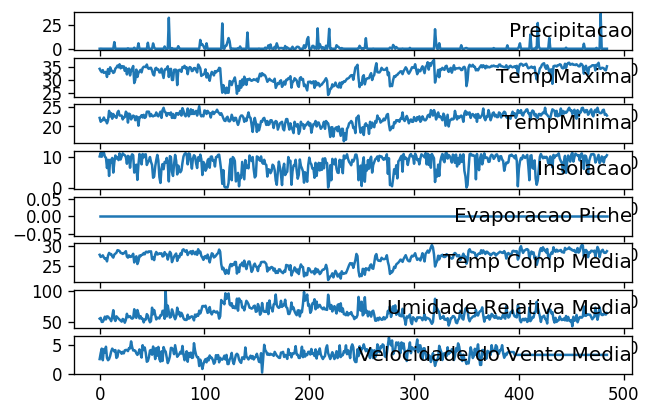

../data_in/BA_Remanso.csv


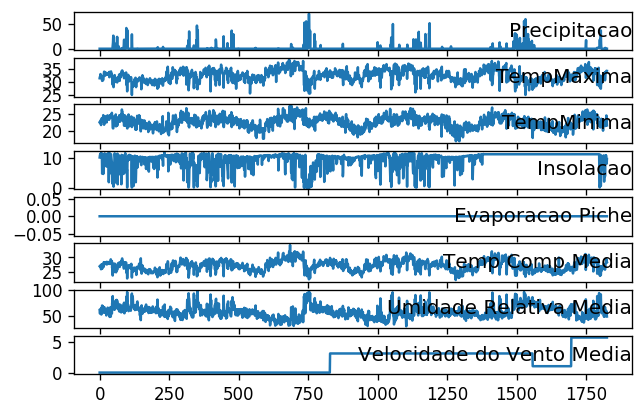

../data_in/BA_SalvadorOndina.csv


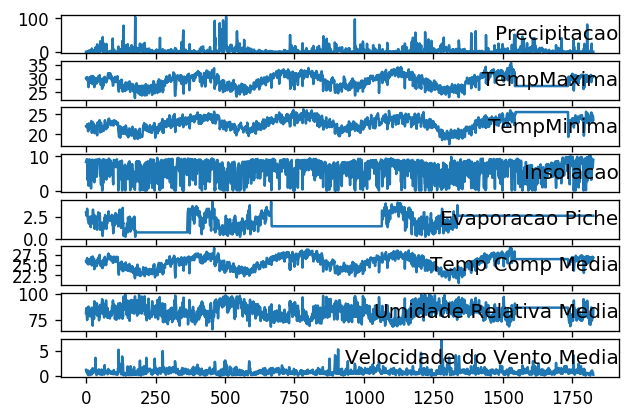

../data_in/BA_Serrinha.csv


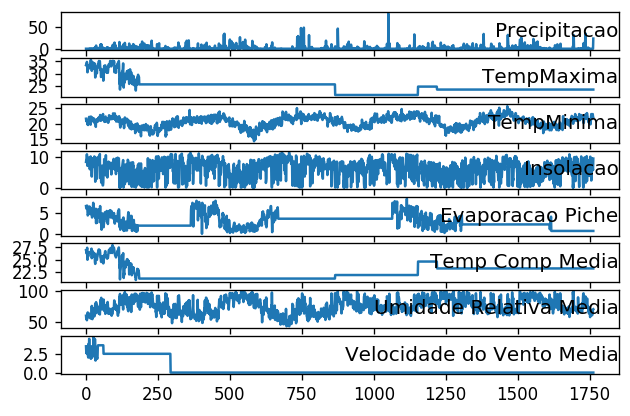

../data_in/BA_StaRDCassiaIbipetuba.csv


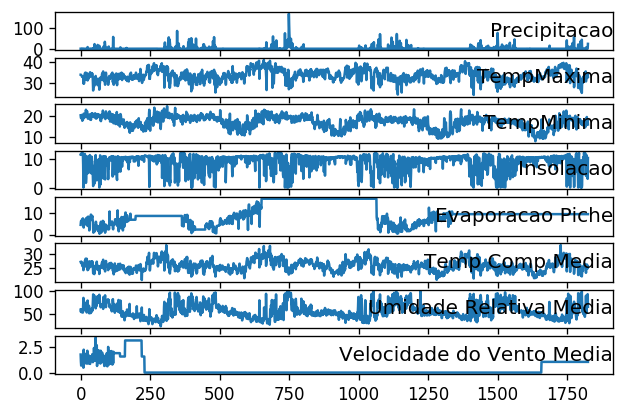

../data_in/BA_VitoriaDaConquista.csv


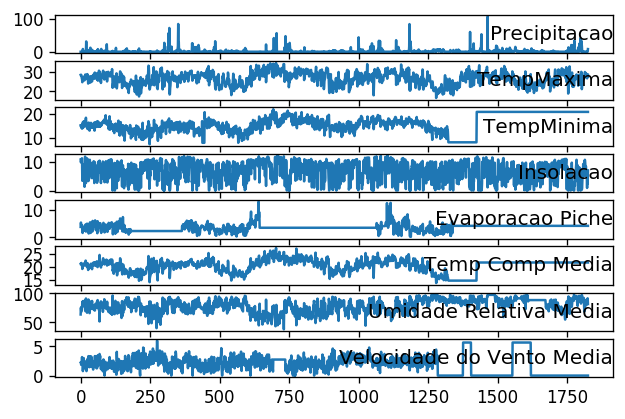

../data_in/CE_Barbalha.csv


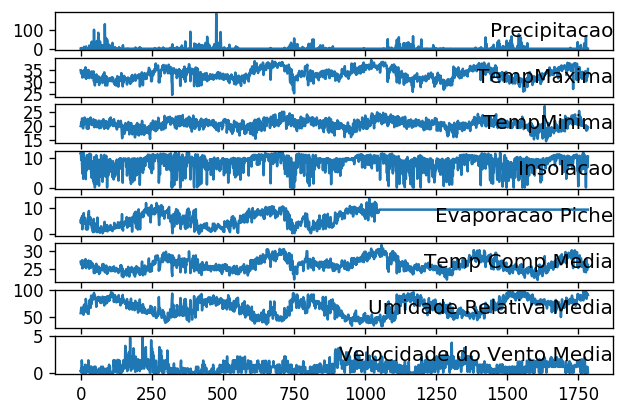

../data_in/CE_CamposSales.csv


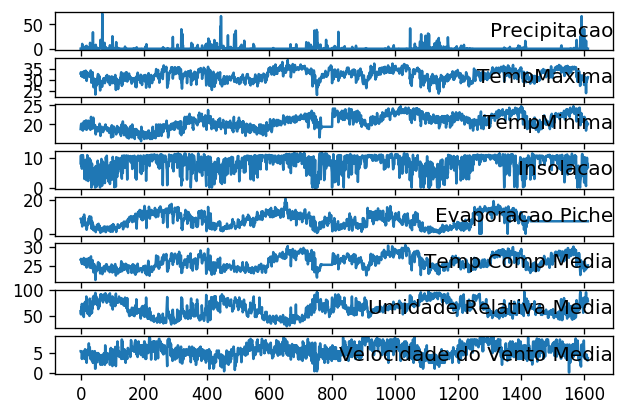

../data_in/CE_Crateus.csv


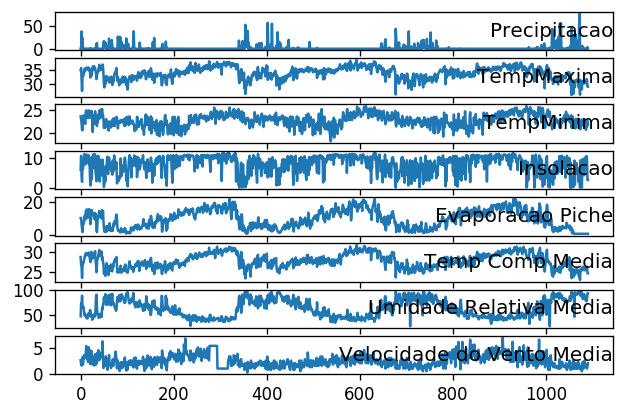

../data_in/CE_Fortaleza.csv


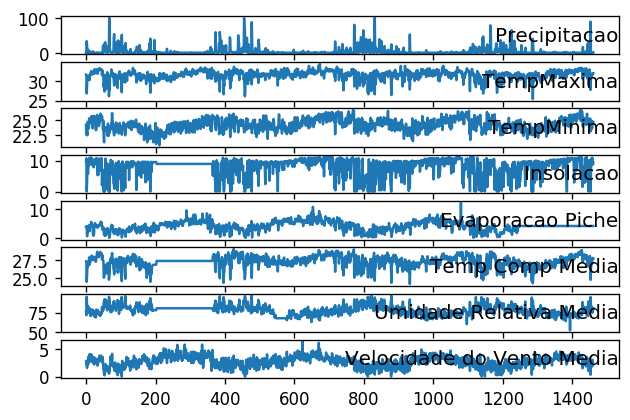

../data_in/CE_Guaramiranga.csv


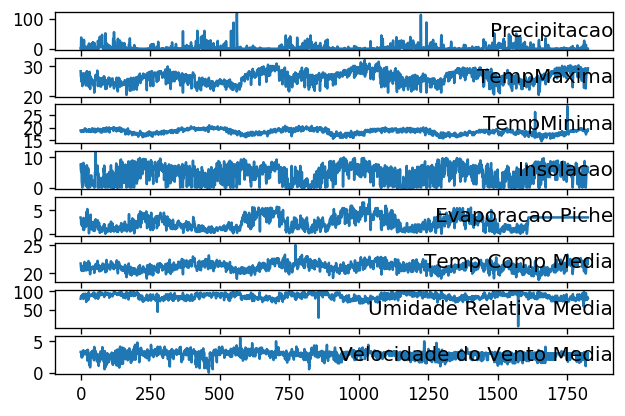

../data_in/CE_Iguatu.csv


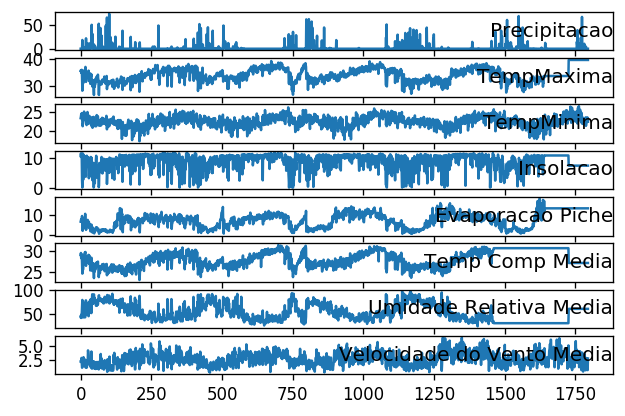

../data_in/CE_Jaguaruana.csv


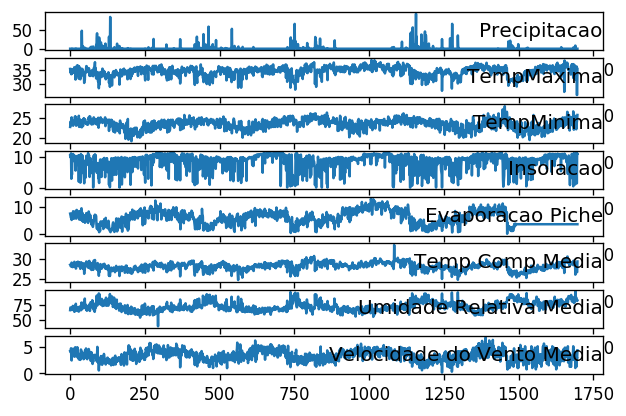

../data_in/CE_MoradaNova.csv


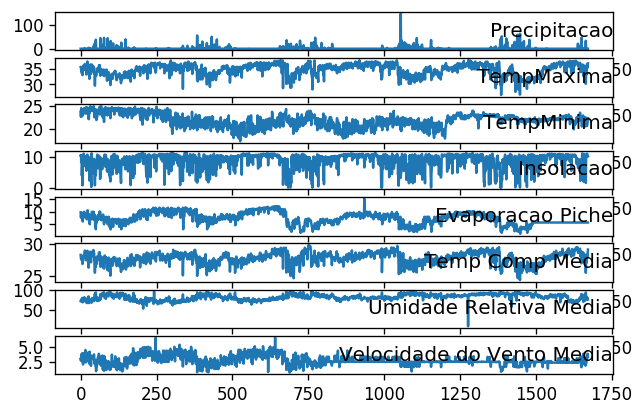

../data_in/CE_Quixaramobim.csv


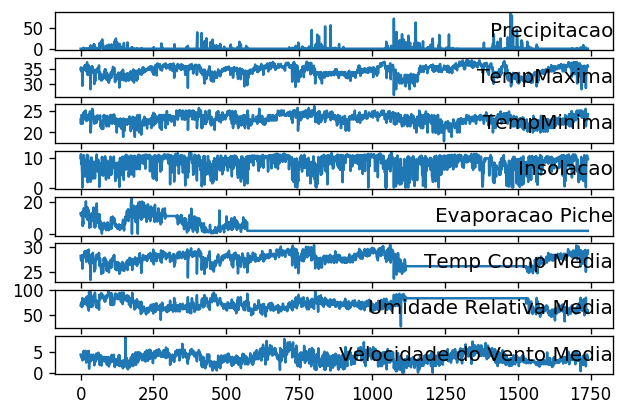

../data_in/CE_Sobral.csv


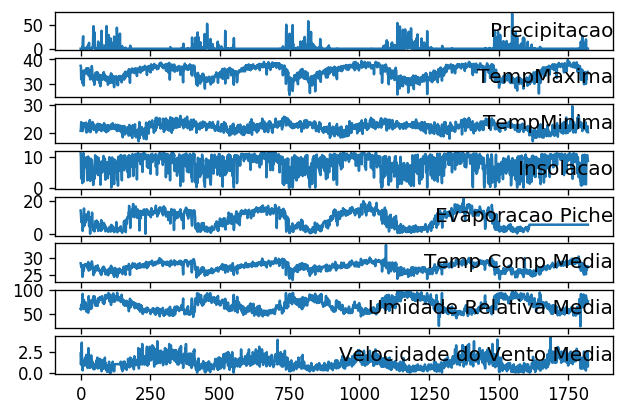

../data_in/CE_Taua.csv


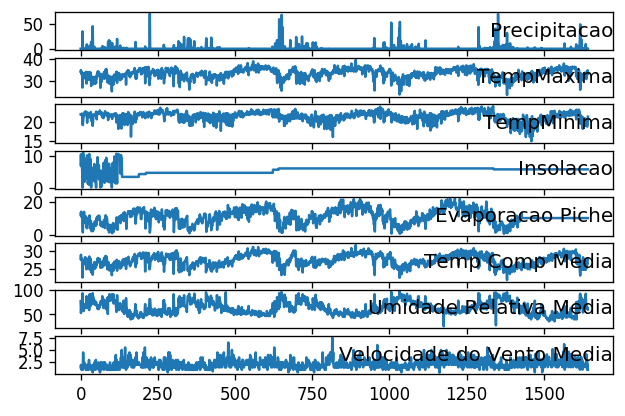

../data_in/DF_Brasilia.csv


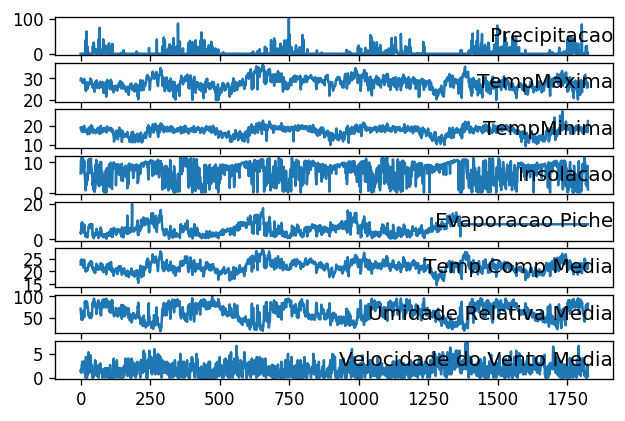

../data_in/DF_Roncador.csv


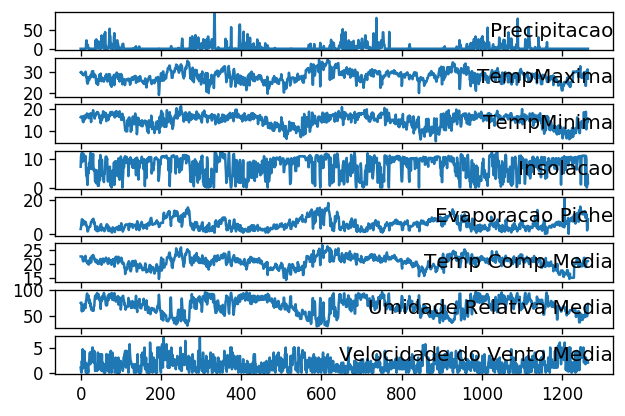

../data_in/ES_SaoMateus.csv


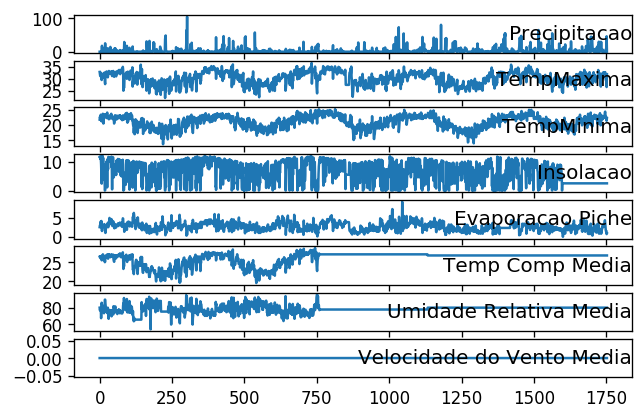

../data_in/ES_Vitoria.csv


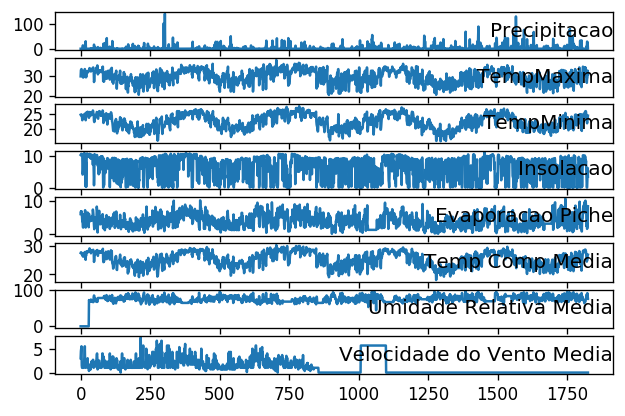

../data_in/GO_Aragarcas.csv


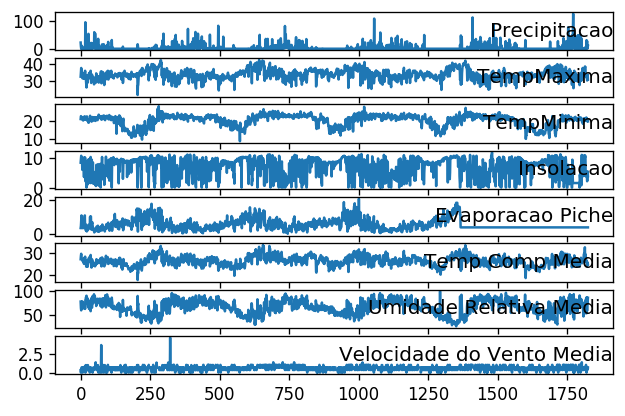

../data_in/GO_Catalao.csv


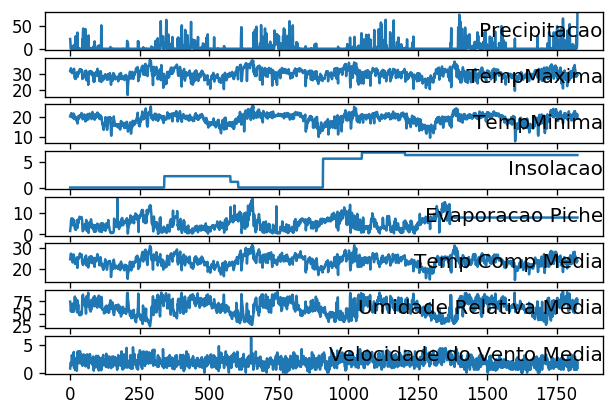

../data_in/GO_Formosa.csv


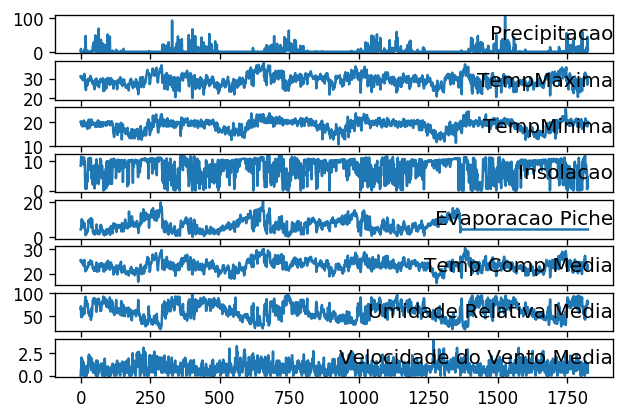

../data_in/GO_Goiania.csv


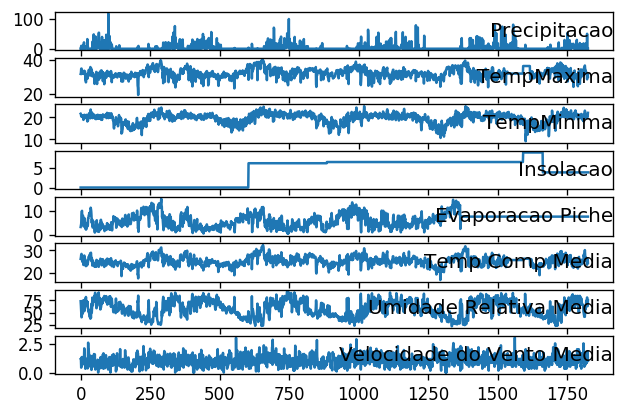

../data_in/GO_Goias.csv


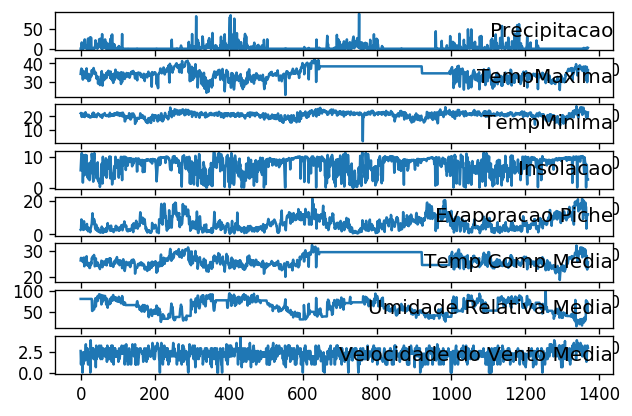

../data_in/GO_Ipameri.csv


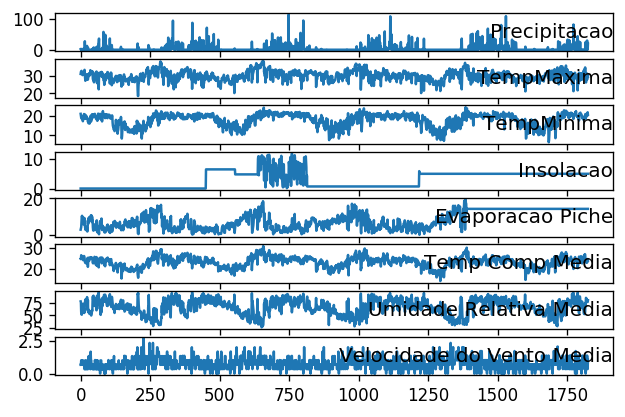

../data_in/GO_Jatai.csv


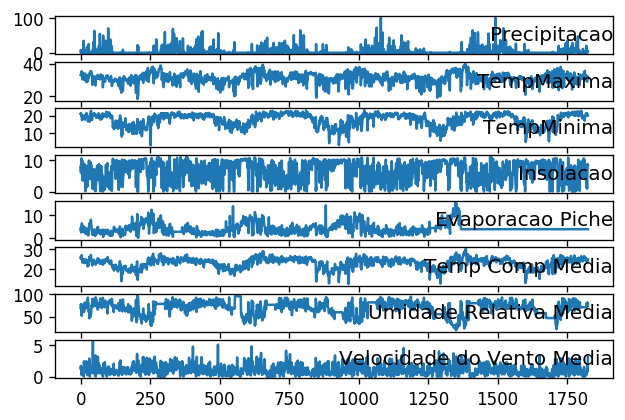

../data_in/GO_Pirenopolis.csv


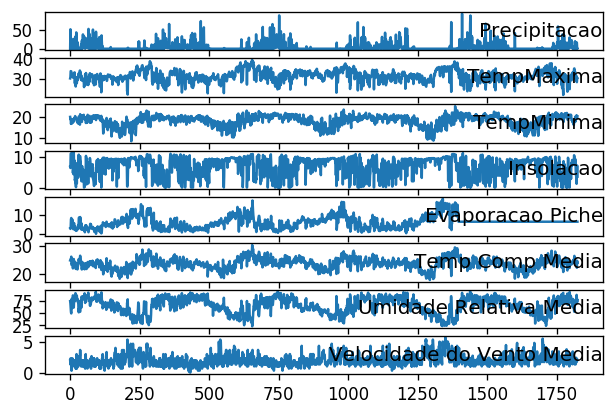

../data_in/GO_Posse.csv


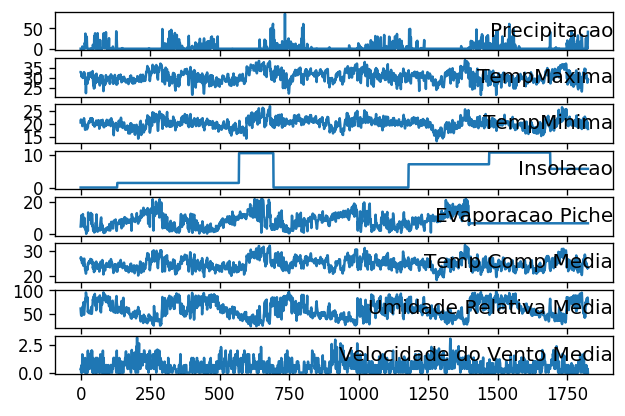

../data_in/GO_RioVerde.csv


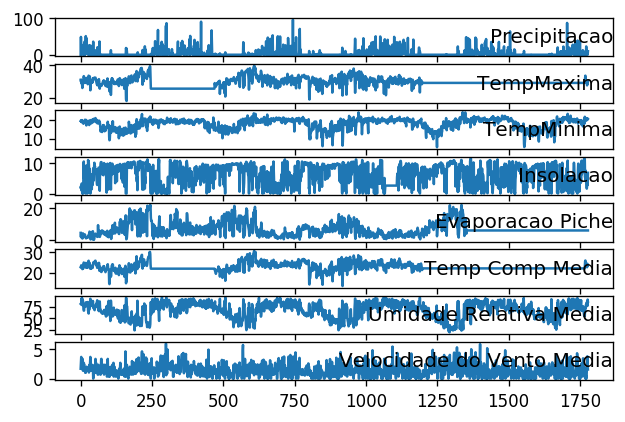

../data_in/MA_AltoParnaiba.csv


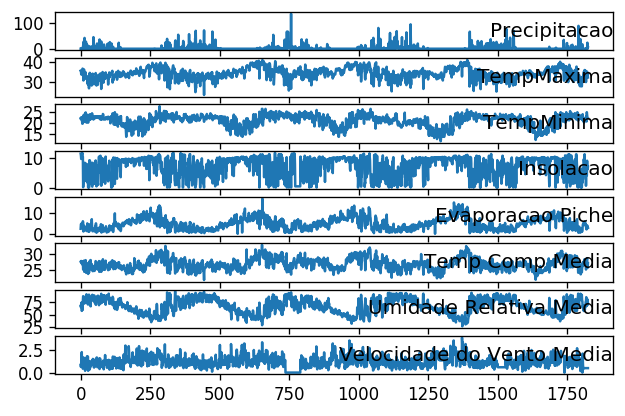

../data_in/MA_Bacabal.csv


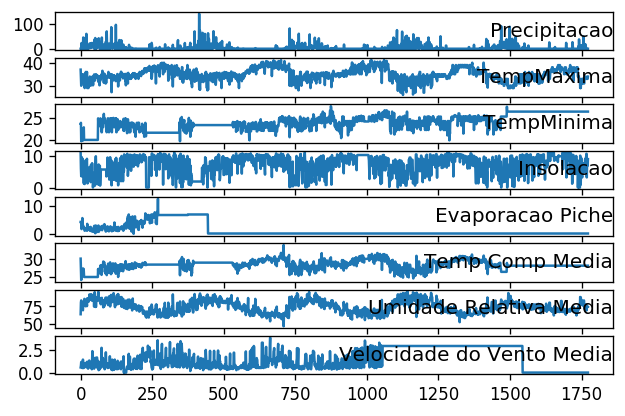

../data_in/MA_Balsas.csv


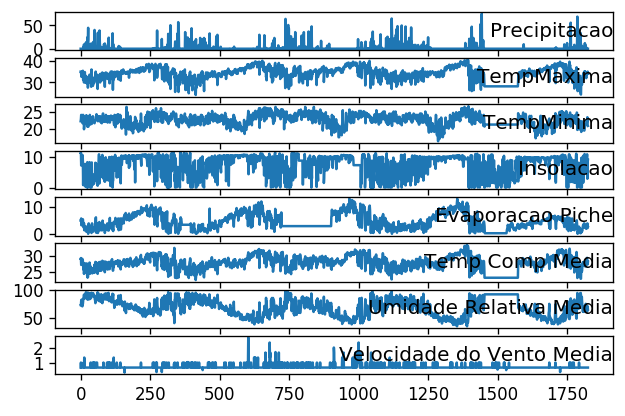

../data_in/MA_BarraDoCorda.csv


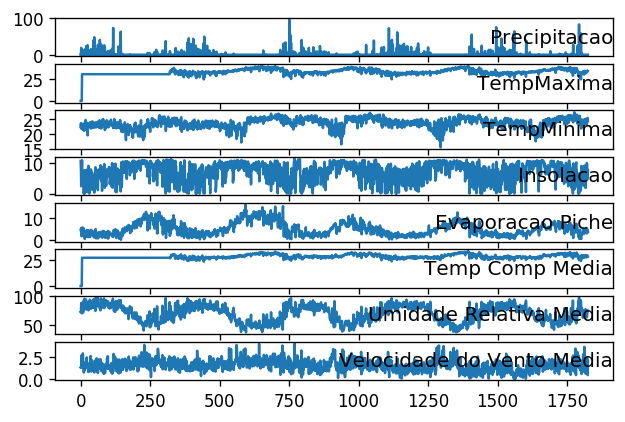

../data_in/MA_Carolina.csv


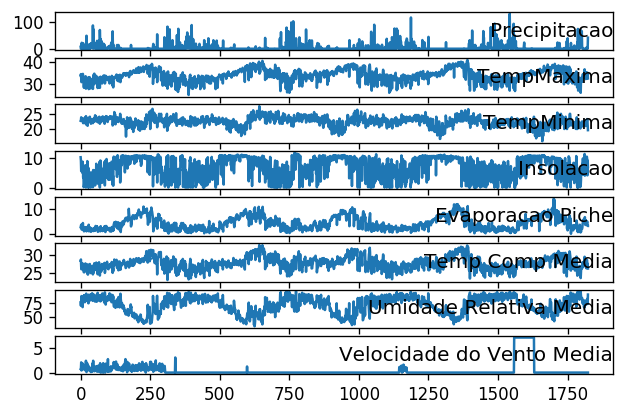

../data_in/MA_Caxias.csv


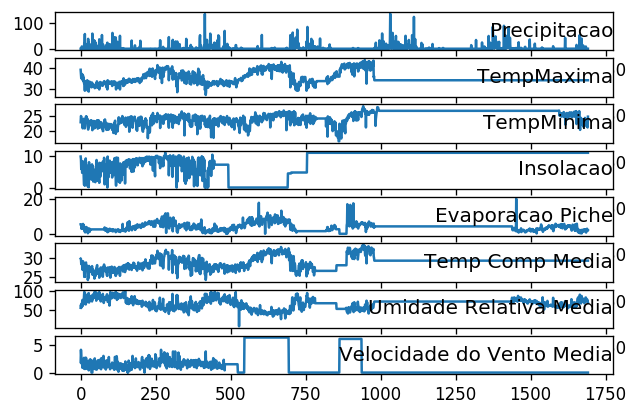

../data_in/MA_Chapadinha.csv


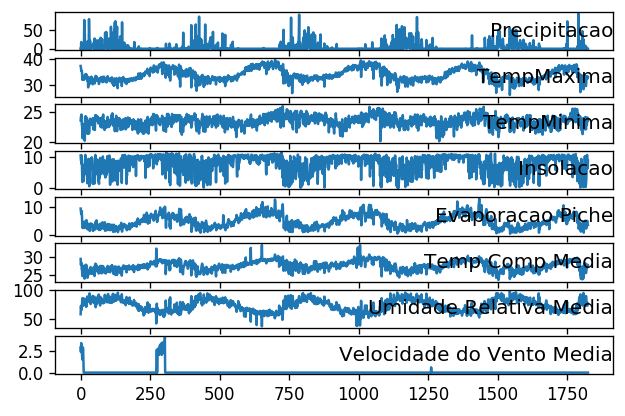

../data_in/MA_Colinas.csv


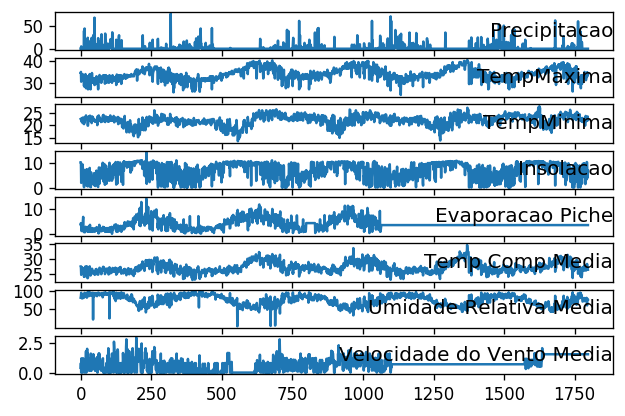

../data_in/MA_Imperatriz.csv


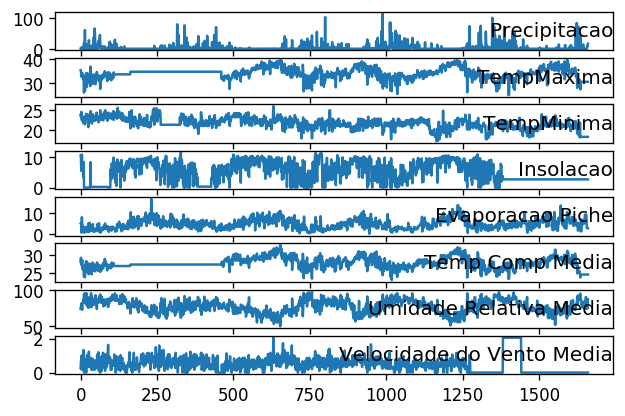

../data_in/MA_SaoLuis.csv


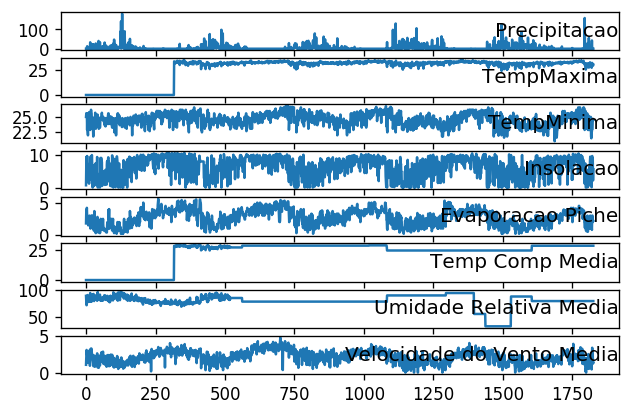

../data_in/MA_Turiacu.csv


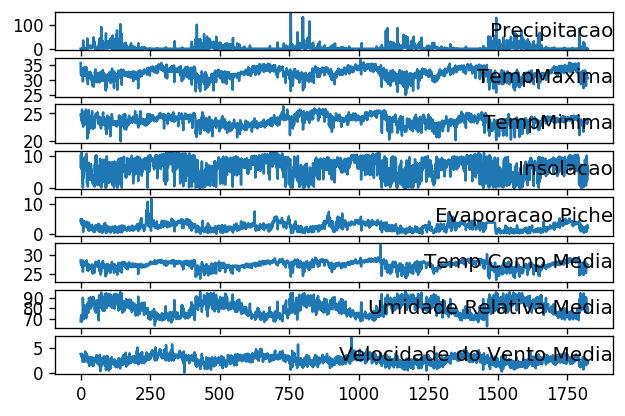

../data_in/MA_ZeDoca.csv


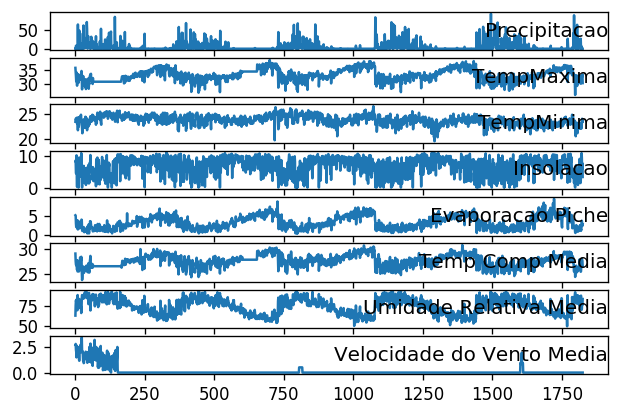

../data_in/MG_Aimores.csv


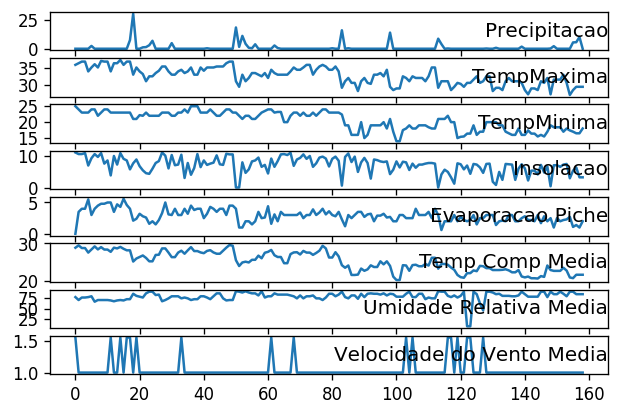

../data_in/MG_Aracuai.csv


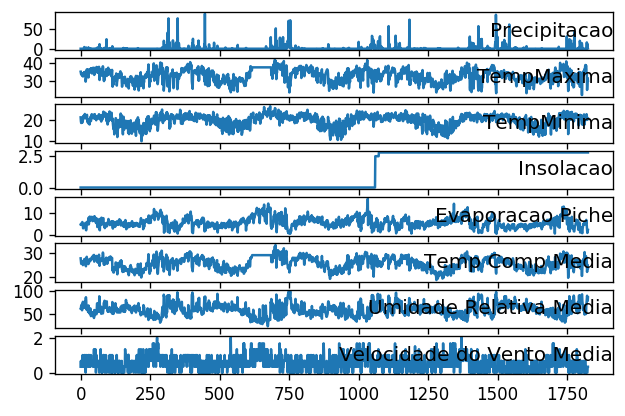

../data_in/MG_Araxa.csv


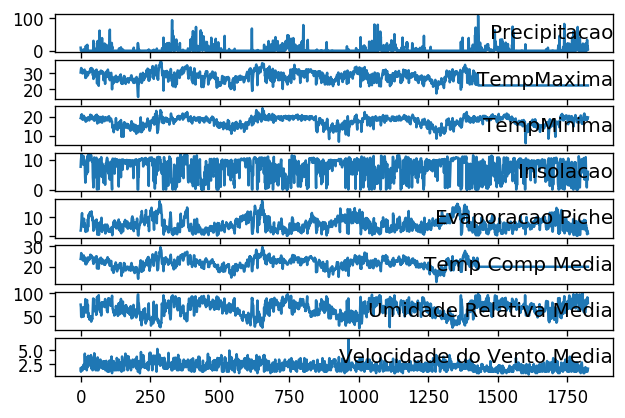

../data_in/MG_Arinos.csv


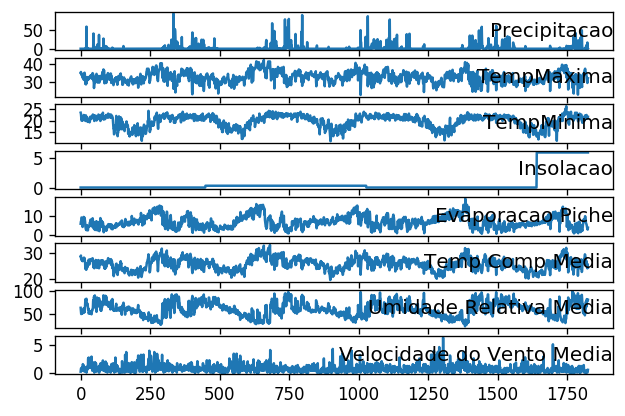

../data_in/MG_Bambui.csv


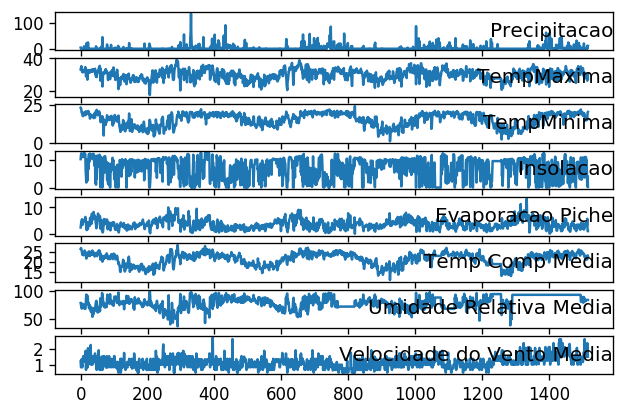

../data_in/MG_Barbacena.csv


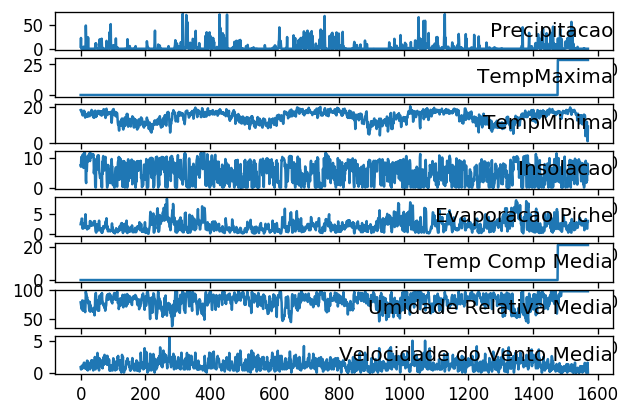

../data_in/MG_BeloHorizonte.csv


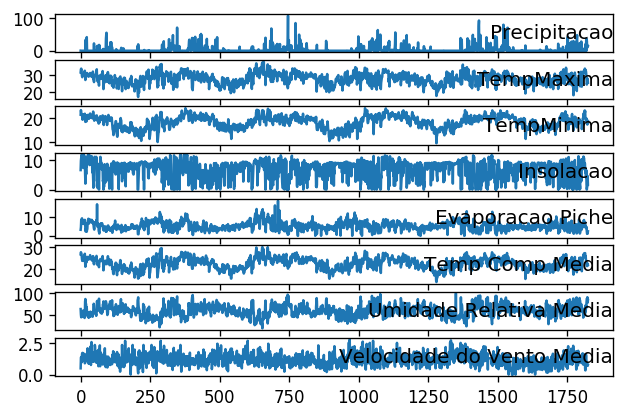

../data_in/MG_BomDespacho.csv


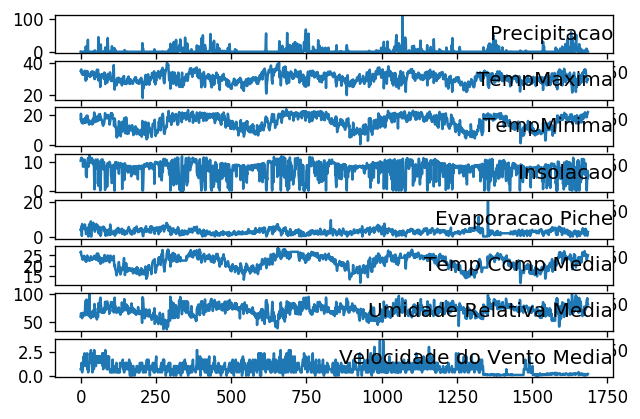

../data_in/MG_CDoMatoDentro.csv


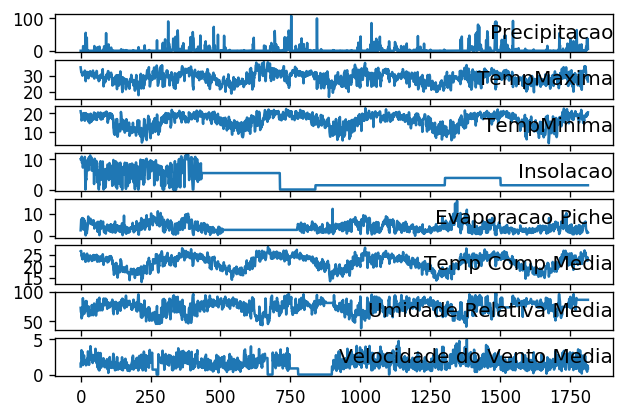

../data_in/MG_CaldasPDeCaldas.csv


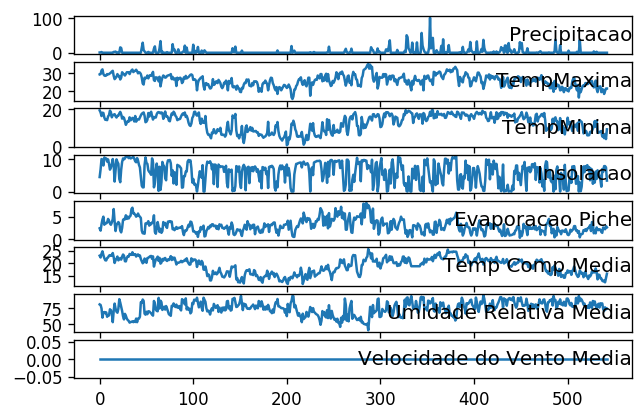

../data_in/MG_Caparao.csv


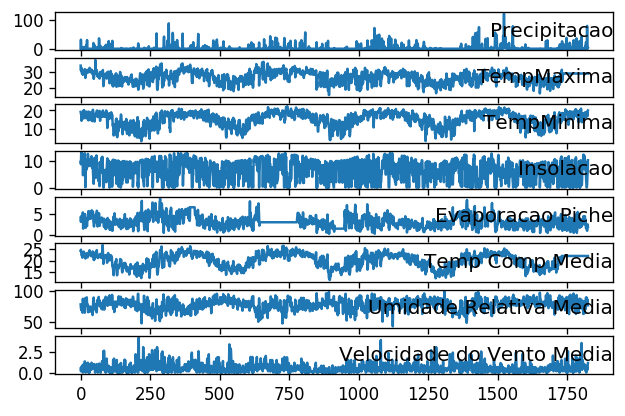

../data_in/MG_Capinopolis.csv


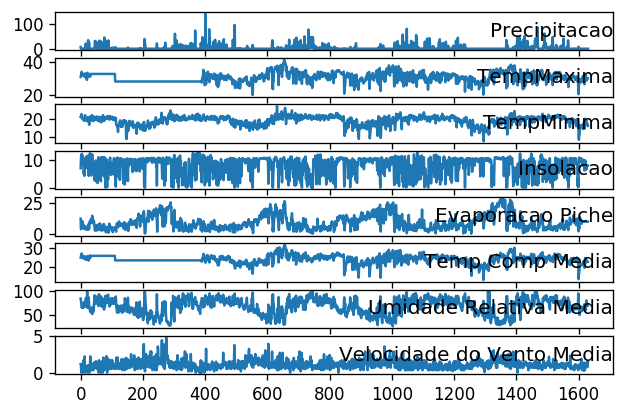

../data_in/MG_Caratinga.csv


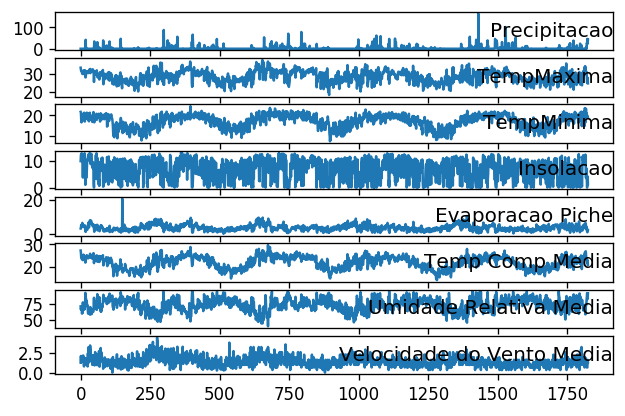

../data_in/MG_Carbonita.csv


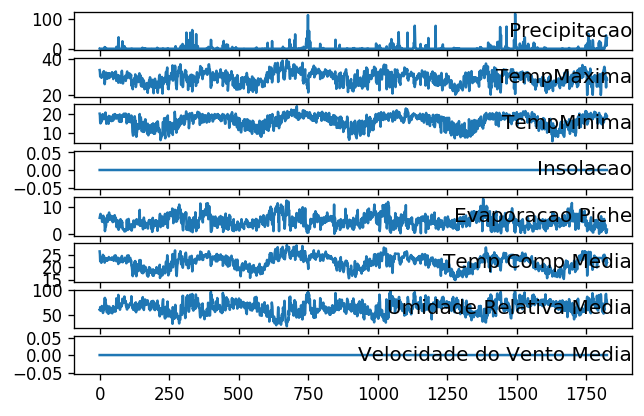

../data_in/MG_Curvelo.csv


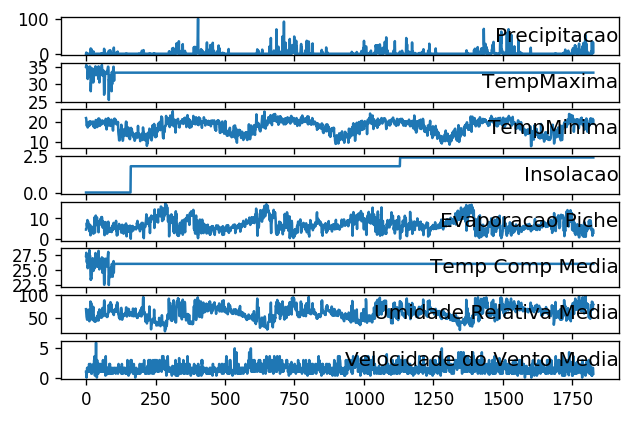

../data_in/MG_Diamantina.csv


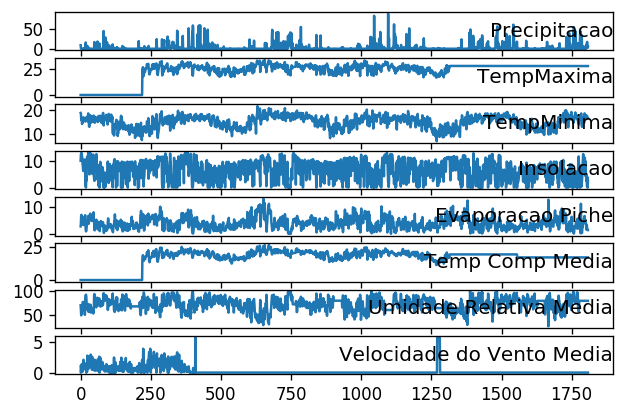

../data_in/MG_Divinopolis.csv


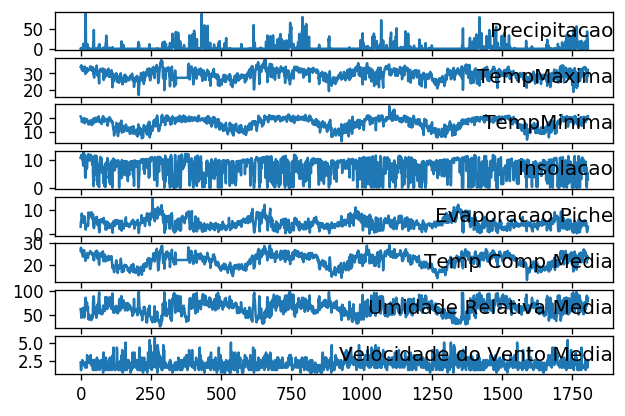

../data_in/MG_Espinosa.csv


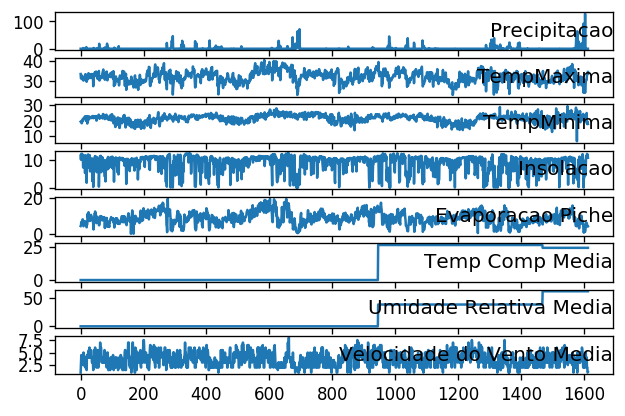

../data_in/MG_Florestal.csv


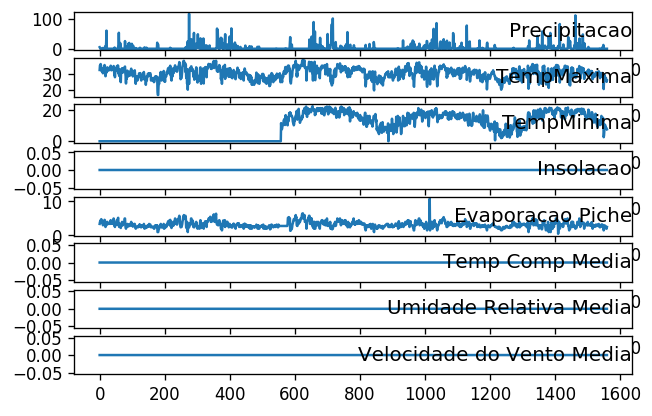

../data_in/MG_Formoso.csv


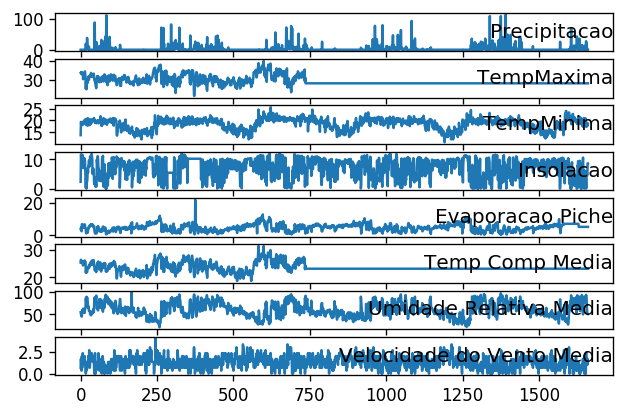

../data_in/MG_Ibirite.csv


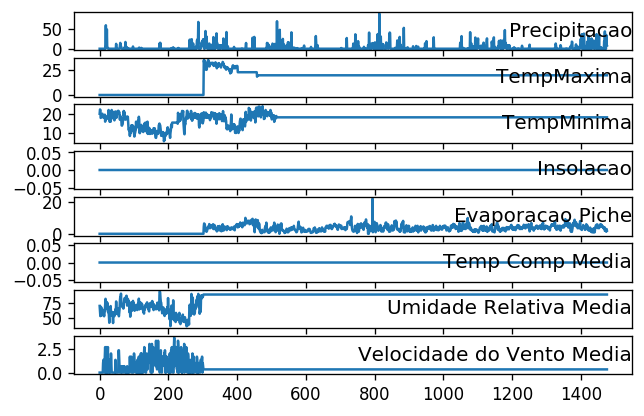

../data_in/MG_Itamarandiba.csv


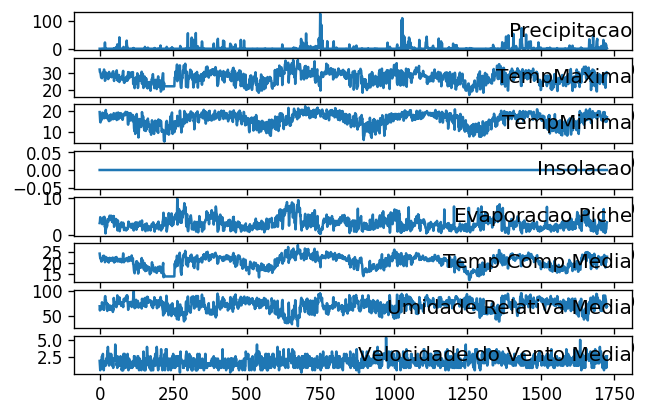

../data_in/MG_Ituiutaba.csv


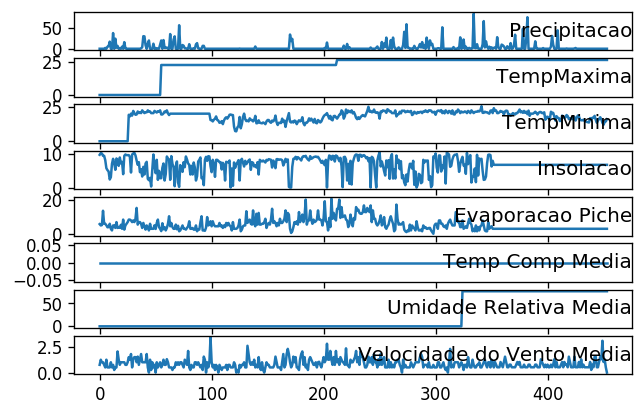

../data_in/MG_Janauba.csv


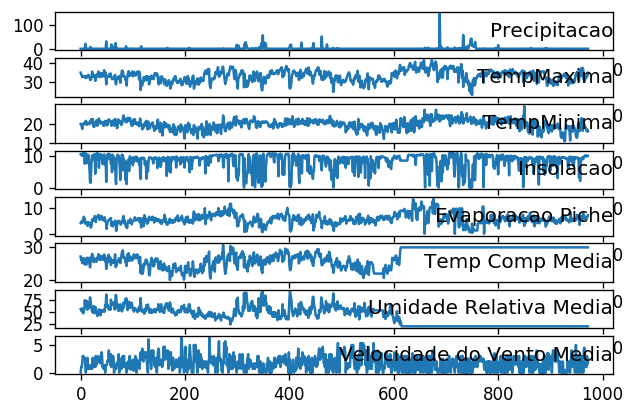

../data_in/MG_Januaria.csv


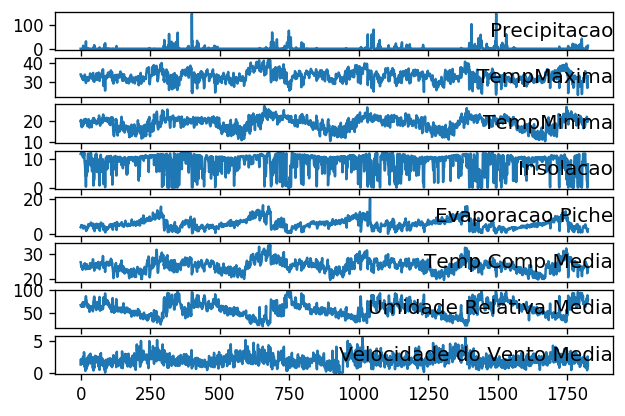

../data_in/MG_JoaoPinheiro.csv


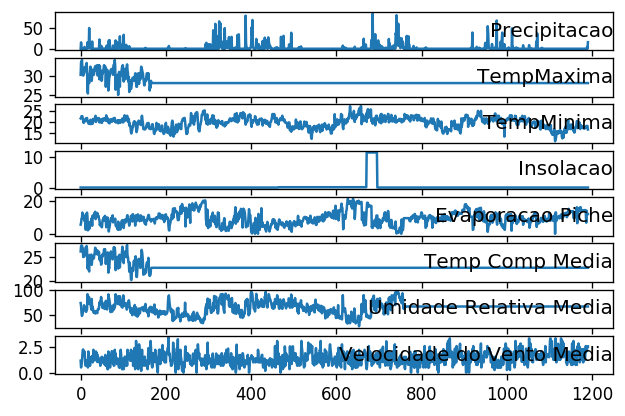

../data_in/MG_JuizDeFora.csv


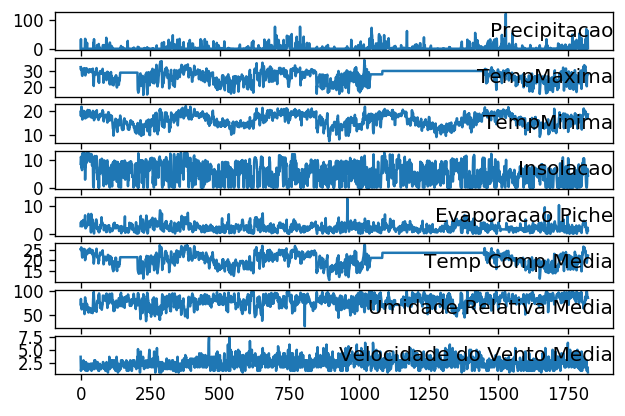

../data_in/MG_Juramento.csv


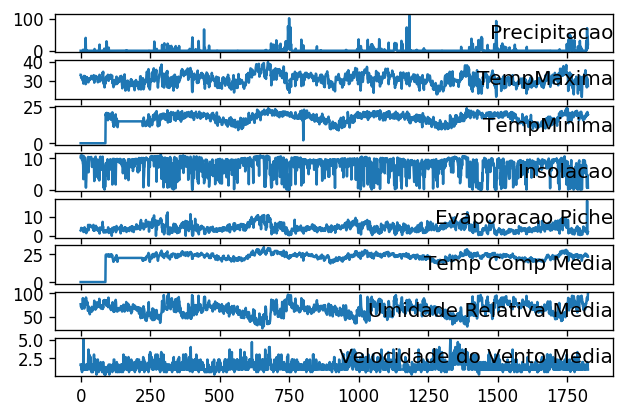

../data_in/MG_Lavras.csv


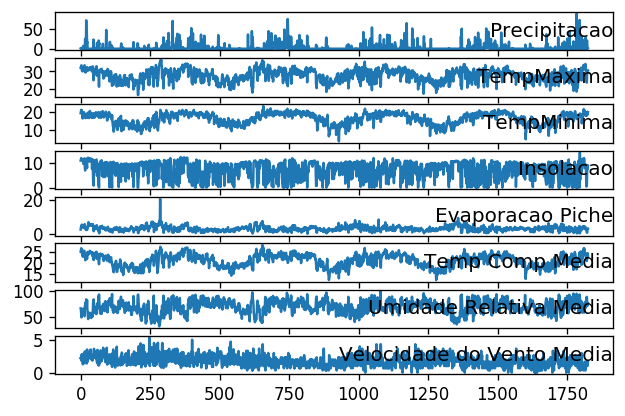

../data_in/MG_Machado.csv


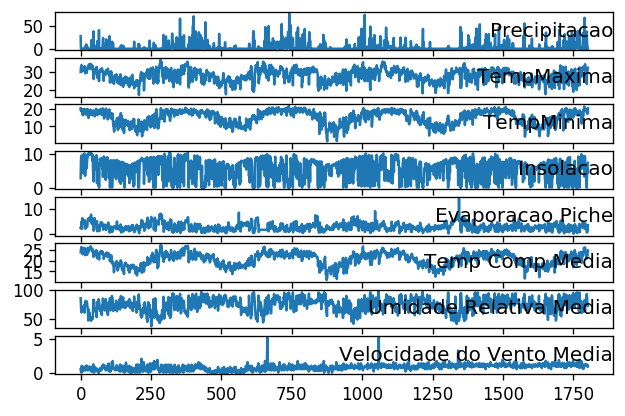

../data_in/MG_MonteAzul.csv


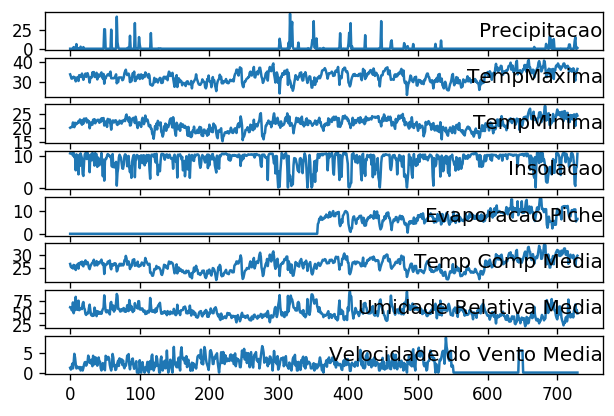

../data_in/MG_MontesClaros.csv


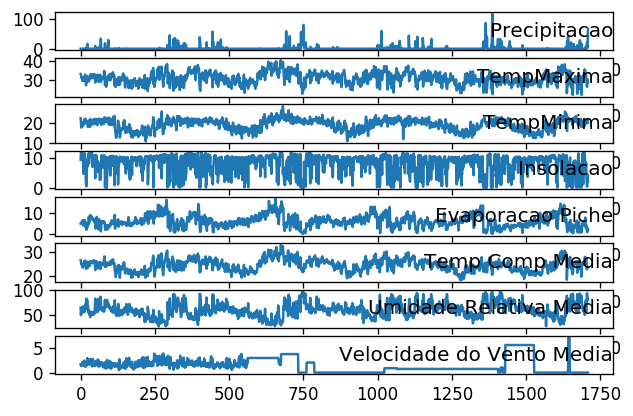

../data_in/MG_Paracatu.csv


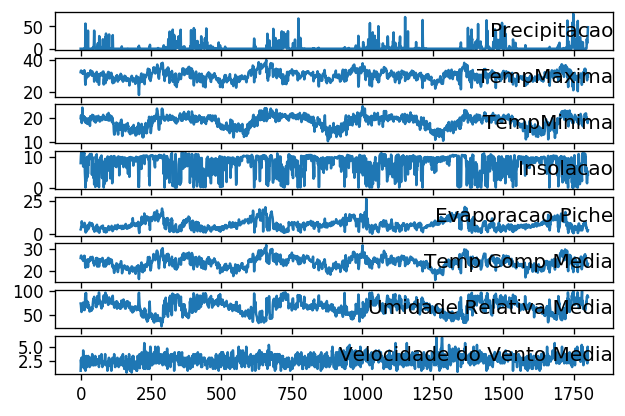

../data_in/MG_PatosDeMinas.csv


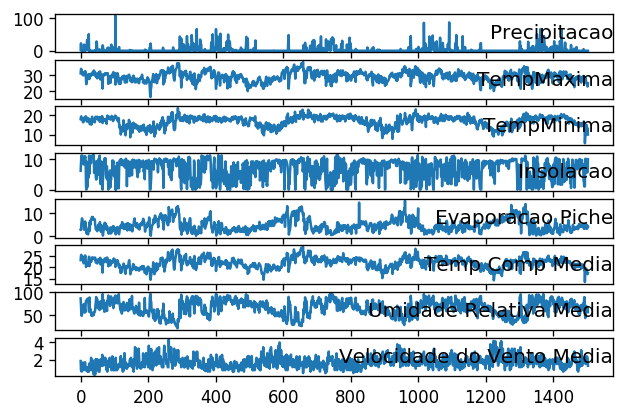

../data_in/MG_PedraAzul.csv


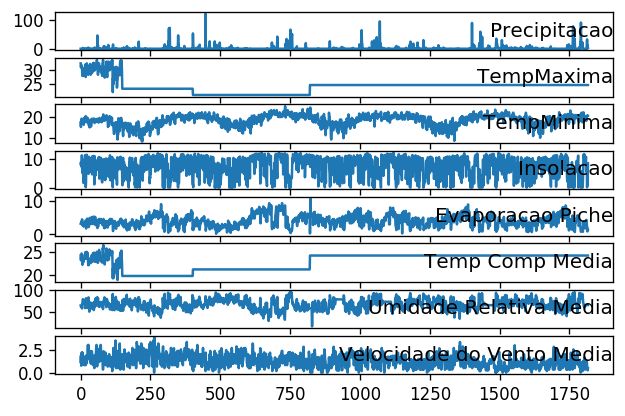

../data_in/MG_Pirapora.csv


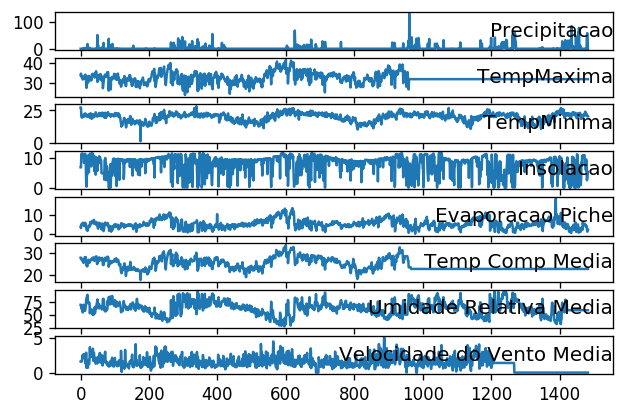

../data_in/MG_Pompeu.csv


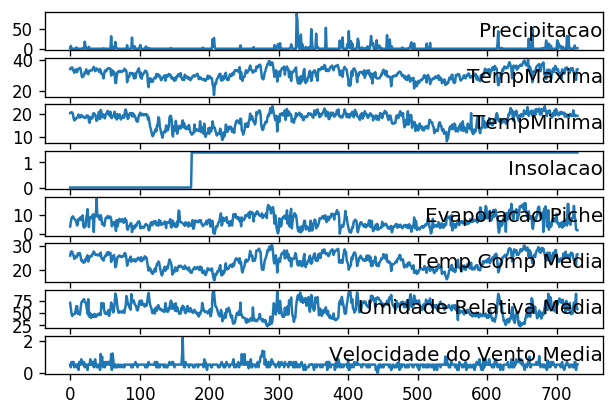

../data_in/MG_Salinas.csv


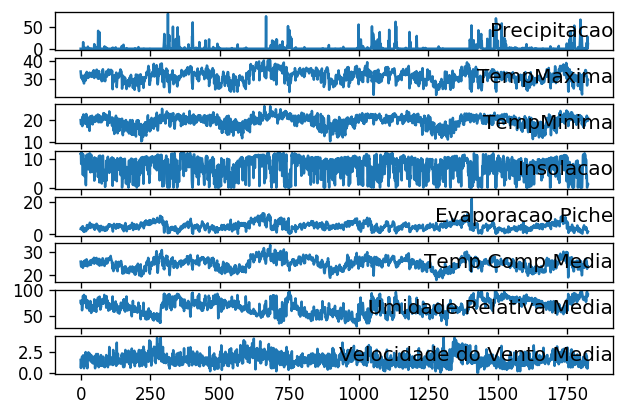

../data_in/MG_SaoLourenco.csv


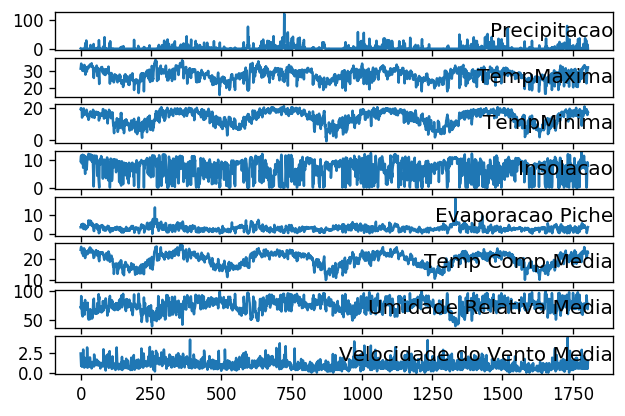

../data_in/MG_SeteLagoas.csv


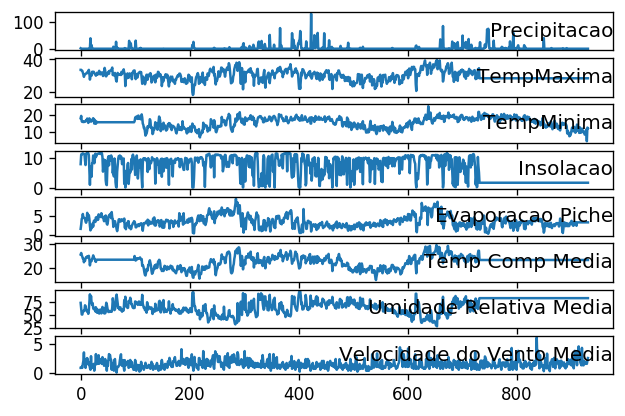

../data_in/MG_Uberaba.csv


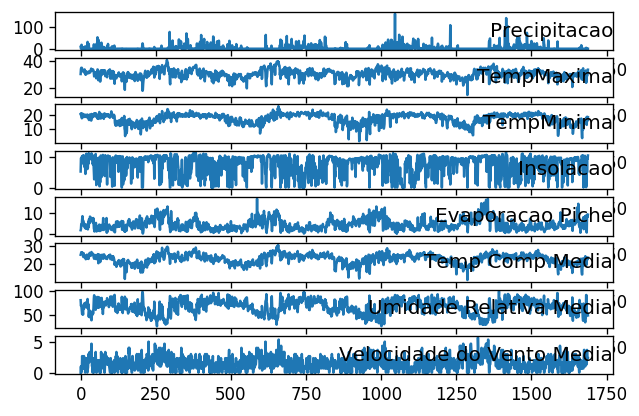

../data_in/MG_Unai.csv


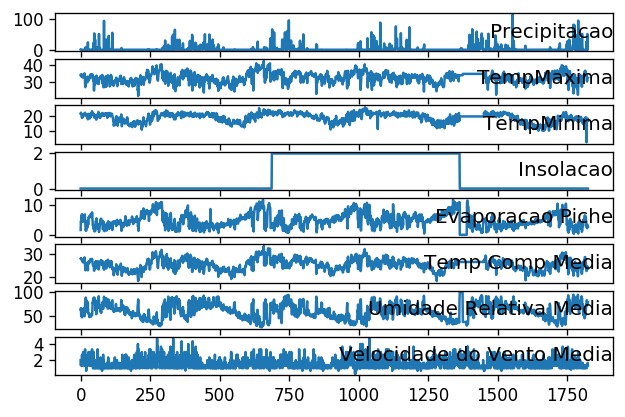

../data_in/MG_Vicosa.csv


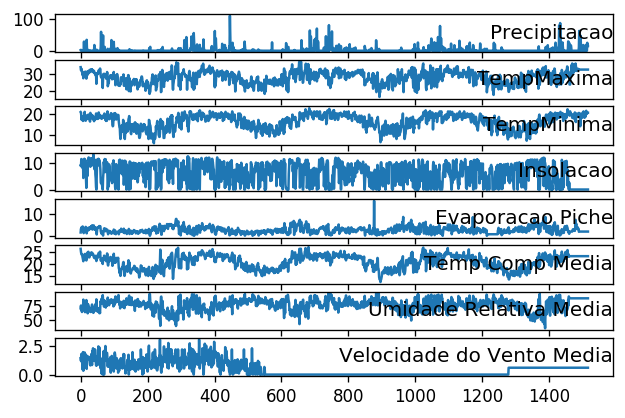

../data_in/MS_Corumba.csv


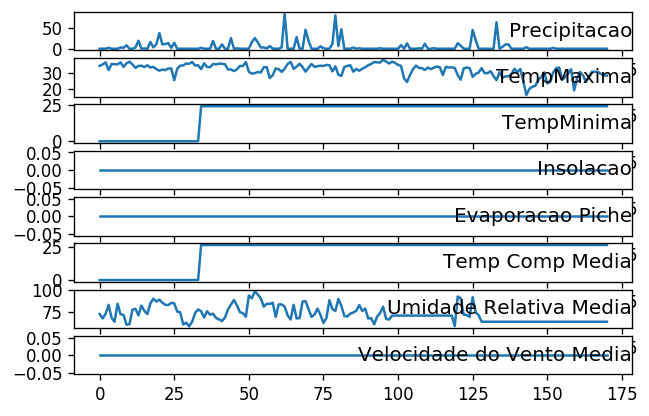

../data_in/MS_Ivinhema.csv


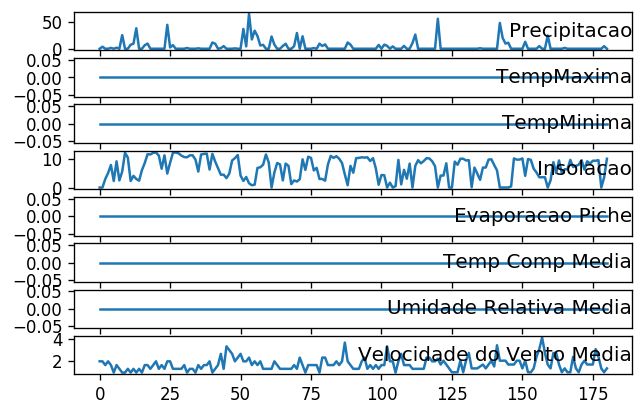

../data_in/MS_NhumirimNhecolandia.csv


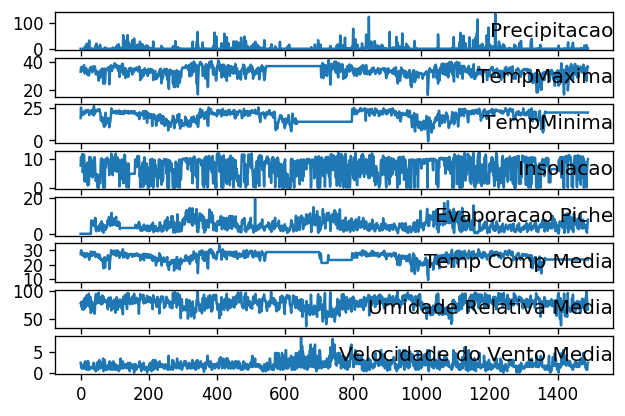

../data_in/MS_Paranaiba.csv


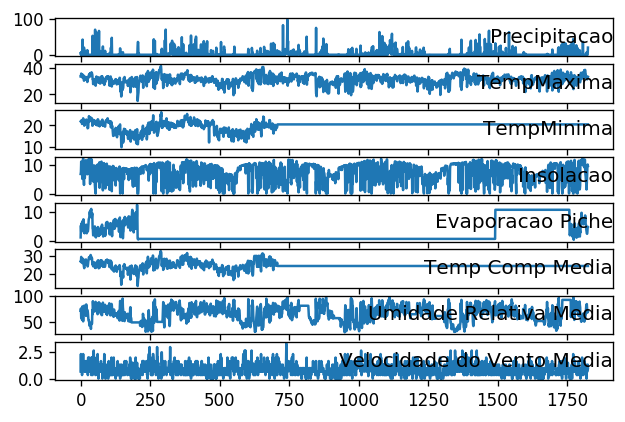

../data_in/MS_PontaPora.csv


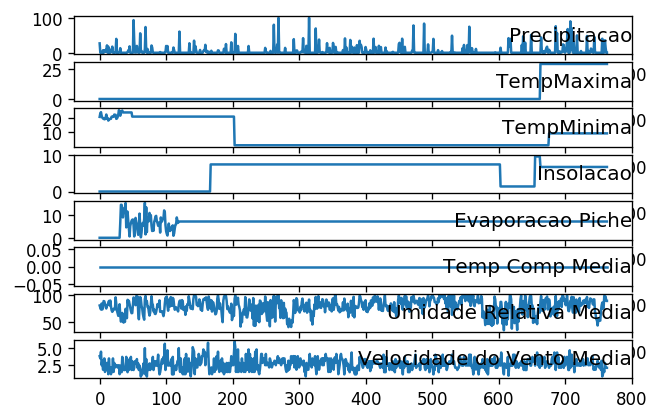

../data_in/MT_Caceres.csv


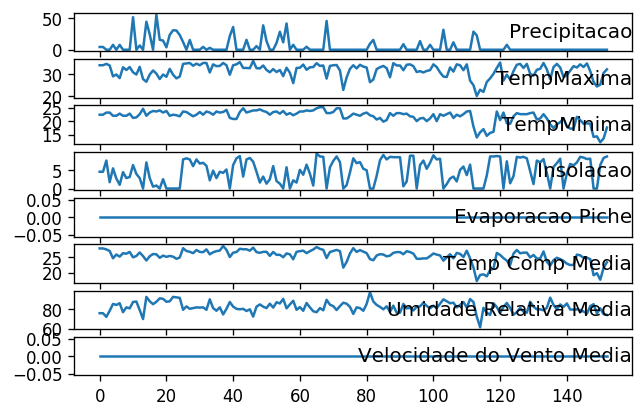

../data_in/MT_Canarana.csv


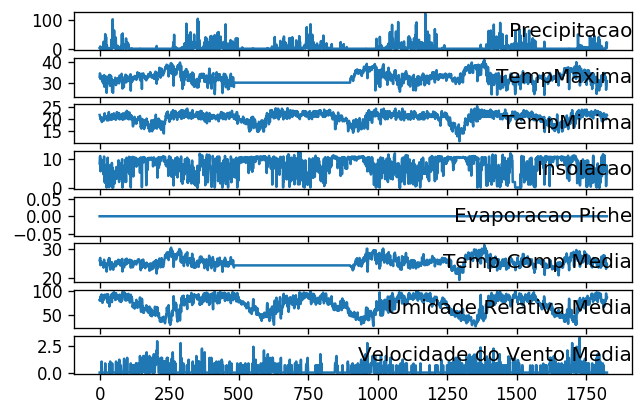

../data_in/MT_Cuiaba.csv


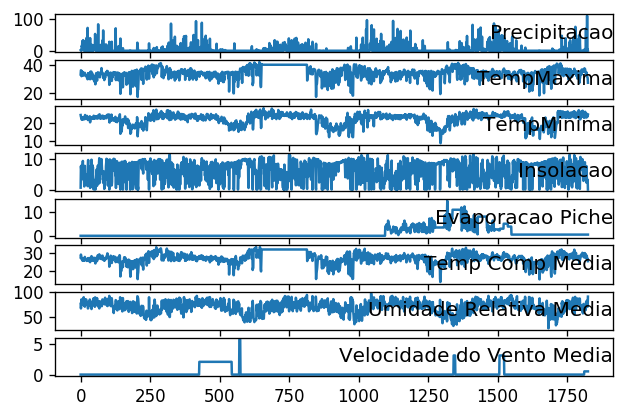

../data_in/MT_Diamantino.csv


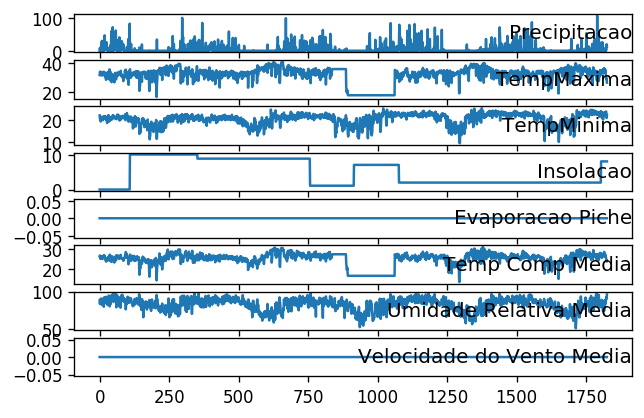

../data_in/MT_GlebaCeleste.csv


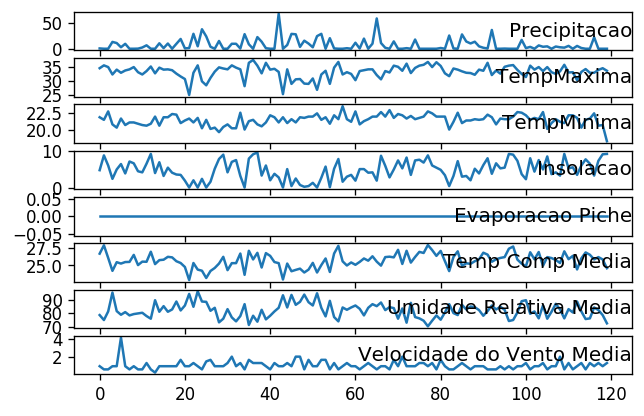

../data_in/MT_Matupa.csv


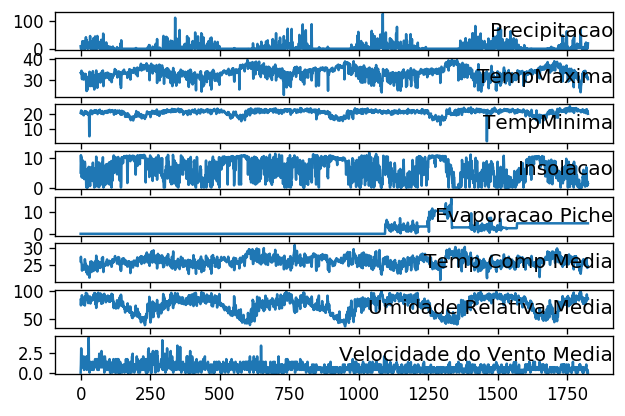

../data_in/MT_NovaXavXavantina.csv


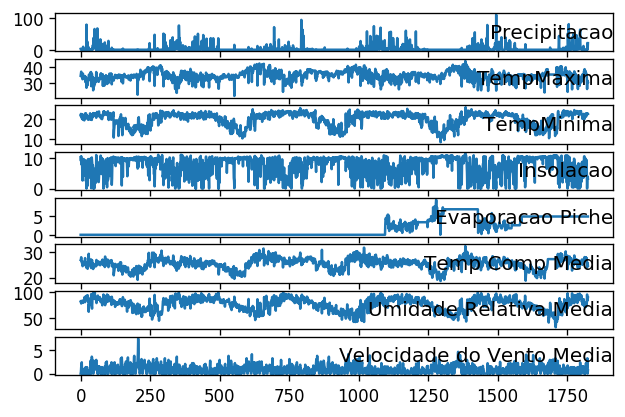

../data_in/MT_PadreRicardoRemetter.csv


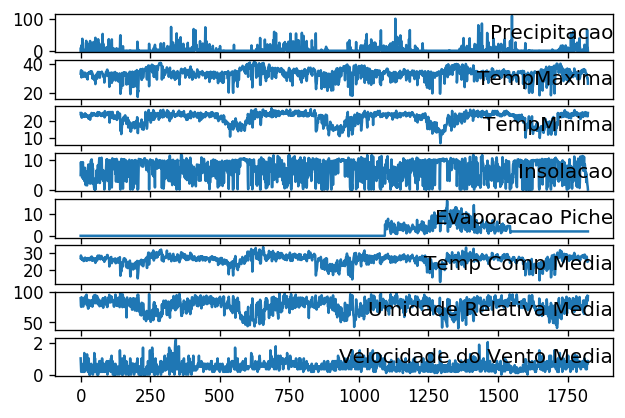

../data_in/MT_Poxoreo.csv


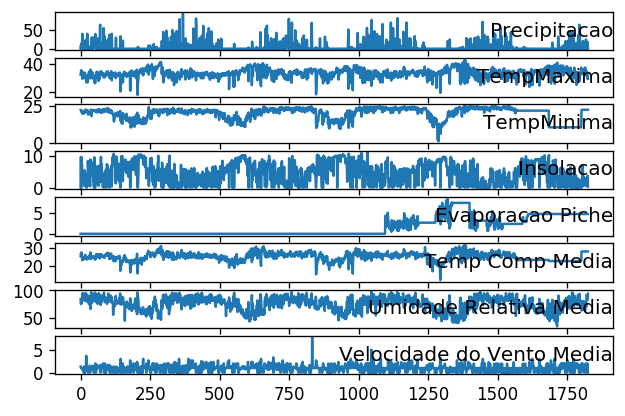

../data_in/MT_Rondonopolis.csv


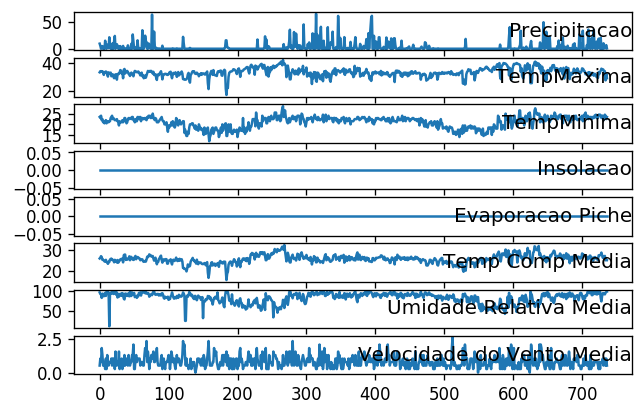

../data_in/MT_SaoJoseDoRioClaro.csv


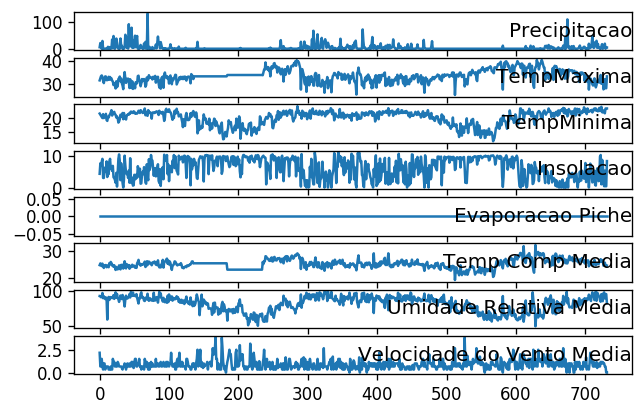

../data_in/PA_Altamira.csv


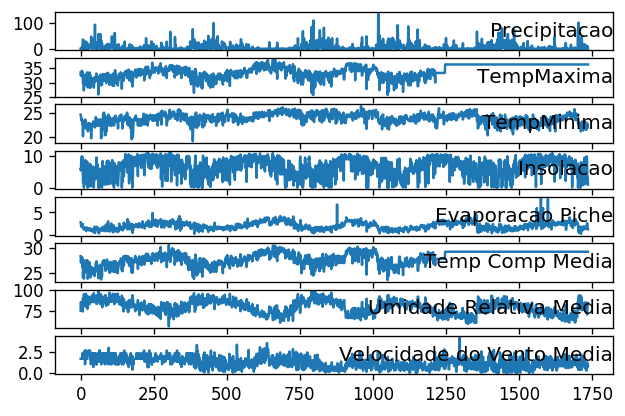

../data_in/PA_Belem.csv


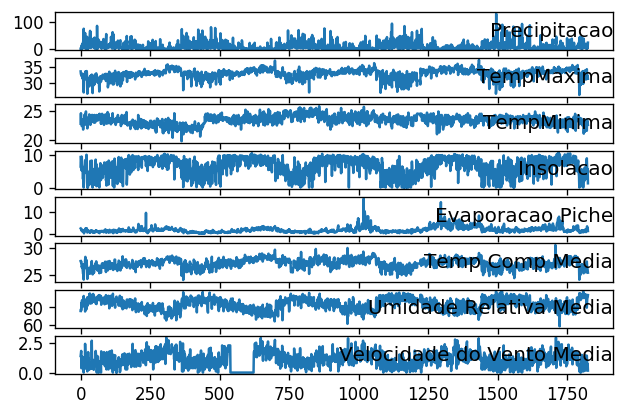

../data_in/PA_Belterra.csv


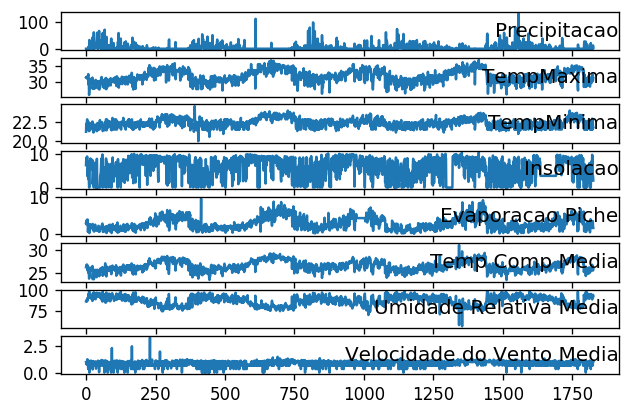

../data_in/PA_Breves.csv


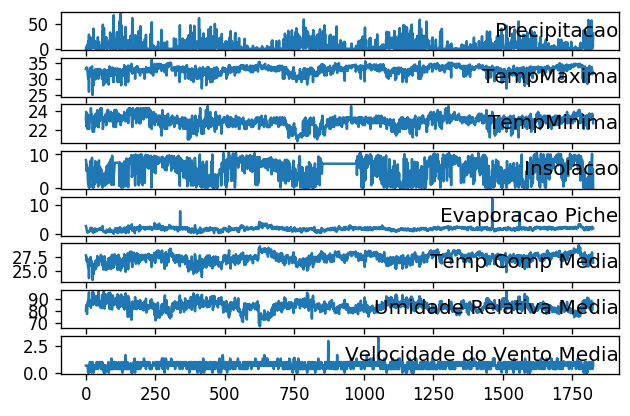

../data_in/PA_Cameta.csv


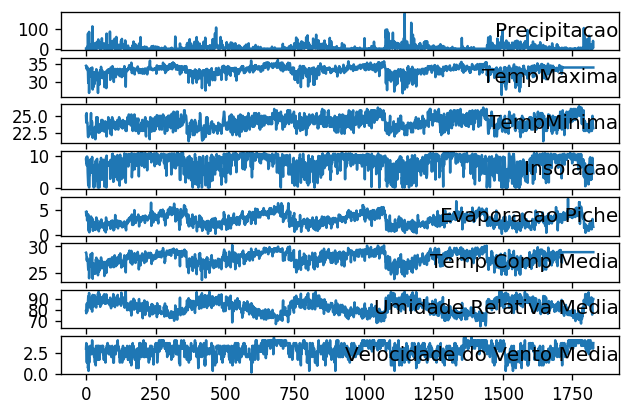

../data_in/PA_ConceicaoDoAraguaia.csv


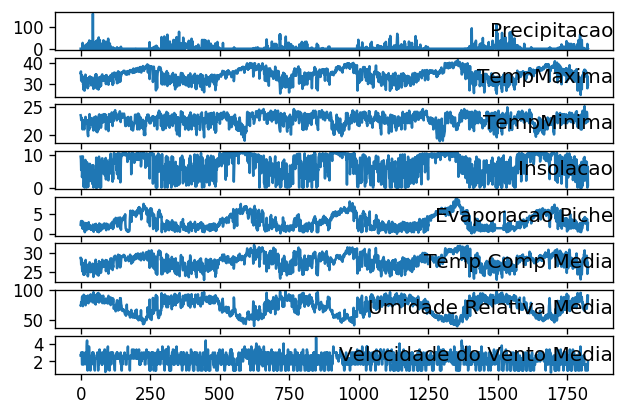

../data_in/PA_Itaituba.csv


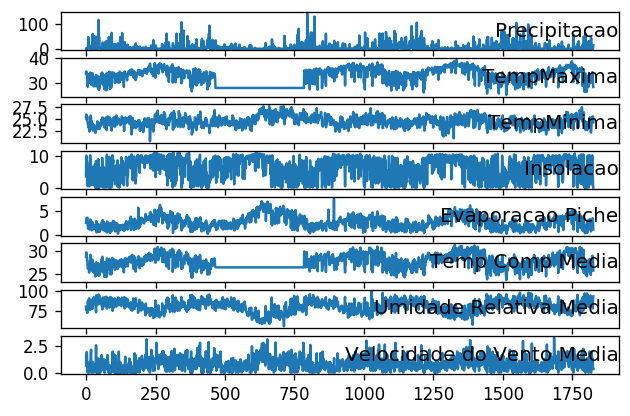

../data_in/PA_Maraba.csv


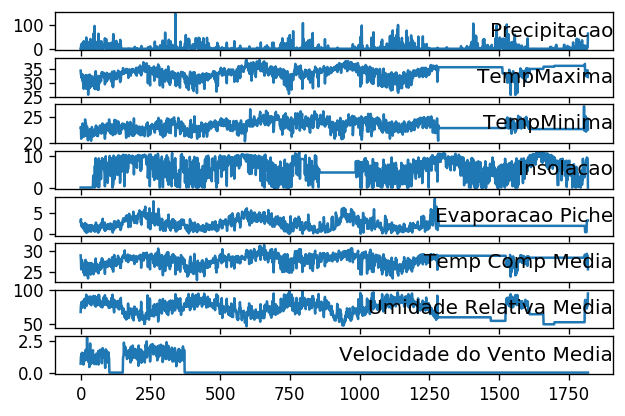

../data_in/PA_MonteAlegre.csv


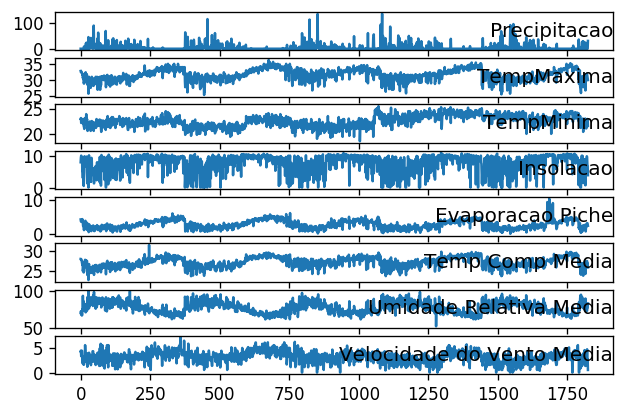

../data_in/PA_Obidos.csv


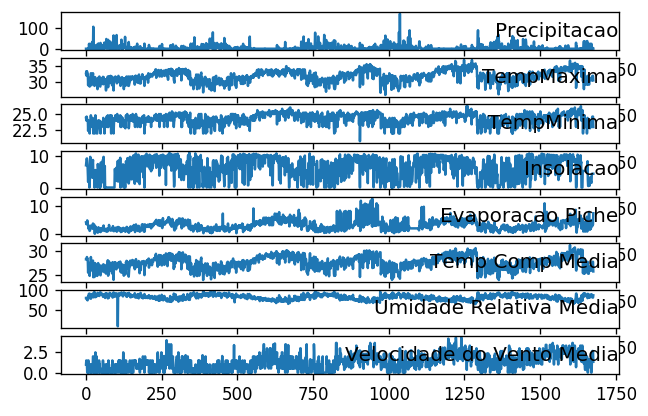

../data_in/PA_PortoDeMoz.csv


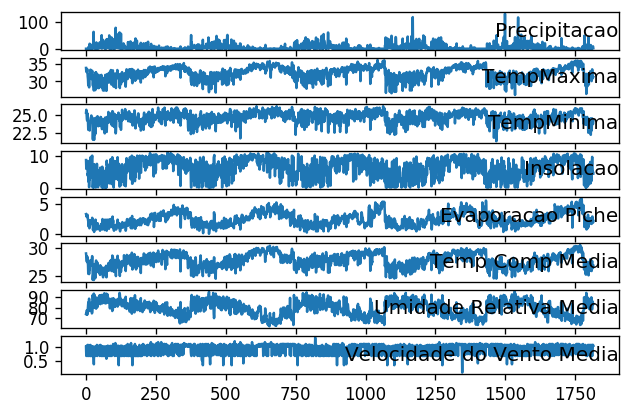

../data_in/PA_SaoFelixDoXingu.csv


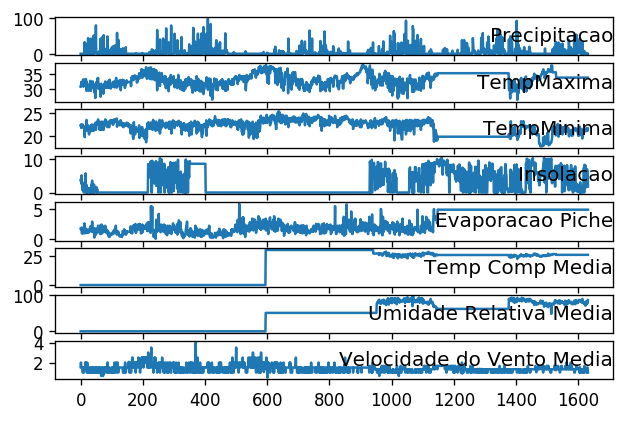

../data_in/PA_Soure.csv


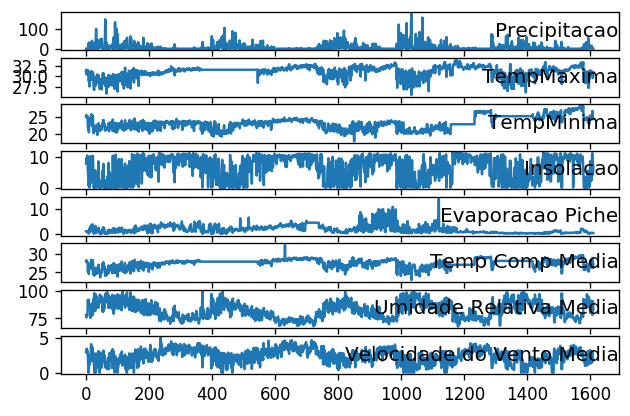

../data_in/PA_Tracuateua.csv


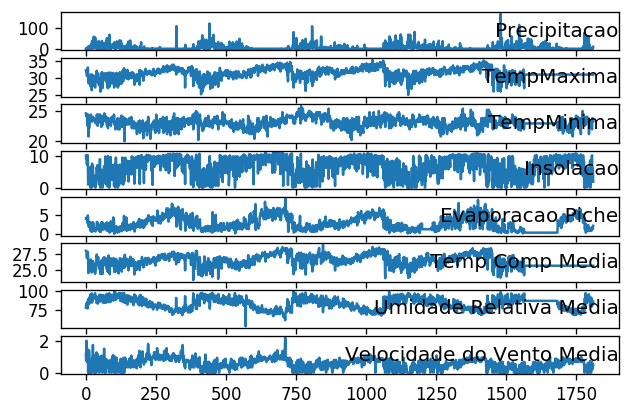

../data_in/PA_Tucurui.csv


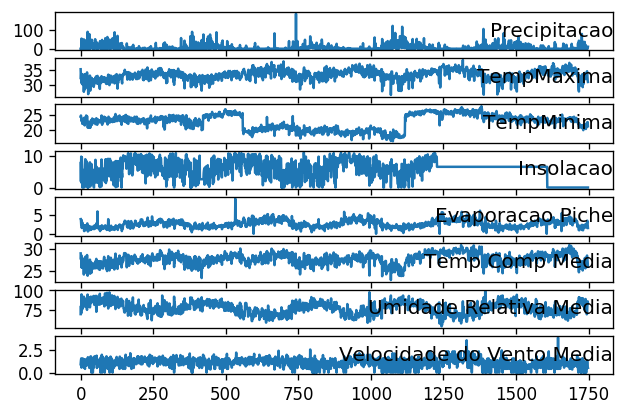

../data_in/PB_Areia.csv


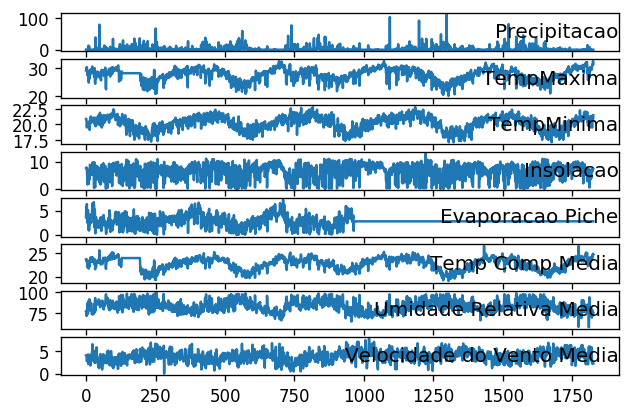

../data_in/PB_CampinaGrande.csv


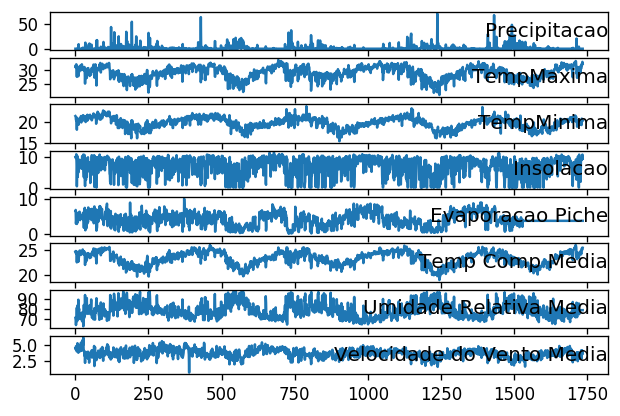

../data_in/PB_JoaoPessoa.csv


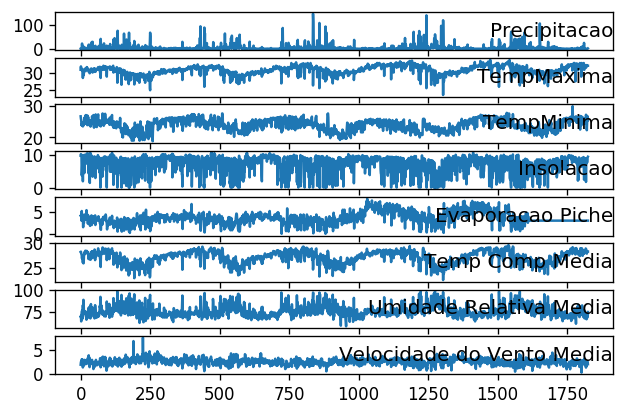

../data_in/PB_Monteiro.csv


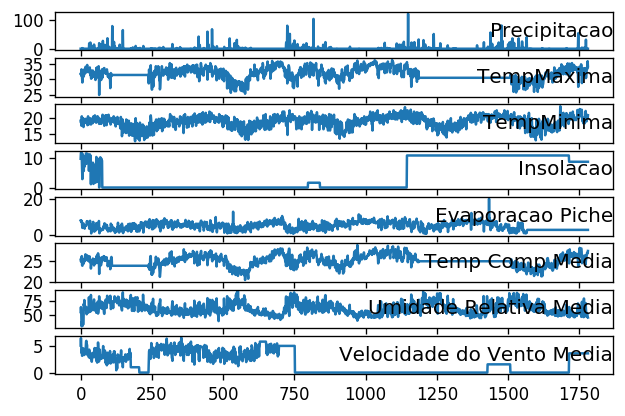

../data_in/PB_Patos.csv


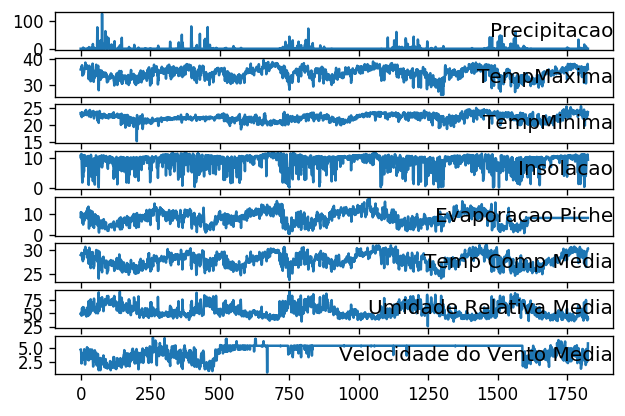

../data_in/PB_SaoGoncalo.csv


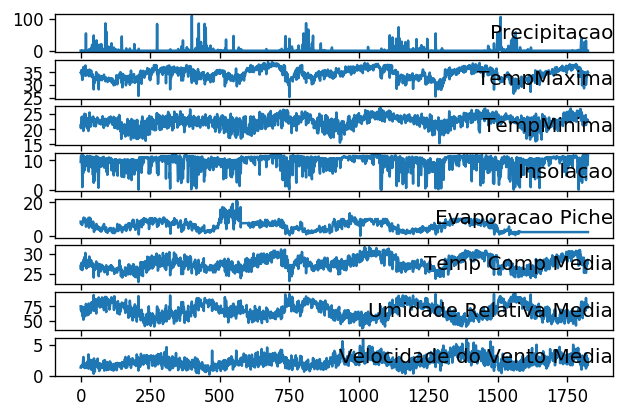

../data_in/PE_ARCOVERDE.csv


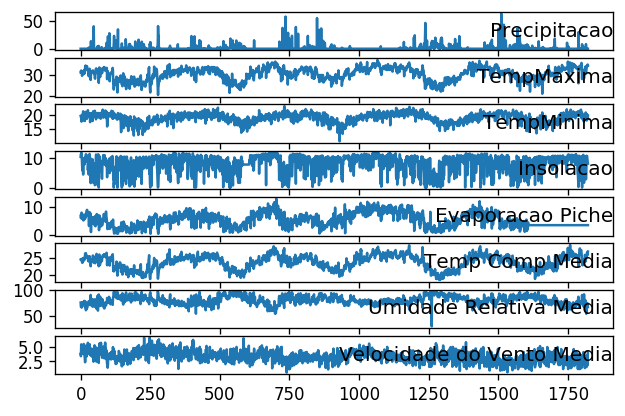

../data_in/PE_CABROSO.csv


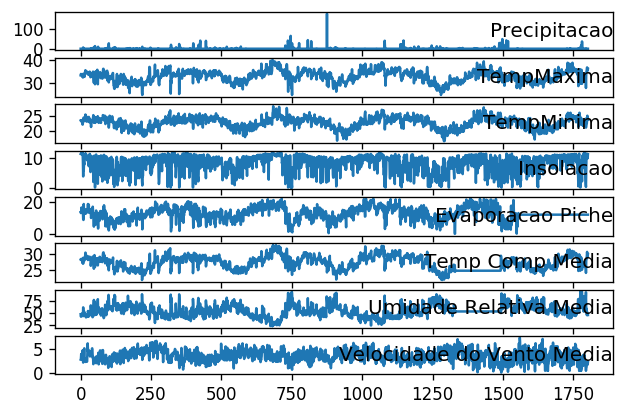

../data_in/PE_GARANHUNS.csv


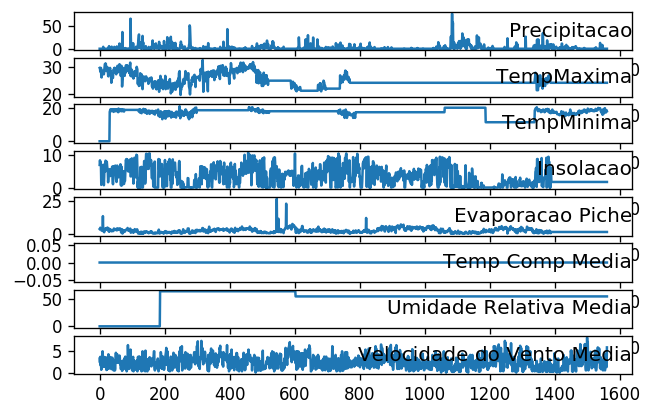

../data_in/PE_OURICURI.csv


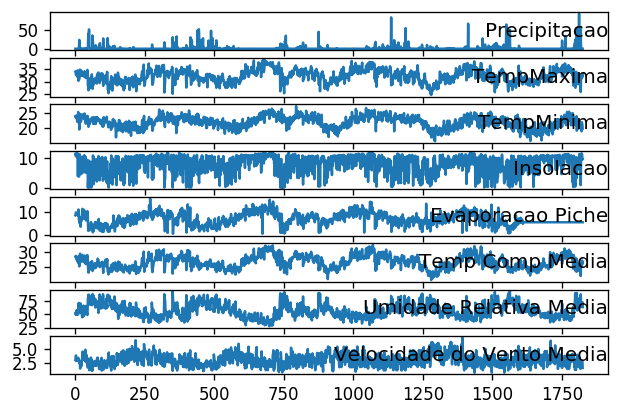

../data_in/PE_PETROLINA.csv


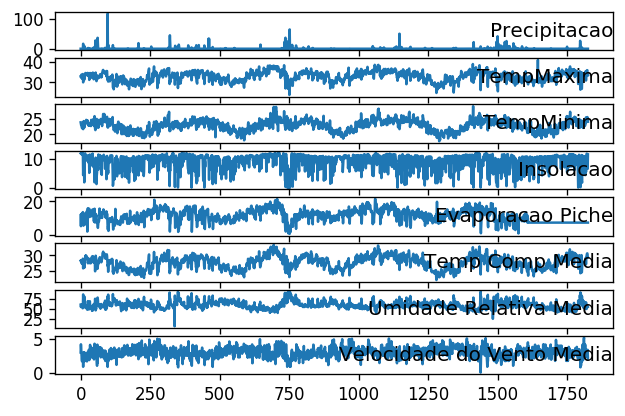

../data_in/PE_RECIFE.csv


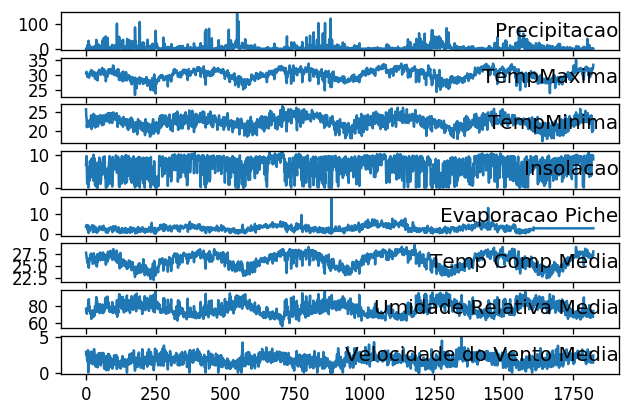

../data_in/PE_SURUBIM.csv


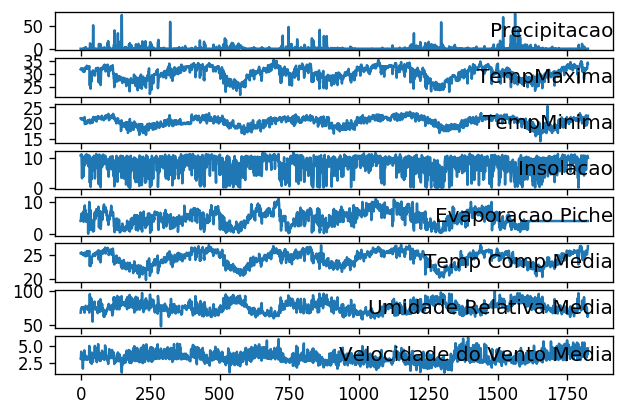

../data_in/PE_TRIUNFO.csv


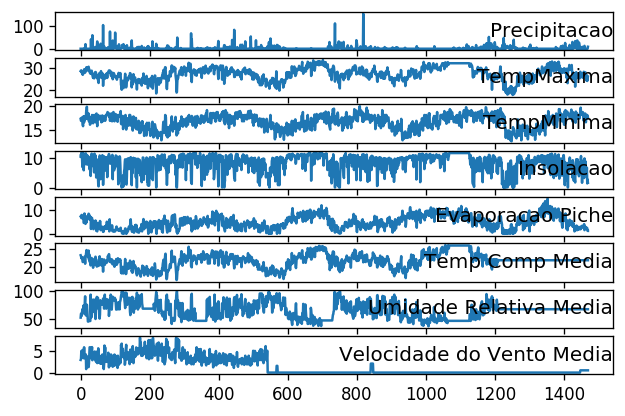

../data_in/PI_BOMJESUS.csv


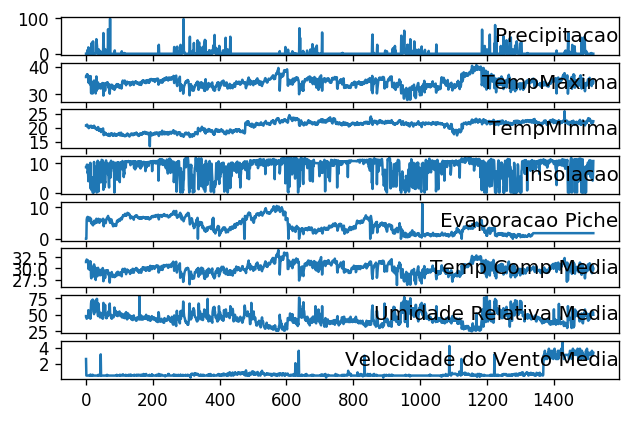

../data_in/PI_CALDEIRAO.csv


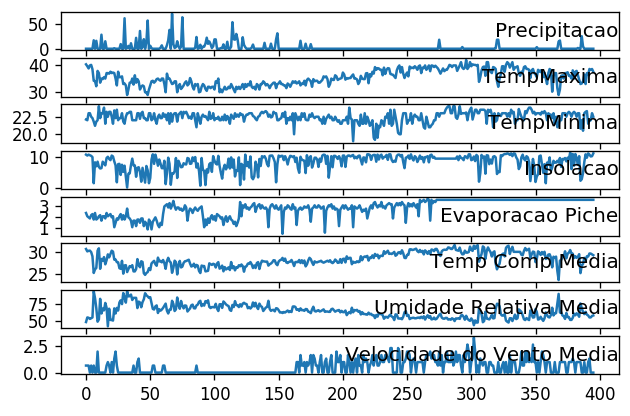

../data_in/PI_CARACOL.csv


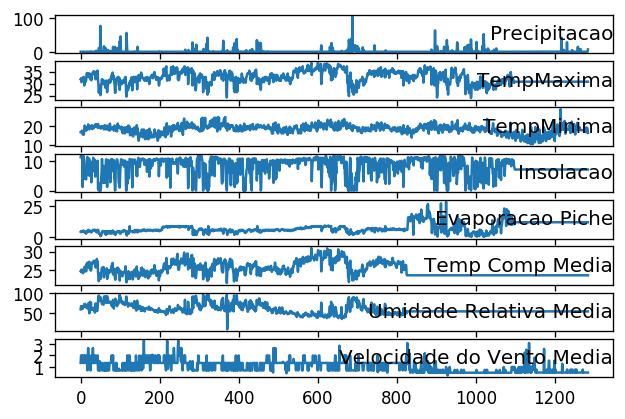

../data_in/PI_ESPERANTINA.csv


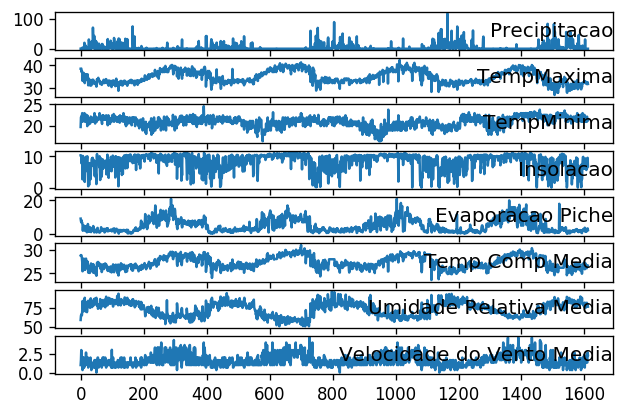

../data_in/PI_FLORIANO.csv


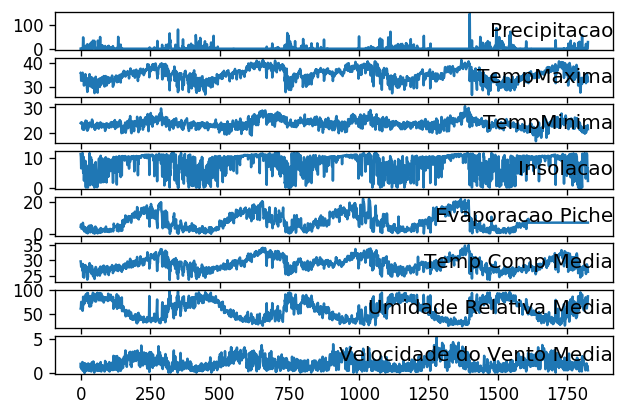

../data_in/PI_LUZILANDIA.csv


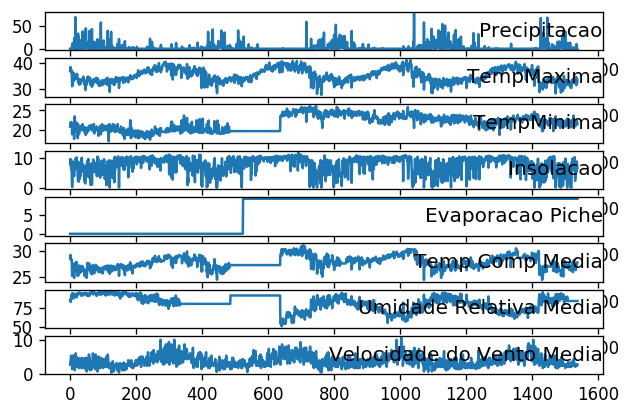

../data_in/PI_PARNAIBA.csv


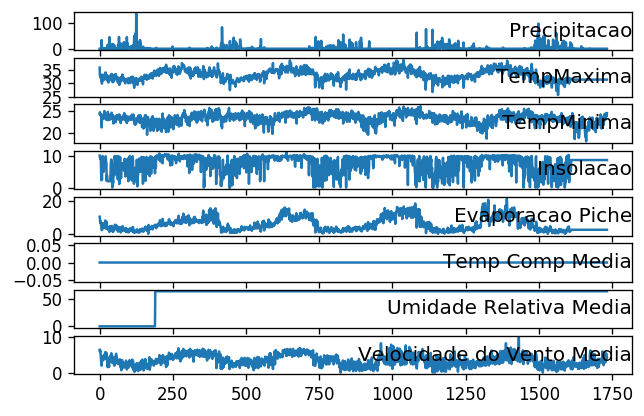

../data_in/PI_PAULISTANA.csv


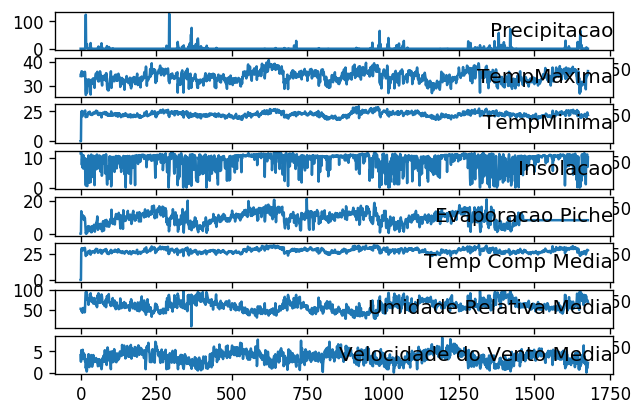

../data_in/PI_PICOS.csv


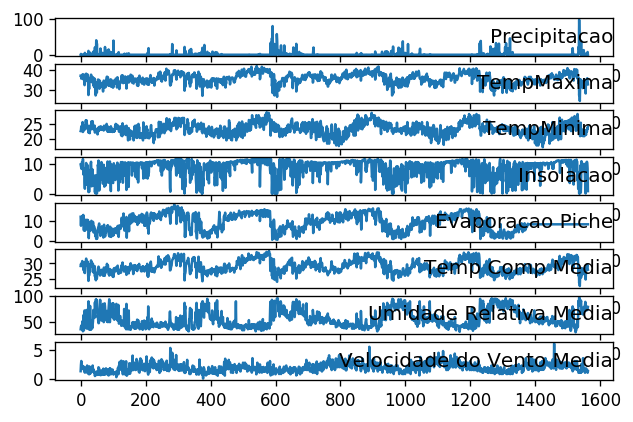

../data_in/PI_PIRIPIRI.csv


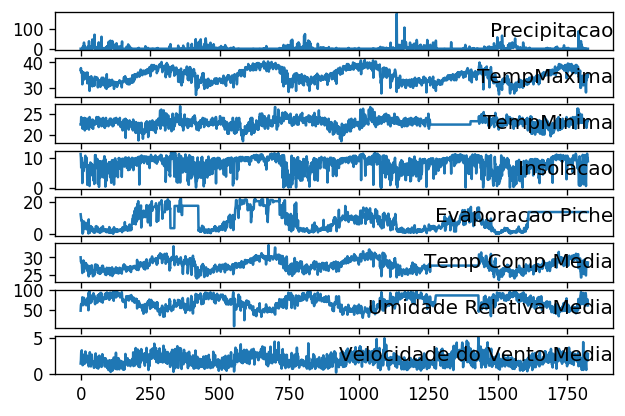

../data_in/PI_SAOJOAO.csv


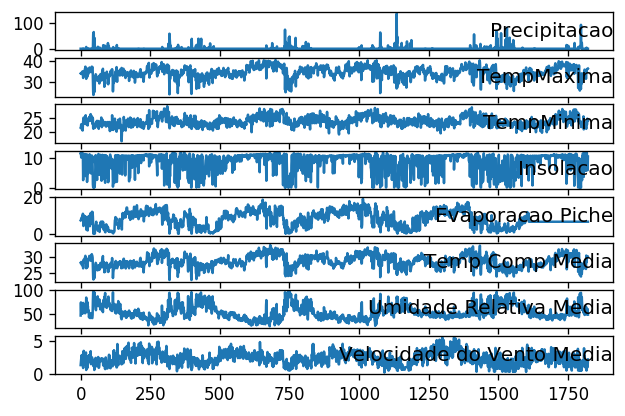

../data_in/PI_TERESINA.csv


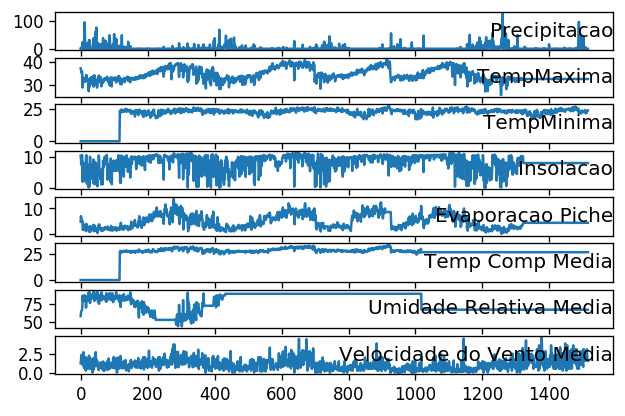

../data_in/PI_VALEDOGURGUEIA.csv


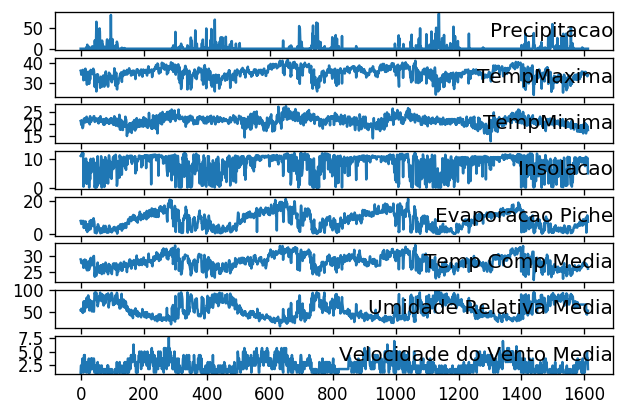

../data_in/PR-IRATI.csv


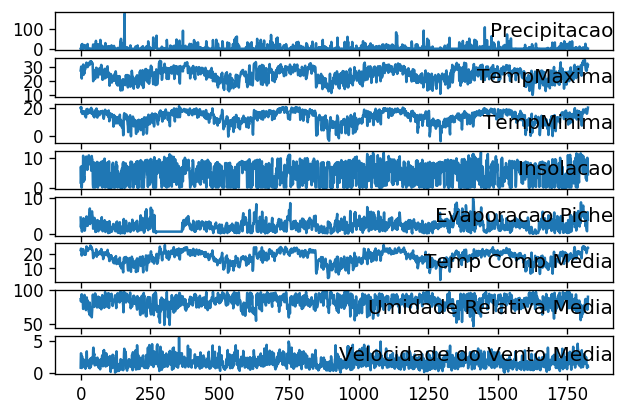

../data_in/PR_CAMPOSMOURAO.csv


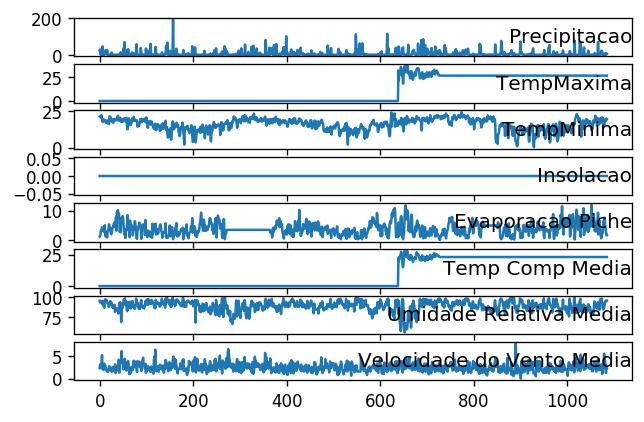

../data_in/PR_CASTRO.csv


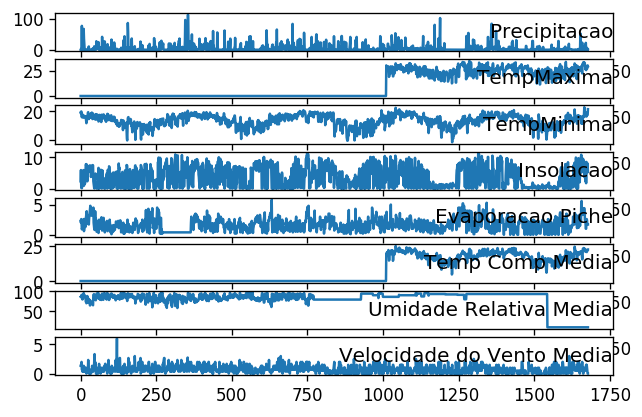

../data_in/PR_CURITIBA.csv


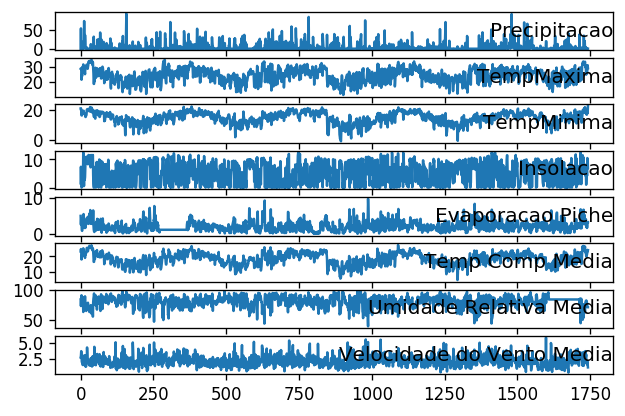

../data_in/PR_IVAI.csv


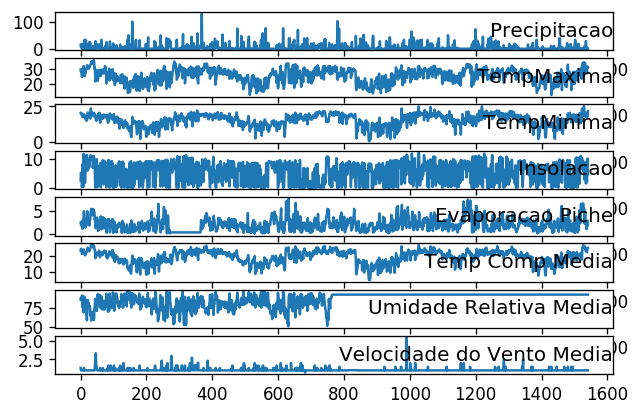

../data_in/PR_LONDRINA.csv


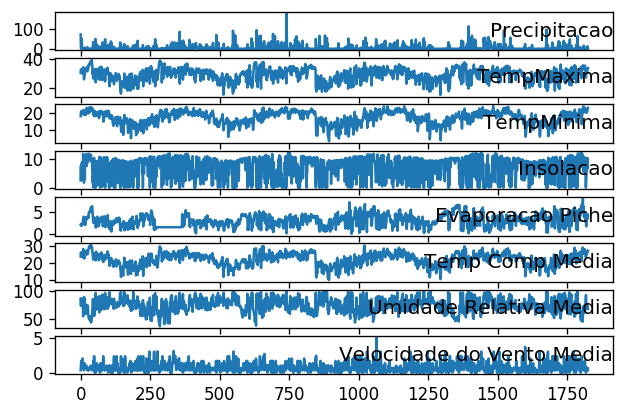

../data_in/PR_MARINGA.csv


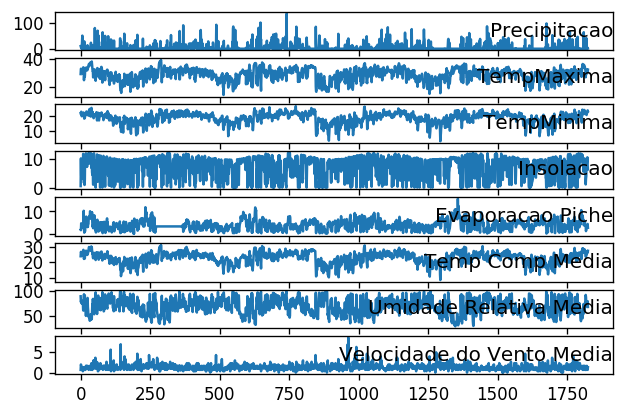

../data_in/PR_PARANAGUA.csv


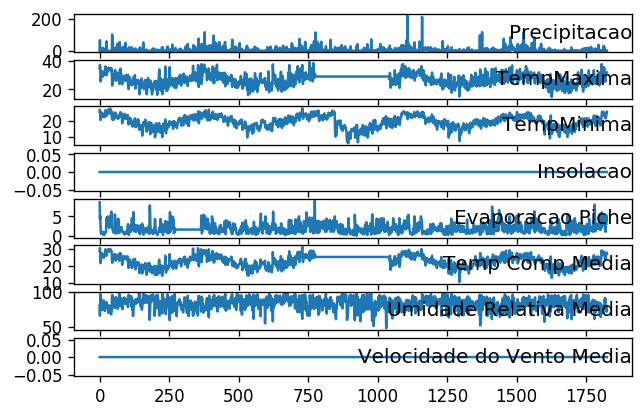

../data_in/RJ_AVELAR.csv


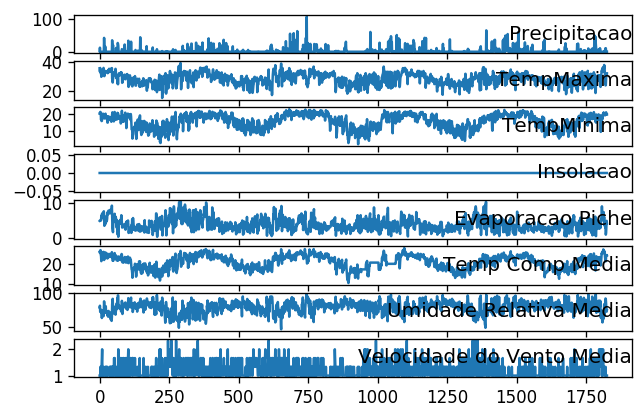

../data_in/RJ_CORDEIRO.csv


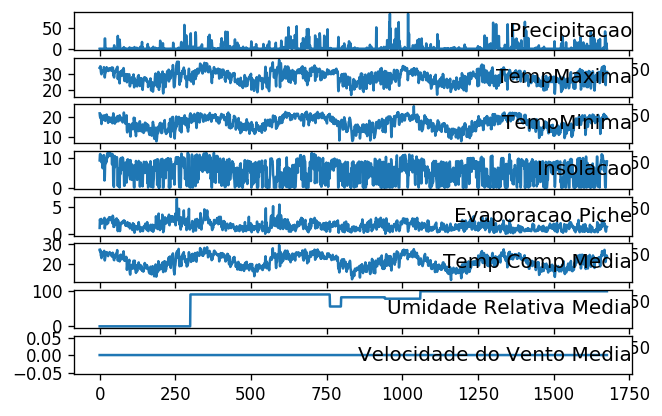

../data_in/RJ_ITAPERUNA.csv


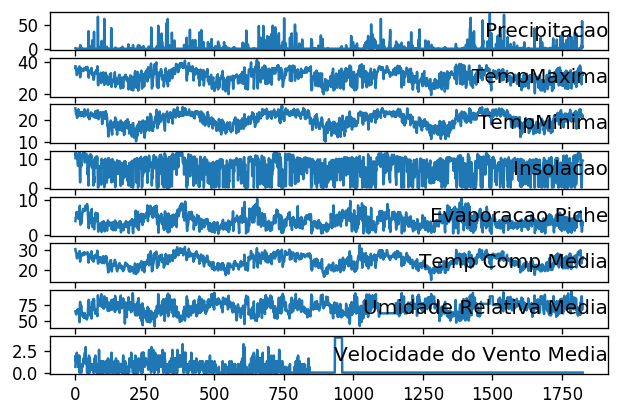

../data_in/RJ_RESENDE.csv


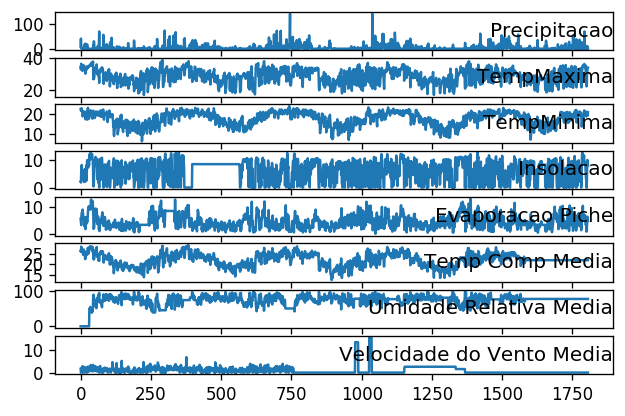

../data_in/RJ_Rio de Janeiro.csv


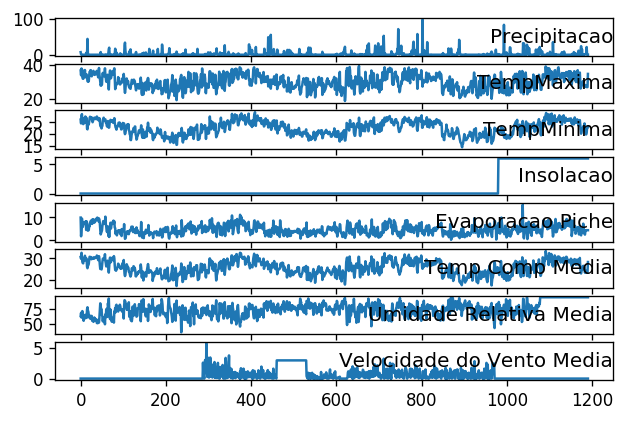

../data_in/RN-FLORANIA.csv


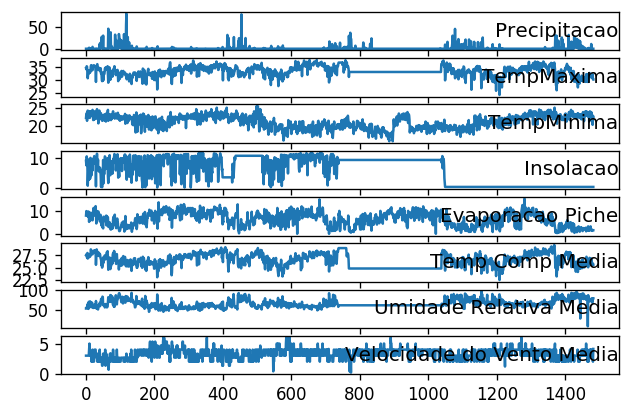

../data_in/RN_APODI.csv


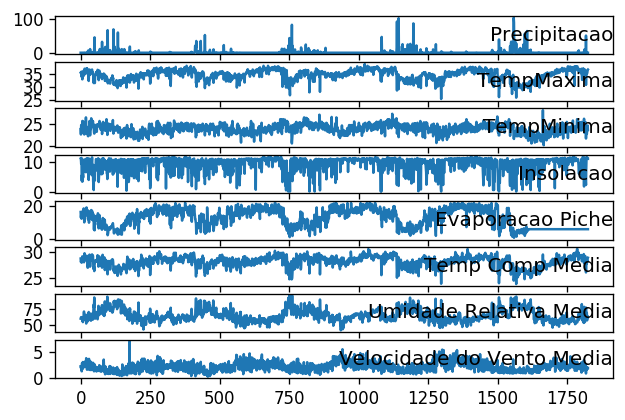

../data_in/RN_CEARAMIRIM.csv


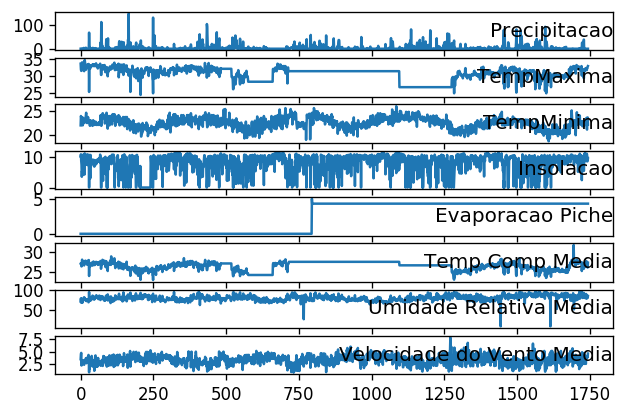

../data_in/RN_CRUZETA.csv


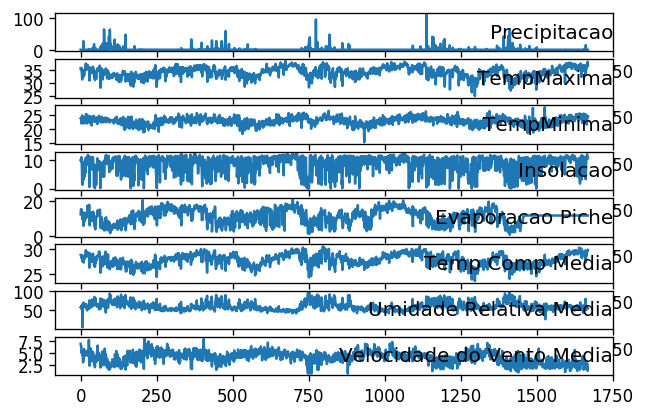

../data_in/RN_MACAU.csv


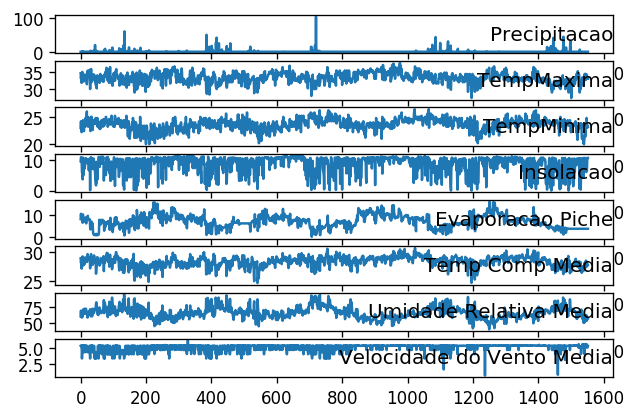

../data_in/RN_NATAL.csv


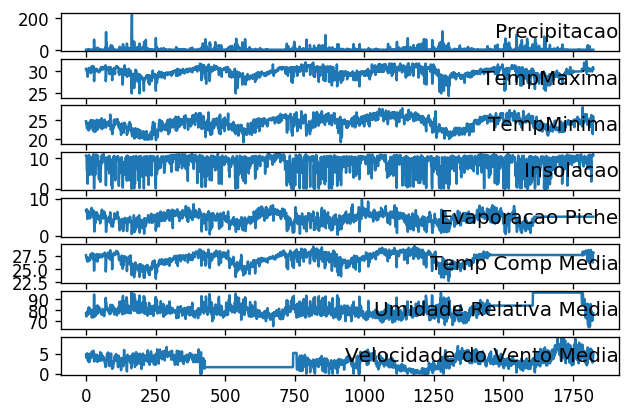

../data_in/RN_SERIDOCAICO.csv


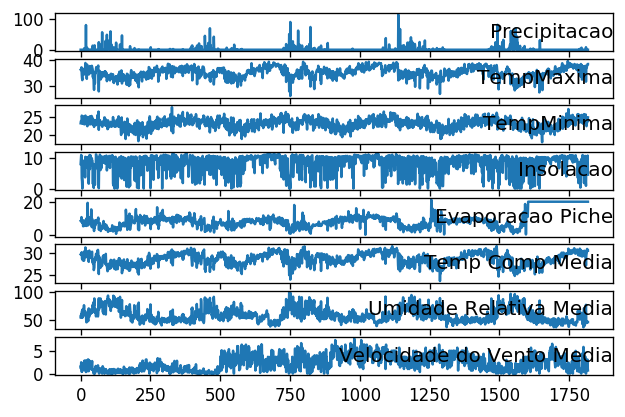

../data_in/RR_BOAVISTA.csv


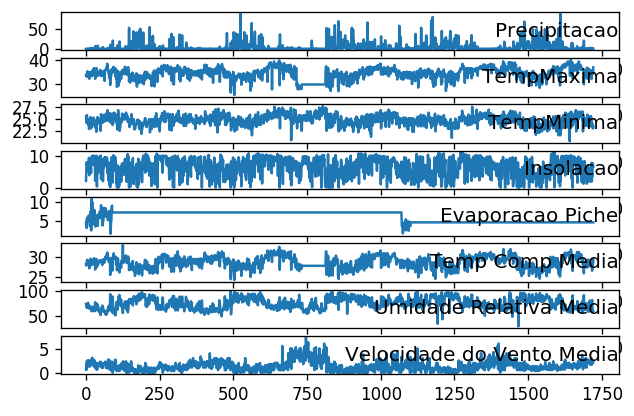

../data_in/RR_CARACARAI.csv


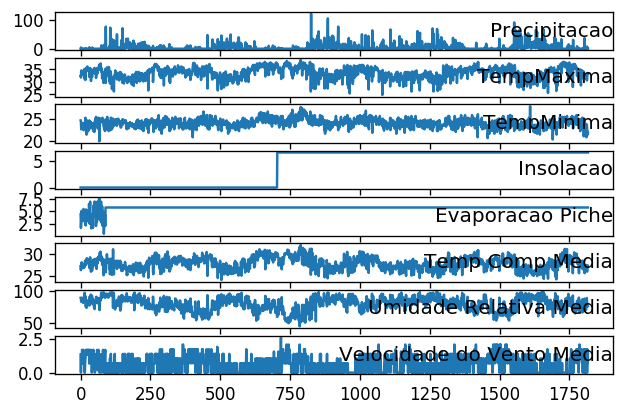

../data_in/RS_BOMJESUS.csv


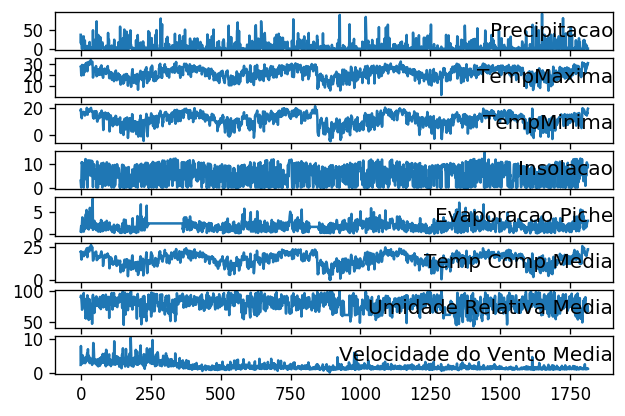

../data_in/RS_CAXIASDOSUL.csv


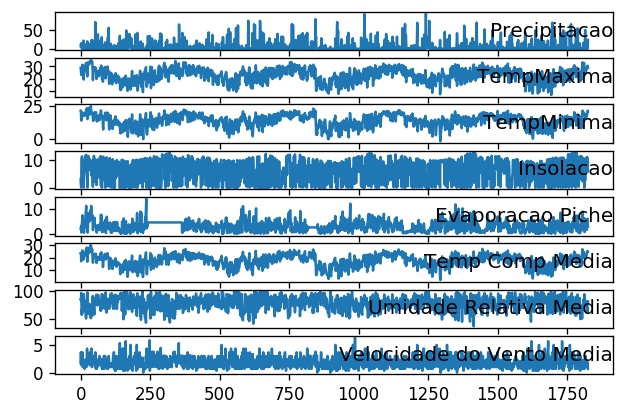

../data_in/RS_CRUZALTA.csv


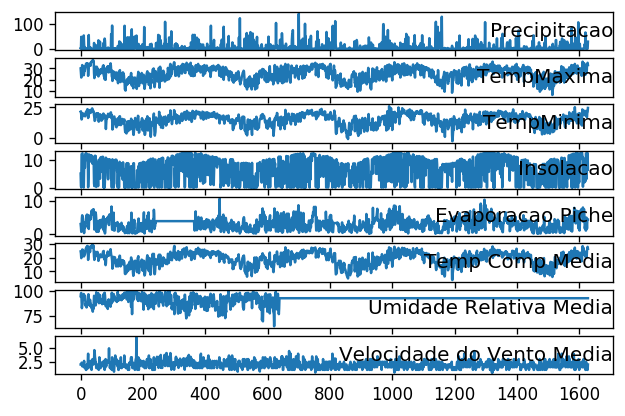

../data_in/RS_ENCRUZILHADADOSUL.csv


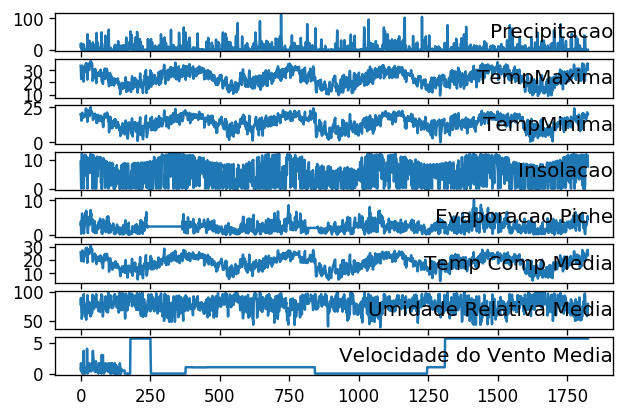

../data_in/RS_IRAI.csv


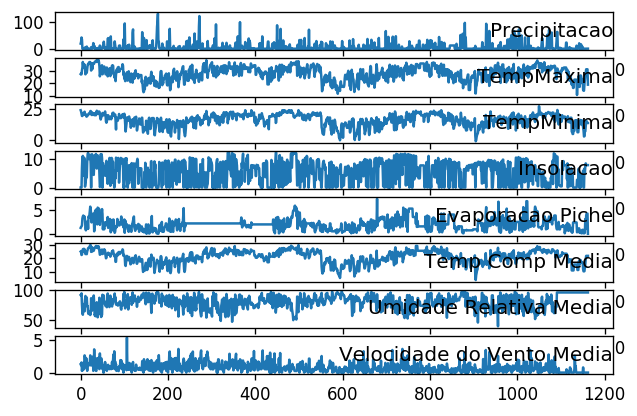

../data_in/RS_LAGOAVERMELHA.csv


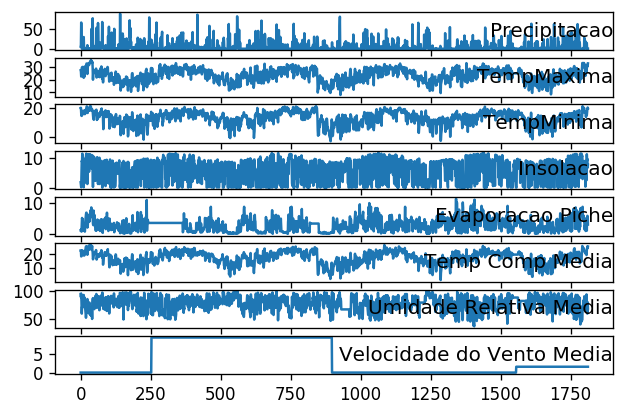

../data_in/RS_PASSOFUNDO.csv


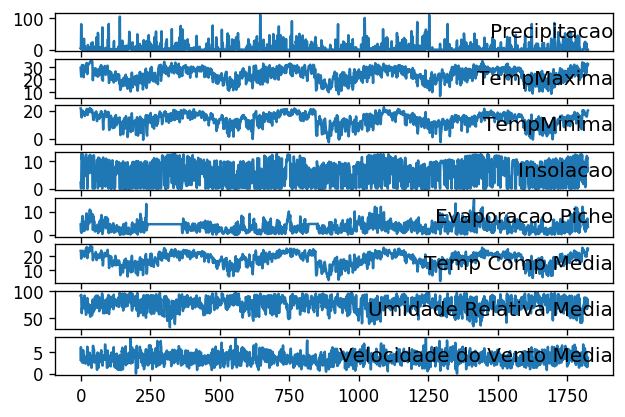

../data_in/RS_PELOTAS.csv


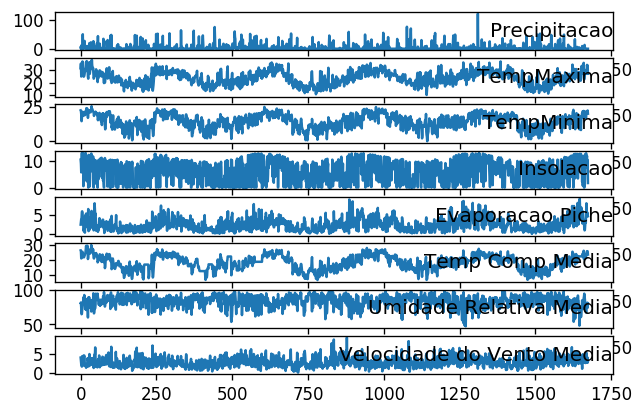

../data_in/RS_PORTOALEGRE.csv


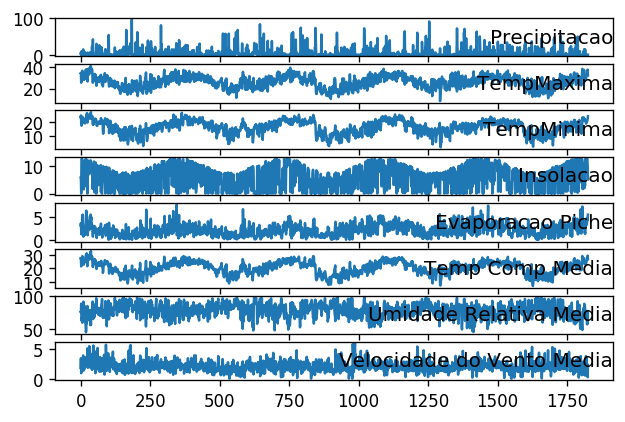

../data_in/RS_RAGE.csv


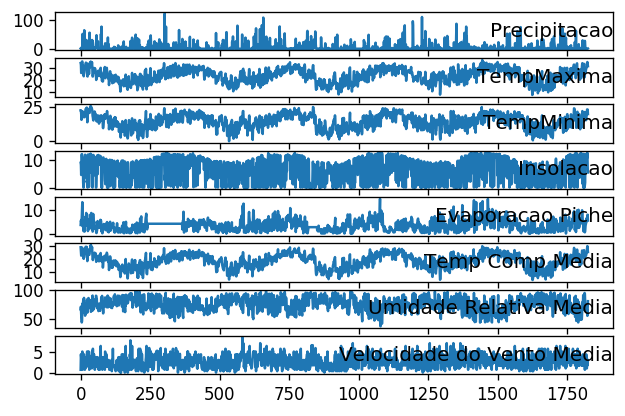

../data_in/RS_RIOGRANDE.csv


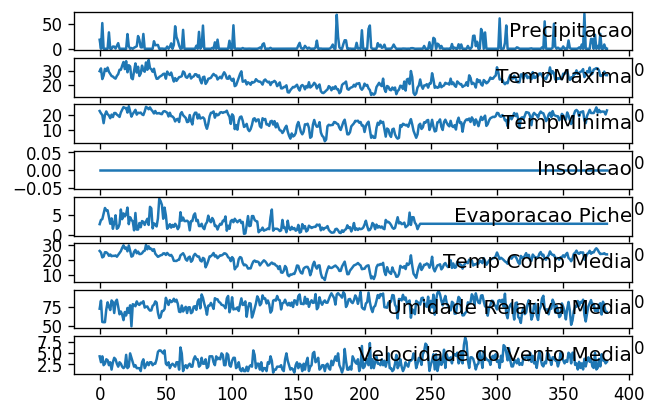

../data_in/RS_SANTAMARIA.csv


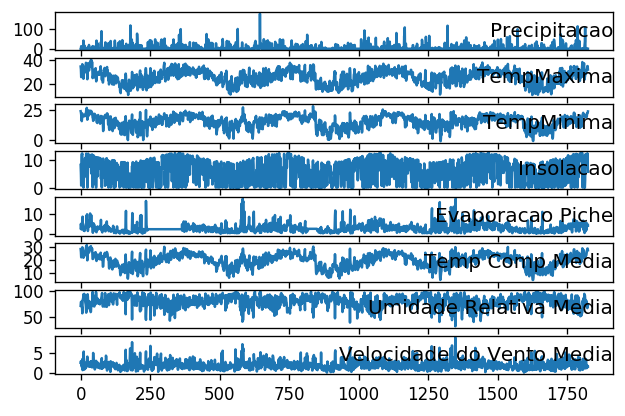

../data_in/RS_SANTAVITORIADOPALMAR.csv


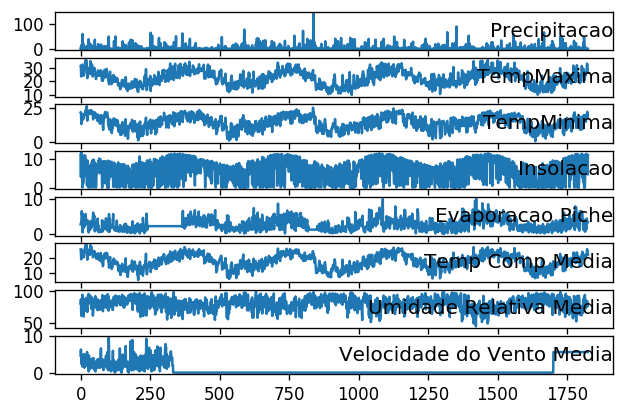

../data_in/RS_SAOLUIZGONZAGA.csv


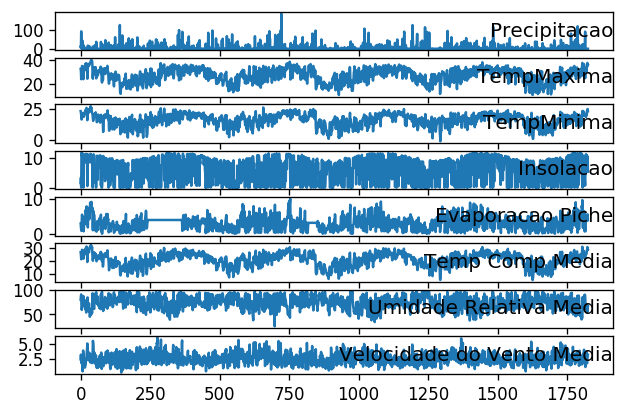

../data_in/RS_TORRES.csv


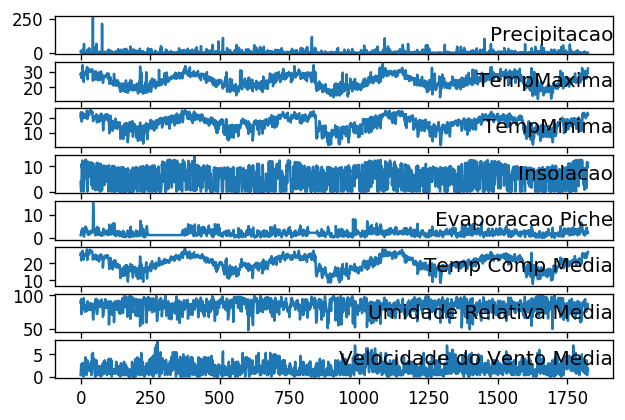

../data_in/RS_URUGUAINA.csv


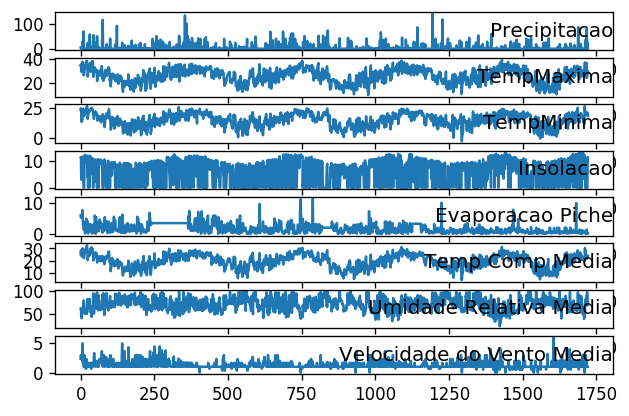

../data_in/SC_CAMPOSNOVOS.csv


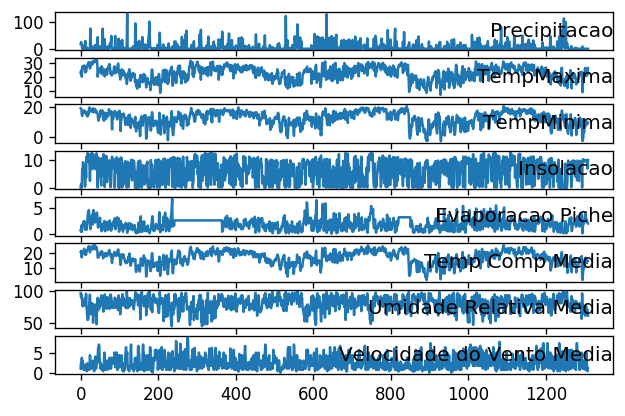

../data_in/SC_CHAPECO.csv


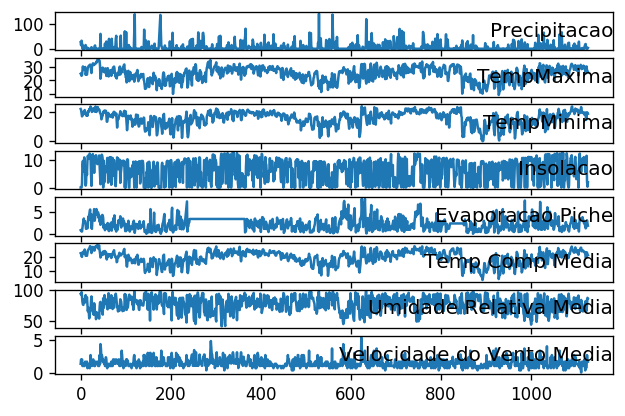

../data_in/SC_FLORIANOPOLIS.csv


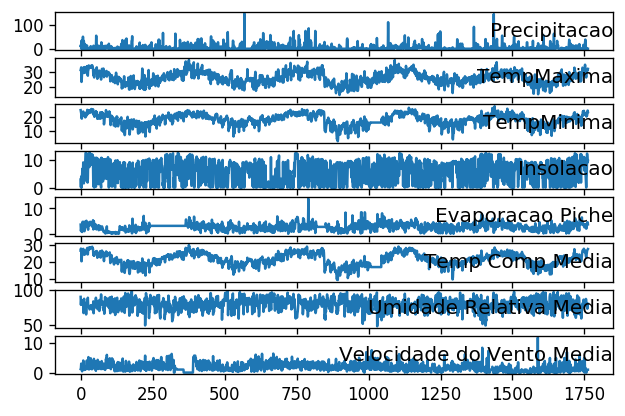

../data_in/SC_INDAIAL.csv


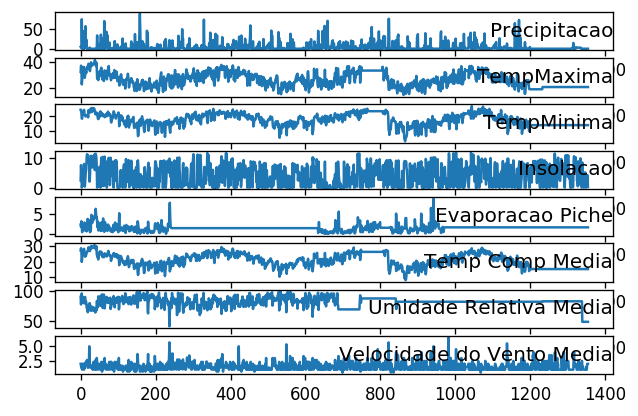

../data_in/SC_LAGES.csv


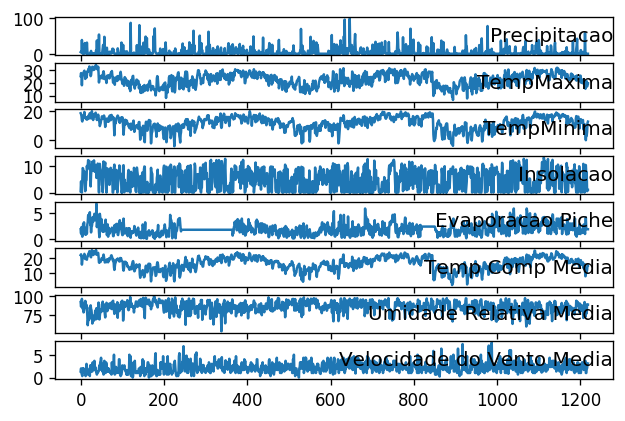

../data_in/SC_SAOJOAQUIM.csv


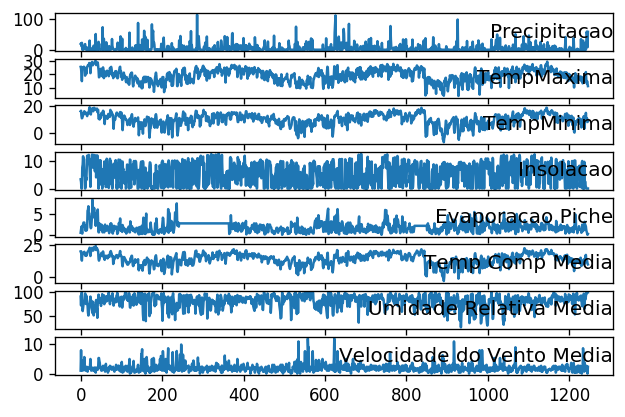

../data_in/SC_URUSSANGA.csv


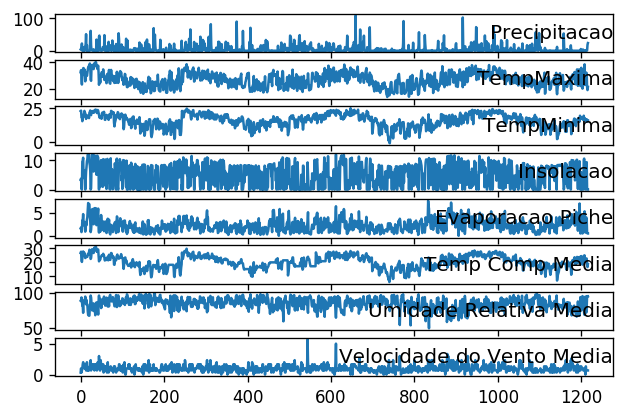

../data_in/SE_ARACAJU.csv


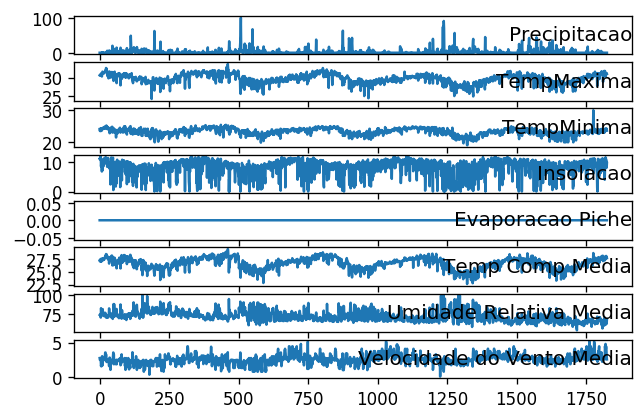

../data_in/SE_ITABAIANHIA.csv


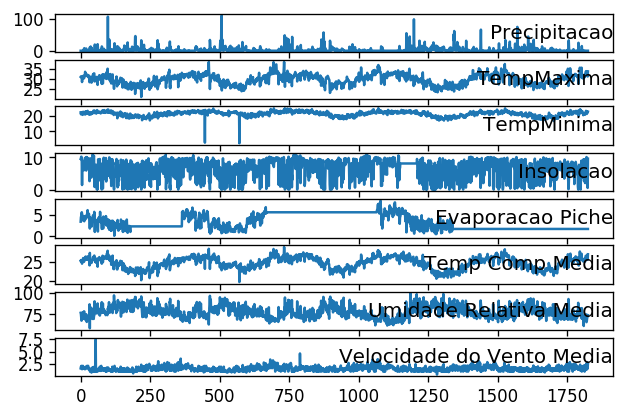

../data_in/SE_PROPRIA.csv


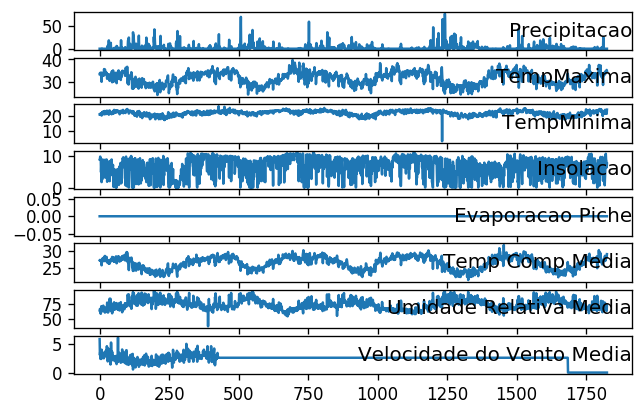

../data_in/SP+SAOPAULO.csv


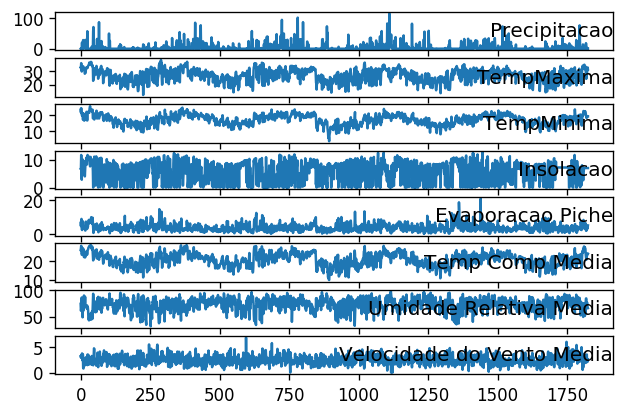

../data_in/SP_AVARE.csv


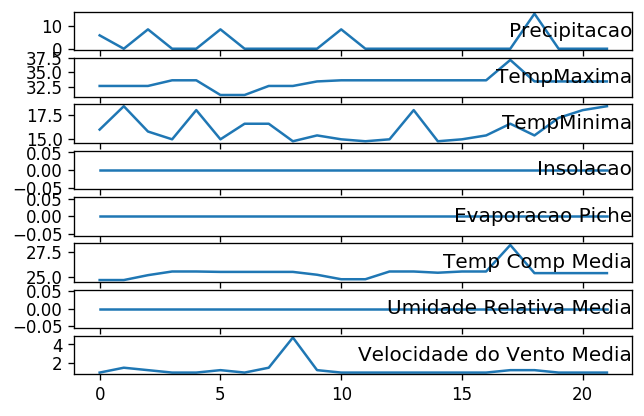

../data_in/SP_CAMPOSDOJORDAO.csv


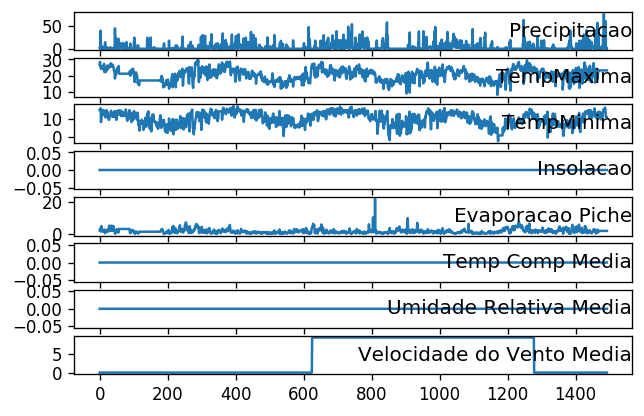

../data_in/SP_CANTANDUVA.csv


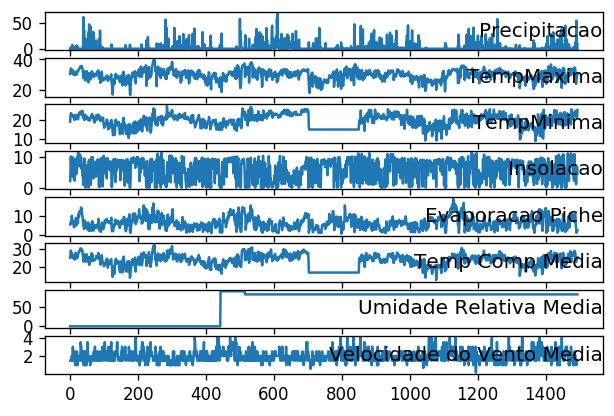

../data_in/SP_FRANCA.csv


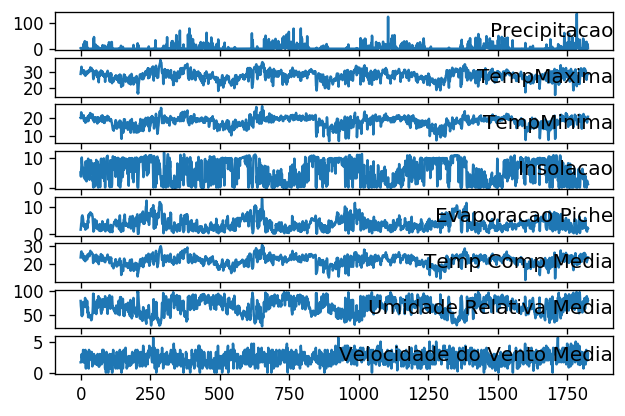

../data_in/SP_GUARULHOS.csv


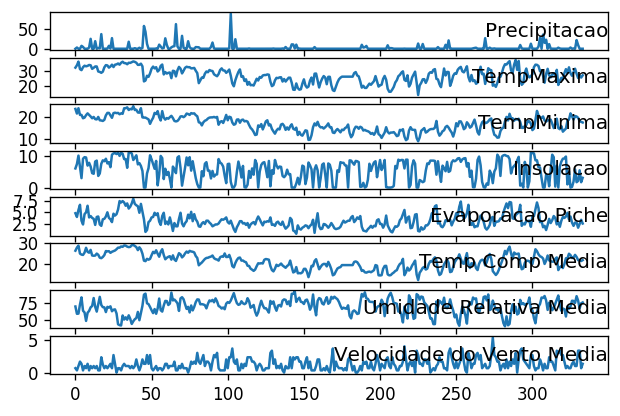

../data_in/SP_SAOCARLOS.csv


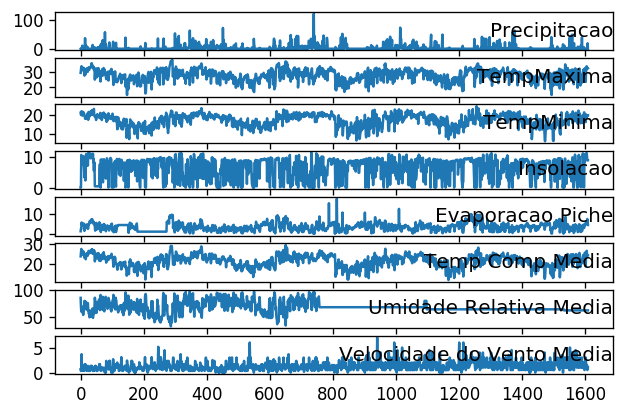

../data_in/SP_SAOSIMAO.csv


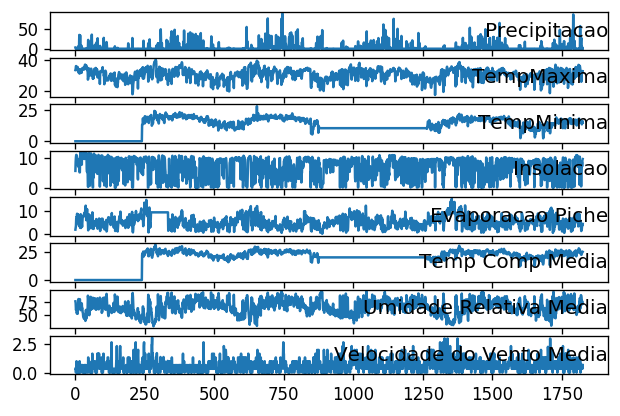

../data_in/SP_SOROCABA.csv


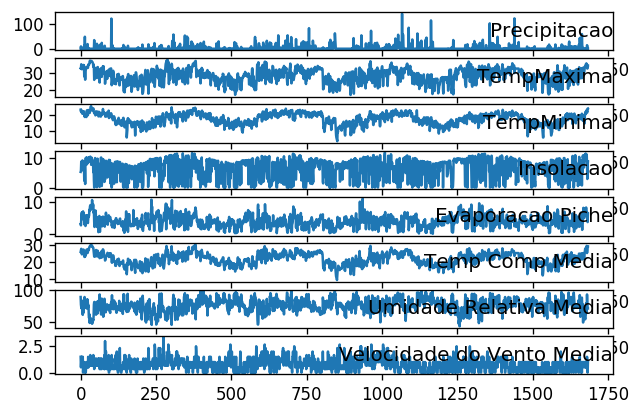

../data_in/SP_TAUBATE.csv


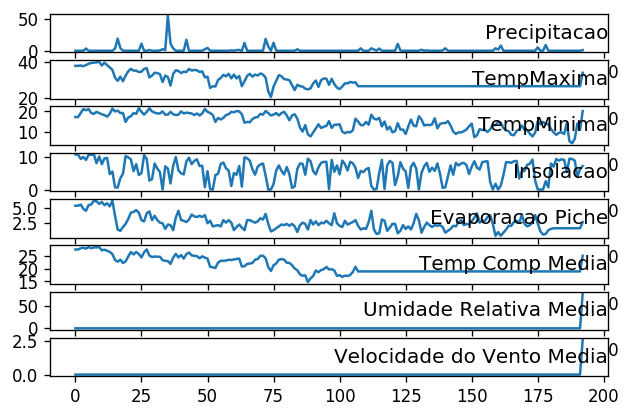

../data_in/SP_VOTUPORANGA.csv


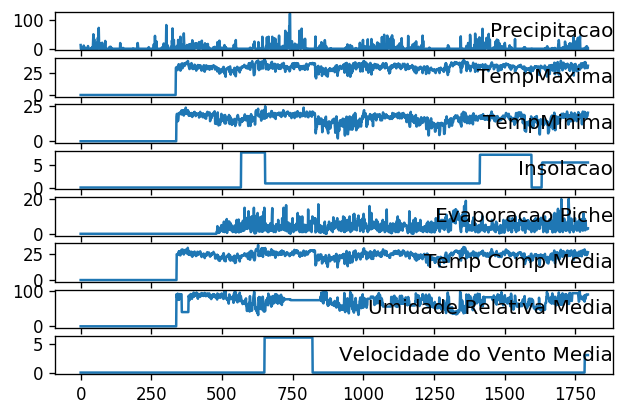

../data_in/TO_ARAGUAINA.csv


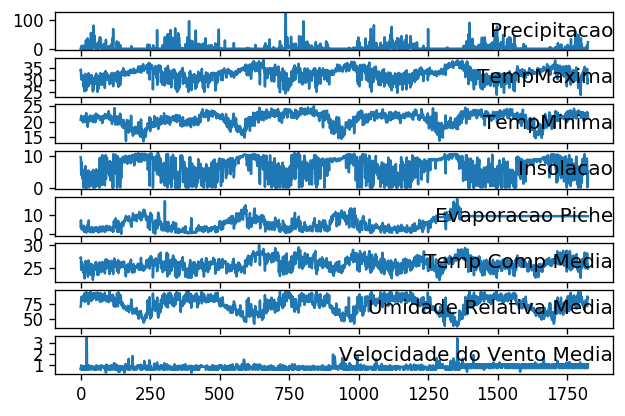

../data_in/TO_PALMAS.csv


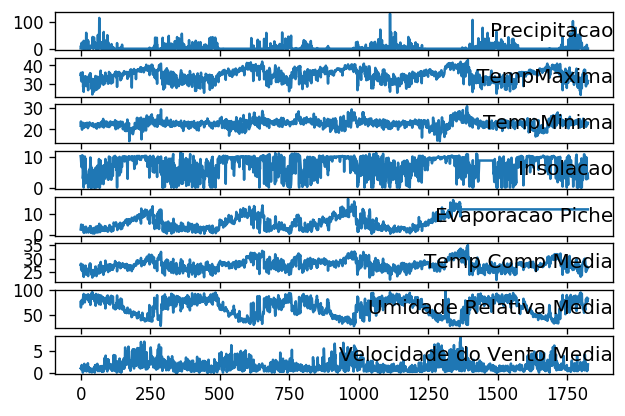

../data_in/TO_PEDROAFONSO.csv


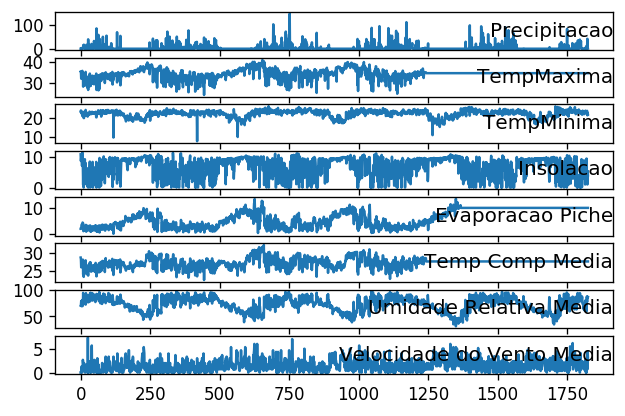

../data_in/TO_PEIXE.csv


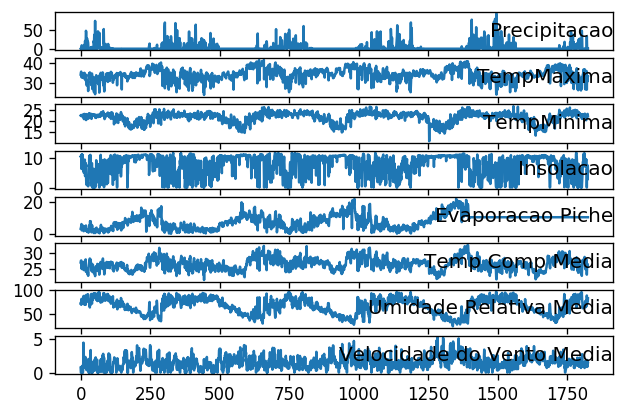

../data_in/TO_PORTONACIONAL.csv


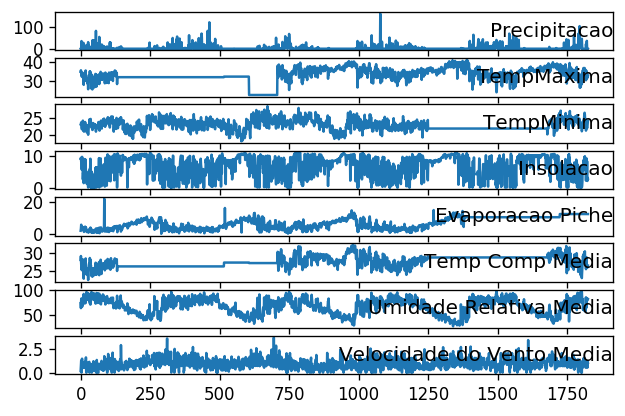

../data_in/TO_TAGUATINGA.csv


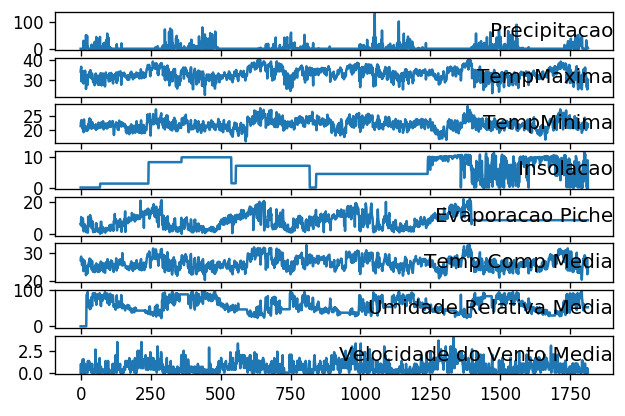

In [72]:
def getFileNameIn(path):
    files_names = []
    for dirname, dirnames, filenames in os.walk(path):
        # print path to all subdirectories first.
        for subdirname in dirnames:
            files_names.append(os.path.join(dirname, subdirname))

        # print path to all filenames.
        for filename in filenames:
            files_names.append(os.path.join(dirname, filename))
        
        return files_names

input_paths = getFileNameIn('../data_in/')
input_paths = sorted(input_paths)

for path in input_paths:
    output_path = format_dataset(path)
    dataset = load_dataset(output_path)
    values = dataset.values
    print(path)
    plot_columns(dataset, values)

In [193]:
def printGraph(pred, real):
    x_pred = []
    x_real = []
    y_pred = []
    y_real = []
    mean_pred = []
    
    for i in range(1,31):
        x_real.append(i)
        for j in range(0,10):
            x_pred.append(i)
            
    y = []
    i = 0
    while(i < 30):
        y_real.append(real[i])
        for j in range(i,len(pred),30):
            y_pred.append(pred[j])
        i += 1
    
    for i in range(0,300,10):
        mean_pred.append(np.mean(y_pred[i:i+10]))
    
    g1 = (x_pred, y_pred)
    g2 = (x_real, y_real)
    
    data = (g1,g2)
    colors = ('blue', 'red')
    groups = ('Predição', 'Real')
    
    fig = plt.figure(dpi=110)
    
    ax = fig.add_subplot(1, 1, 1)

    for data, color, group in zip(data, colors, groups):
        x, y = data
        ax.scatter(x, y, alpha=0.8, c=color, edgecolors='none', s=30, label=group)
    
    plt.plot(x, mean_pred, color='blue', label='Media')
    plt.title('TemperaturaXPredição')
    plt.xlabel('Dias')
    plt.ylabel('Temperatura')
    plt.legend(loc=2)
    plt.show()

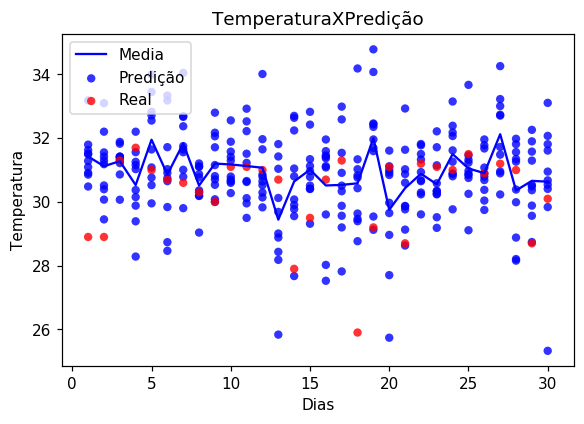

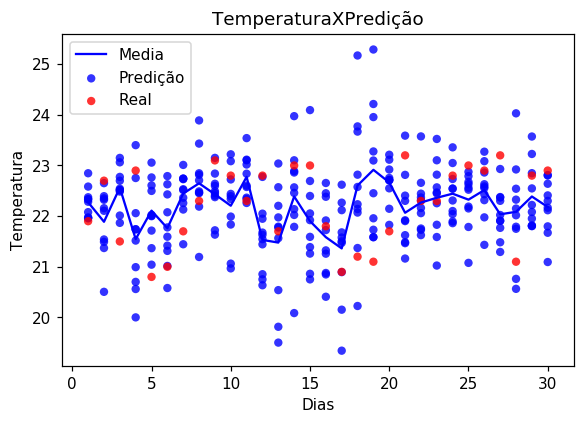

In [194]:
from matplotlib import pyplot as plt

max_temp_preds = [31.51431303, 31.42376401, 31.82680049, 32.2033567, 33.45113557, 30.74376848, 31.64666051, 29.03769774, 32.06026221, 32.55893146, 32.92602972, 30.52372938, 25.83476806, 27.67240997, 31.12742773, 29.60493207, 32.58926122, 30.76251314, 31.59346427, 30.99898561, 29.1306118, 30.23669879, 30.33229076, 33.15163139, 29.11006625, 31.07721887, 34.26166351, 31.3452408, 31.90088369, 30.67685205, 30.85623547, 33.09941353, 31.36812953, 31.1558044, 32.55370717, 33.18336885, 30.78907438, 30.19994513, 30.7049517, 31.57900586, 29.49832972, 31.6504124, 29.00783463, 32.63927825, 29.31530089, 31.9595398, 27.81826419, 31.33685926, 31.96016846, 25.73811023, 29.76551631, 30.93602321, 30.58509576, 30.80465326, 31.45919645, 31.96049065, 30.89755691, 28.8805206, 30.53437361, 31.61221305, 31.62755743, 31.18441332, 30.86151452, 31.56215487, 34.0005124, 28.73634353, 29.80288183, 30.77327587, 31.15659406, 30.70273697, 32.52805353, 30.64507261, 30.12373272, 31.04702426, 30.51185658, 28.02262934, 32.99087317, 34.18813668, 29.54128283, 30.9218336, 30.6011096, 31.50325278, 31.71620284, 31.26137694, 30.75189031, 29.74735271, 32.70892574, 29.99011786, 32.26153698, 29.83885895, 31.09453052, 29.45174133, 31.40809049, 31.25703141, 30.5261646, 30.65213531, 32.69244622, 30.87256156, 30.08241328, 30.27749998, 31.22461613, 30.79209101, 29.68691159, 29.77454711, 30.96665435, 31.42200925, 29.87762391, 29.46702075, 32.4348647, 29.97310654, 32.93204008, 31.81707357, 29.18599867, 30.88767958, 30.25341525, 30.68532692, 30.23420401, 31.98103103, 30.48430339, 32.07211913, 30.91382809, 30.39847932, 31.21954578, 30.37208736, 32.71771114, 33.33857735, 32.37458288, 30.18661048, 30.80896818, 30.79615405, 31.51263863, 34.01432572, 31.81446039, 29.9039683, 30.40471576, 31.36966528, 30.51054934, 31.02630964, 34.07802926, 31.11841344, 30.87449177, 31.33007543, 31.14920419, 32.3905248, 33.67362326, 30.79422101, 33.00833379, 28.20665407, 28.74037075, 33.10839016, 30.48341765, 31.30065933, 31.31253657, 29.39146104, 31.08181553, 31.02744737, 31.55856061, 30.30323769, 31.71448685, 31.41485978, 32.22195729, 31.9687037, 28.881461, 32.24323919, 30.41722232, 31.08146369, 31.54009094, 30.8297623, 31.69413586, 30.84583945, 31.63715037, 30.29469341, 30.34852024, 31.61795176, 31.23181586, 31.67684357, 33.2272682, 31.26320762, 31.57867186, 25.32573957, 31.79727649, 30.07126229, 30.06801777, 30.15246322, 29.95417092, 30.90795459, 31.75281381, 31.20636662, 32.80071862, 30.64227362, 30.65624839, 30.14106436, 28.18153394, 30.07605562, 30.78563365, 31.12244926, 29.56556936, 30.4298013, 29.12513114, 27.70183368, 31.02374416, 29.60834716, 30.25828139, 30.87666529, 30.97307225, 30.04242166, 32.73613336, 31.56466256, 31.29647791, 30.40867688, 31.28618455, 31.5539034, 31.42185465, 28.28455996, 31.64622463, 28.46510276, 34.04910433, 31.11391872, 32.17200714, 31.88889213, 30.62497218, 30.29291769, 31.42658574, 29.55416671, 31.34163192, 27.52447828, 29.19912868, 29.63557931, 32.46236969, 28.96397431, 29.87322923, 31.77670989, 30.23657219, 29.76736481, 31.32055734, 31.77630353, 31.72399612, 30.38820275, 29.88443433, 31.81155014, 31.49609314, 32.20469458, 31.88417983, 31.02886769, 30.76349761, 29.83852809, 31.00834795, 31.10359935, 29.99866028, 30.59833711, 29.95393476, 30.86122586, 31.04028596, 32.70023904, 32.8272906, 31.59407041, 30.33562265, 29.39456244, 32.35552306, 31.60978722, 29.86077, 30.67886859, 32.21529662, 32.06751461, 30.84889184, 30.89235553, 31.48376893, 28.15651188, 29.56415564, 30.95146842, 33.18644967, 30.51607918, 31.42141405, 29.88272606, 32.83081521, 31.71830114, 32.67044325, 30.36118387, 30.53639612, 31.29463765, 30.1180269, 29.82898605, 28.43293166, 30.8016506, 32.42637614, 31.45705285, 30.91156834, 28.7667384, 34.78829852, 29.64957714, 28.63081675, 30.64981863, 29.51922752, 32.17964794, 30.87389902, 30.3780268, 30.95651182, 31.81348245, 30.36721846, 30.54147928]
min_temp_preds = [22.37260472, 22.15672759, 22.51059458, 20.56112354, 21.0415985, 21.31394311, 22.36364592, 23.88980364, 22.37489512, 23.08472164, 23.10252343, 22.04885647, 22.57077216, 20.08616471, 22.05315968, 22.45163296, 22.11787035, 20.22593837, 24.2137223, 21.82751582, 21.48427319, 22.36846475, 23.52376527, 23.35801809, 22.18808597, 22.86109521, 21.48356023, 22.14923681, 21.80188514, 22.16661228, 22.84674636, 22.32299565, 23.06231434, 21.74119262, 22.00754708, 21.777277, 22.53129308, 22.48858702, 22.84014072, 23.22083426, 23.1148528, 22.77440589, 19.81552059, 22.13809621, 20.75098372, 22.38214115, 22.26607982, 22.81809726, 21.58602845, 23.11418588, 21.46608108, 22.31029862, 22.25453924, 23.04876186, 22.15179787, 22.4318034, 21.90710391, 20.56463998, 21.95204676, 21.09400176, 22.58357172, 21.49161314, 23.14956407, 21.73975043, 22.49789066, 20.58048649, 21.44473018, 22.46219172, 22.45608406, 21.83420019, 22.8376115, 21.67528183, 23.03860394, 22.86108952, 21.26046623, 20.84912347, 22.62037326, 23.66915139, 25.2896867, 22.71314304, 21.62389466, 22.05892602, 22.44901638, 22.73339177, 22.63131224, 21.97565499, 22.36828646, 22.32561486, 23.57170419, 22.63917317, 22.33529902, 22.35062612, 21.86706261, 23.40148459, 22.60685581, 22.07639875, 23.01116692, 22.70699832, 22.49134244, 20.96842174, 22.60177962, 21.54559156, 20.53913312, 21.78873286, 22.69366855, 20.40818646, 21.67927737, 23.77166809, 22.45200758, 22.71176925, 22.30140814, 22.65795421, 21.58780016, 21.8943549, 22.5601196, 21.43281613, 22.30218037, 21.75045515, 23.22734899, 21.67168698, 21.9749155, 22.39387892, 22.54152849, 20.99273278, 21.71468945, 22.79054323, 22.72948208, 22.81563284, 22.59857802, 22.39350522, 23.01926875, 20.63540912, 21.56477875, 23.10255216, 21.38915156, 21.72517648, 20.15286708, 22.07024851, 23.95527251, 22.75369176, 23.58908621, 22.4438791, 22.56813667, 22.0403129, 21.0771518, 22.55480074, 21.90814161, 20.76129043, 22.54739453, 22.40923891, 22.33204456, 21.37038039, 22.7745646, 20.70182575, 21.36738315, 22.42893207, 22.74168855, 22.18792564, 23.15020318, 22.43893854, 23.54029423, 21.62983959, 21.77522979, 22.88812723, 21.92086004, 21.25854506, 19.3436581, 22.23443316, 23.27693679, 23.21189667, 21.16269274, 22.16101228, 22.46738896, 21.86116983, 21.78602183, 22.62961079, 21.29299724, 24.02981563, 22.08272674, 22.80200365, 22.28434793, 22.650899, 22.69905267, 22.75244586, 23.05653797, 21.59327772, 22.25849822, 22.45542976, 22.4052766, 21.06236603, 22.26006758, 20.85349966, 22.20352106, 22.56820409, 21.59088079, 22.65424305, 21.50366572, 21.37062039, 21.95745392, 22.54867459, 22.40484692, 21.62500045, 21.82938811, 22.1008619, 22.87365967, 22.58652385, 22.93054983, 22.54073711, 22.22078779, 22.11628302, 21.96464721, 22.1052354, 22.01189744, 22.0587281, 22.76394458, 21.01649856, 22.74069233, 23.43210524, 22.63864339, 21.99132143, 22.3646096, 21.94848464, 21.97480595, 23.97385471, 20.86163964, 20.87767309, 21.57734423, 22.14145052, 21.58357305, 22.92076691, 21.91833546, 21.72823791, 22.81838119, 22.54406558, 22.67502286, 23.27237043, 21.76822069, 22.01736809, 21.81611118, 22.81164715, 22.07905079, 21.53931948, 22.48562475, 21.51756612, 22.02498089, 22.6285911, 22.51500081, 21.19360982, 21.63477689, 22.33869861, 22.57533581, 21.44312487, 21.79222128, 22.4583323, 24.09358864, 21.91499711, 20.89448042, 25.17170111, 23.09827715, 22.70754659, 21.90209082, 21.75559238, 23.10278777, 22.30881478, 22.52166778, 22.31514536, 22.37689591, 21.79059111, 21.80718624, 21.7979604, 21.95808886, 20.50541529, 22.51925646, 20.00105326, 21.99896399, 21.41756234, 22.13024198, 22.84605274, 21.72006236, 22.72425508, 22.33795856, 20.75181866, 19.50292209, 22.02325722, 22.39807918, 21.32388852, 21.47293287, 22.57615084, 21.73112634, 22.14564409, 22.81476411, 23.57381329, 21.02446294, 22.54298785, 22.78893241, 23.08487094, 22.02235153, 22.92166233, 22.8484009, 22.3001026]
max_temp_real = [28.9, 28.9, 31.3, 31.7, 31, 30.7, 30.6, 30.3, 30, 31.1, 31.1, 31, 30.7, 27.9, 29.5, 30.7, 31.3, 25.9, 29.2, 31.1, 28.7, 31.2, 31.1, 31, 31.5, 30.9, 31.2, 31, 28.7, 30.1]
min_temp_real = [21.9, 22.7, 21.5, 22.9, 20.8, 21, 21.7, 22.3, 23.1, 22.8, 22.3, 22.8, 21.7, 23, 23, 21.8, 20.9, 21.2, 21.1, 21.7, 23.2, 22.3, 22.3, 22.8, 23, 22.9, 23.2, 21.1, 22.8, 22.9]
        
printGraph(max_temp_preds, max_temp_real)
printGraph(min_temp_preds, min_temp_real)

In [239]:
cities = ['AL_Maceio','AL_PalmeiraDosIndios','AP_Macapa','CE_CamposSales','DF_Roncador','MA_Turiacu','MG_BeloHorizonte','MG_Caratinga','PA_Belem','PA_MonteAlegre','PI_VALEDOGURGUEIA','PR-IRATI']

city = 'AL_Maceio'
file_path = '../results/'+city+'_std_normalization_predictions_results.csv'
file = open(file_path, 'w')
file.writelines('TempMaximaPred,TempMaximaReal,TempMinimaPred,TempMinimaReal,ErroTempMaxima,ErroTempMinima\n')
file.close()
file_path = '../results/'+city+'_std_normalization_metrics_results.csv'
file = open(file_path, 'w')
file.writelines('MEAN-SQUARED-ERROR-MAX,STANDART-DEVIATION-MAX,MEAN-ABSOLUTE-ERROR-MAX,MEDIAN-ABSOLUTE-ERROR-MAX,MEAN-SQUARED-ERROR-MIN,STANDART-DEVIATION-MIN,MEAN-ABSOLUTE-ERROR-MIN,MEDIAN-ABSOLUTE-ERROR-MIN\n')
file.close()
file_path = '../results/'+city+'_std_normalization_accuracy_results.csv'
file = open(file_path, 'w')
file.writelines('Acuracia,Conjunto\n')
file.close()

file_path = '../results/'+city+'_minmax_normalization_predictions_results.csv'
file = open(file_path, 'w')
file.writelines('TempMaximaPred,TempMaximaReal,TempMinimaPred,TempMinimaReal,ErroTempMaxima,ErroTempMinima\n')
file.close()
file_path = '../results/'+city+'_minmax_normalization_metrics_results.csv'
file = open(file_path, 'w')
file.writelines('MEAN-SQUARED-ERROR-MAX,STANDART-DEVIATION-MAX,MEAN-ABSOLUTE-ERROR-MAX,MEDIAN-ABSOLUTE-ERROR-MAX,MEAN-SQUARED-ERROR-MIN,STANDART-DEVIATION-MIN,MEAN-ABSOLUTE-ERROR-MIN,MEDIAN-ABSOLUTE-ERROR-MIN\n')
file.close()
file_path = '../results/'+city+'_minmax_normalization_accuracy_results.csv'
file = open(file_path, 'w')
file.writelines('Acuracia,Conjunto\n')
file.close()

In [139]:
def histogram(x,y,errorType):
    plt.bar(x, y)
    if errorType == 'ErroTempMaxima':
        plt.title('Temperatura Máxima')
    else:
        plt.title('Temperatura Mínima')
    plt.xlabel('Erro')
    plt.ylabel('Quantidade')
    plt.show()

In [126]:
def printHistogram(dataset, errorType):
    errors = dataset[errorType].tolist()
    x = []
    j = 1
    y = []
    count = 0

    while(j<len(errors)):
        for error in errors:
            if error > j-1 and error <= j:
                count += 1
        if count != 0:
            y.append(count)
        j += 1
        count = 0
        
    for i in range(1, len(y)+1):
        x.append(i)

    histogram(x,y,errorType)

---------------------------------------------------------------
AL_Maceio


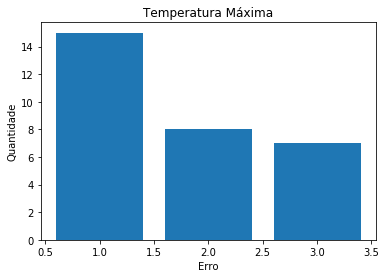

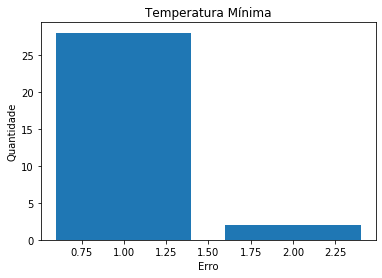

---------------------------------------------------------------
AL_PalmeiraDosIndios


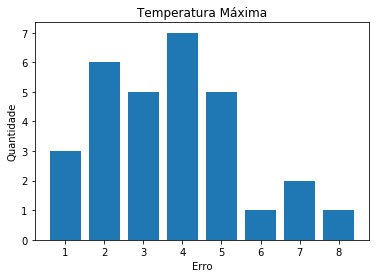

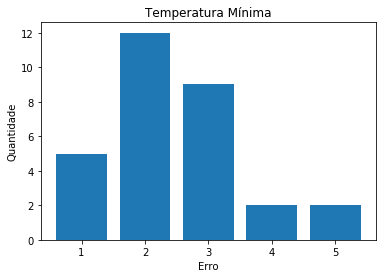

---------------------------------------------------------------
AP_Macapa


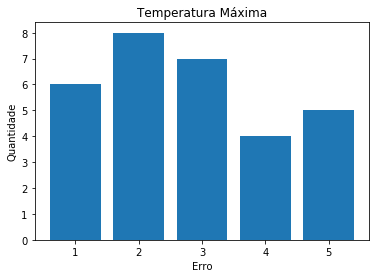

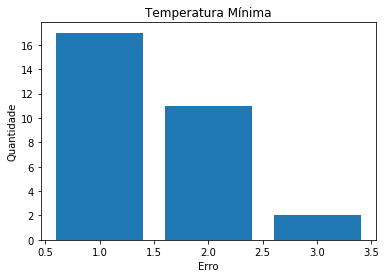

---------------------------------------------------------------
CE_CamposSales


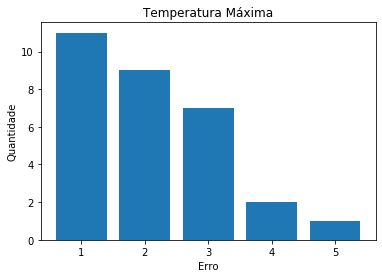

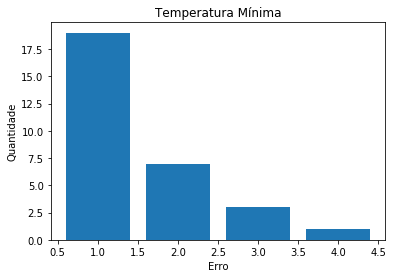

---------------------------------------------------------------
DF_Roncador


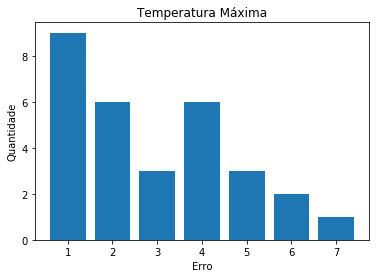

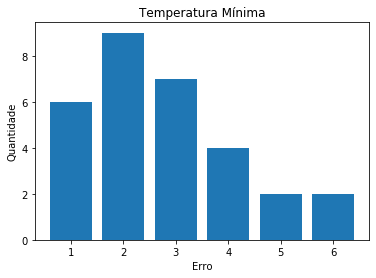

---------------------------------------------------------------
MA_Turiacu


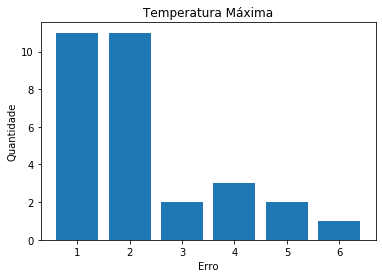

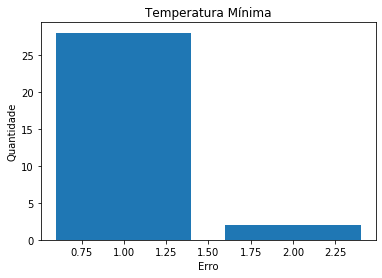

---------------------------------------------------------------
MG_BeloHorizonte


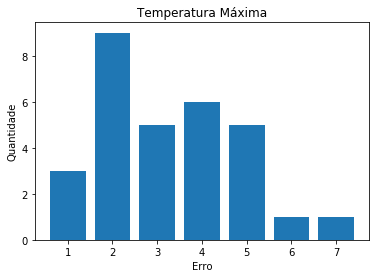

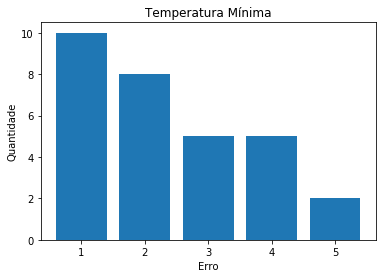

---------------------------------------------------------------
MG_Caratinga


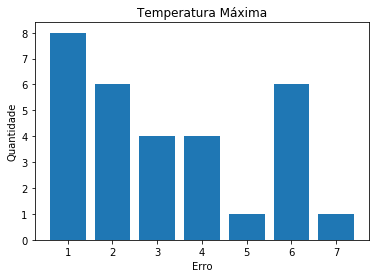

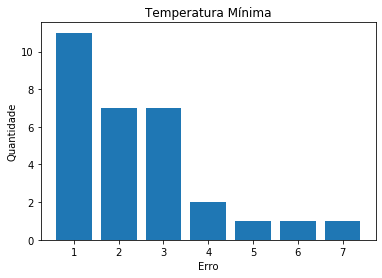

---------------------------------------------------------------
PA_Belem


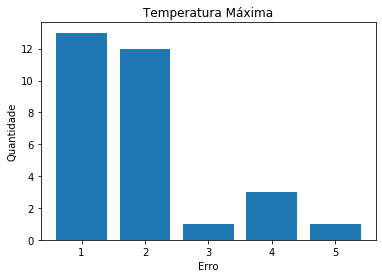

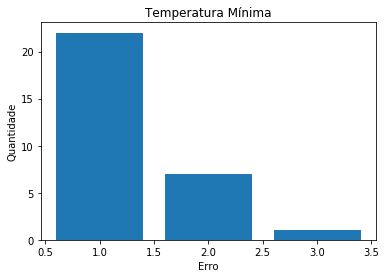

---------------------------------------------------------------
PA_MonteAlegre


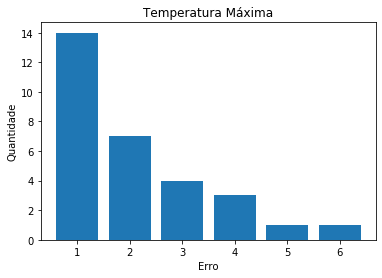

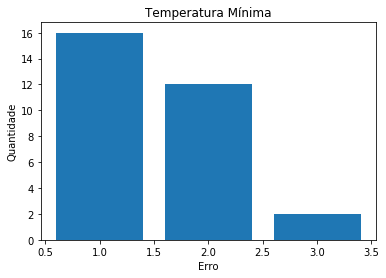

---------------------------------------------------------------
PI_VALEDOGURGUEIA


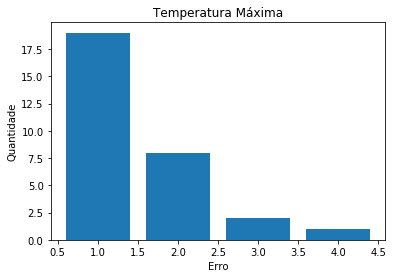

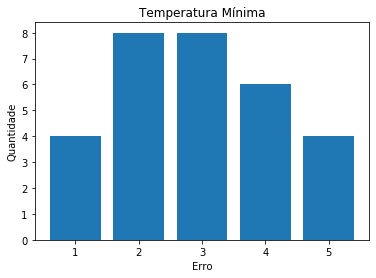

In [157]:
cities = ['AL_Maceio','AL_PalmeiraDosIndios','AP_Macapa','CE_CamposSales','DF_Roncador','MA_Turiacu','MG_BeloHorizonte','MG_Caratinga','PA_Belem','PA_MonteAlegre','PI_VALEDOGURGUEIA']
dataset = DataFrame()

for city in cities:
    file_path = '../results/'+city+'_predictions_results.csv'
    dataset = read_csv(file_path, header=0)
    print('---------------------------------------------------------------')
    print(city)
    printHistogram(dataset, 'ErroTempMaxima')
    printHistogram(dataset, 'ErroTempMinima')
    

In [301]:
cities = ['AL_PalmeiraDosIndios','AP_Macapa','CE_CamposSales','DF_Roncador','MA_Turiacu','MG_BeloHorizonte','MG_Caratinga','PA_Belem','PA_MonteAlegre','PI_VALEDOGURGUEIA']
dataset = DataFrame()

file_path = '../results/AL_Maceio_metrics_results.csv'
dataset = read_csv(file_path, header=0)

metrics_max = dataset.loc[:,:'MEDIAN-ABSOLUTE-ERROR-MAX']
metrics_min = dataset.loc[:,'MEAN-SQUARED-ERROR-MIN':]

for city in cities:
    file_path = '../results/'+city+'_metrics_results.csv'
    dataset = read_csv(file_path, header=0)
    
    metrics_max = concat([metrics_max, dataset.loc[:,:'MEDIAN-ABSOLUTE-ERROR-MAX']])
    metrics_min = concat([metrics_min, dataset.loc[:,'MEAN-SQUARED-ERROR-MIN':]])

cities = ['AL_Maceio'] + cities

metrics_max.index = range(0,11)
metrics_min.index = range(0,11)

metrics_max.insert(0, 'Cities', cities, True)
metrics_min.insert(0, 'Cities', cities, True)

metrics_max.set_index('Cities',inplace=True)
metrics_min.set_index('Cities',inplace=True)

file_name_max = '../results/all_cities_metrics_max_results.csv'
file_name_min = '../results/all_cities_metrics_min_results.csv'

metrics_max.to_csv(file_name_max)
metrics_min.to_csv(file_name_min)

In [302]:
file_name_max = '../results/all_cities_metrics_max_results.csv'
read_csv(file_name_max)

,Cities,MEAN-SQUARED-ERROR-MAX,STANDART-DEVIATION-MAX,MEAN-ABSOLUTE-ERROR-MAX,MEDIAN-ABSOLUTE-ERROR-MAX
0,AL_Maceio,1.976289,0.874597,1.100622,1.049424
1,AL_PalmeiraDosIndios,13.412839,1.712061,3.237543,3.242800
2,AP_Macapa,6.913521,1.387310,2.233583,2.213697
3,CE_CamposSales,5.090796,1.445798,1.732185,1.677120
4,DF_Roncador,9.012003,1.662799,2.499420,2.197972
5,MA_Turiacu,4.224641,1.269762,1.616275,1.337972
6,MG_BeloHorizonte,10.103936,1.551648,2.774225,2.768184
7,MG_Caratinga,12.158044,2.150817,2.744454,2.778376
8,PA_Belem,3.156343,1.013670,1.459047,1.188167
9,PA_MonteAlegre,4.456634,1.333389,1.636675,1.237444


In [297]:
file_name_min = '../results/all_cities_metrics_min_results.csv'
read_csv(file_name_min, header=0)

,Cities,MEAN-SQUARED-ERROR-MIN,STANDART-DEVIATION-MIN,MEAN-ABSOLUTE-ERROR-MIN,MEDIAN-ABSOLUTE-ERROR-MIN
0,AL_Maceio,0.390347,0.356606,0.513010,0.423915
1,AL_PalmeiraDosIndios,4.696082,1.021907,1.910965,1.799393
2,AP_Macapa,1.166474,0.584745,0.908045,0.838903
3,CE_CamposSales,1.521853,0.856529,0.887813,0.625192
4,DF_Roncador,7.394257,1.513716,2.258965,2.037487
5,MA_Turiacu,0.266689,0.335526,0.392570,0.327241
6,MG_BeloHorizonte,4.850181,1.296930,1.779931,1.381517
7,MG_Caratinga,7.598137,1.841897,2.050744,1.427758
8,PA_Belem,0.805895,0.618248,0.650895,0.382396
9,PA_MonteAlegre,1.466053,0.702840,0.985936,0.966810


In [321]:
normalizations = ['','std_normalization_','minmax_normalization_']

file_path = '../results/AL_Maceio_mean_normalization_metrics_results.csv'
dataset = read_csv(file_path, header=0)

metrics_max = dataset.loc[:,:'MEDIAN-ABSOLUTE-ERROR-MAX']
metrics_min = dataset.loc[:,'MEAN-SQUARED-ERROR-MIN':]

for normalization in normalizations:
    file_path = '../results/AL_Maceio_'+normalization+'metrics_results.csv'
    dataset = read_csv(file_path, header=0)

    metrics_max = concat([metrics_max, dataset.loc[:,:'MEDIAN-ABSOLUTE-ERROR-MAX']])
    metrics_min = concat([metrics_min, dataset.loc[:,'MEAN-SQUARED-ERROR-MIN':]])
    
normalizations = ['Mean','Log','Std','MinMax']

metrics_max.index = range(0,4)
metrics_min.index = range(0,4)

metrics_max.insert(0, 'Normalization-Technique', normalizations, True)
metrics_min.insert(0, 'Normalization-Technique', normalizations, True)

metrics_max.set_index('Normalization-Technique',inplace=True)
metrics_min.set_index('Normalization-Technique',inplace=True)

file_name_max = '../results/differents_normalizations_metrics_max_results.csv'
file_name_min = '../results/differents_normalizations_metrics_min_results.csv'

metrics_max.to_csv(file_name_max)
metrics_min.to_csv(file_name_min)

In [322]:
file_name_max = '../results/differents_normalizations_metrics_max_results.csv'
read_csv(file_name_min, header=0)

,Normalization-Technique,MEAN-SQUARED-ERROR-MIN,STANDART-DEVIATION-MIN,MEAN-ABSOLUTE-ERROR-MIN,MEDIAN-ABSOLUTE-ERROR-MIN
0,Mean,0.444803,0.399518,0.534030,0.476361
1,Log,0.390347,0.356606,0.513010,0.423915
2,Std,0.341917,0.357677,0.462584,0.382657
3,MinMax,0.389962,0.352949,0.515159,0.419563


In [323]:
file_name_min = '../results/differents_normalizations_metrics_min_results.csv'
read_csv(file_name_min, header=0)

,Normalization-Technique,MEAN-SQUARED-ERROR-MIN,STANDART-DEVIATION-MIN,MEAN-ABSOLUTE-ERROR-MIN,MEDIAN-ABSOLUTE-ERROR-MIN
0,Mean,0.444803,0.399518,0.534030,0.476361
1,Log,0.390347,0.356606,0.513010,0.423915
2,Std,0.341917,0.357677,0.462584,0.382657
3,MinMax,0.389962,0.352949,0.515159,0.419563
